### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
        2. Visualizing Data Distribution: Exploring 'avg_price_per_room' in the Hotel Reservation Dataset: 
    </h3>

The goal of the code below is to visualize the distribution of a specific column ('avg_price_per_room') from the Hotel Reservation dataset using DataPrep's plot function. The visualization provides a clear representation of the data's distribution in that particular column, aiding in understanding its characteristics and potential insights.

In [22]:
# Plotting the distribution of a specific column
column_name = 'avg_price_per_room'
report_1 = plot(df_hotel_reservation, column_name)

# Save the report as an HTML file
report_1.save("hotel_reservation_eda_report_1.html")

# Show the report
# report_1.show()

  0%|                                                                                                         …

In [ ]:
from IPython.display import display, HTML

with open("visualizations_html/hotel_reservation_eda_report_1.html", "r") as f:
    html_content = f.read()

display(HTML(html_content))

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
       3. Visualizing Missing Values: Gaining Insights into Dataset Completeness and Imputation Guidance
    </h3>

Let's create a report that visualizes and helps us understand the missing values in the dataset. By plotting this report, we will be able to identify the columns with missing data, giving us insights into the completeness of the dataset and guiding us in any necessary data handling or imputation processes.

In [23]:
# Using DataPrep's plot_missing function to visualize missing values in the DataFrame
report_2 = plot_missing(df_hotel_reservation)

# Save the report as an HTML file
report_2.save("hotel_reservation_eda_report_2.html")

# Show the report
# report_2.show()

  0%|                                                                                                         …

In [ ]:
from IPython.display import display, HTML

with open("visualizations_html/hotel_reservation_eda_report_2.html", "r") as f:
    html_content = f.read()

display(HTML(html_content))

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
      4. Exploring Variable Correlations: Unraveling Relationships and Dependencies with Diverse Techniques
    </h3>

Let's generate a report that explores the correlations between the variables in the dataset using various techniques. By creating this report, we aim to gain insights into the relationships and dependencies among the different features. We will employ different correlation techniques to measure the strength and direction of associations, helping us understand how variables are related and potentially identifying important patterns in the data.

In [24]:
# Display the correlation between the columns in the DataFrame
report_3 = plot_correlation(df_hotel_reservation)

# Save the report as an HTML file
report_3.save("hotel_reservation_eda_report_3.html")

# Show the report
# report_3.show()


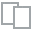
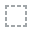
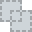
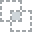
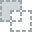
...
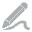
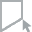
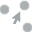
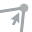
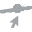

In [72]:
from IPython.display import display, HTML

with open("visualizations_html/hotel_reservation_eda_report_3.html", "r") as f:
    html_content = f.read()

display(HTML(html_content))

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
      5. Correlating Predictor Variables with Booking Status: Unveiling Influential Factors for Reservation Predictions
    </h3>

Let's focus on understanding how the other columns are correlated to the target column "booking_status." By conducting this analysis, we aim to explore the relationships between the predictor variables and the target variable. Identifying correlations between these features and the booking status will help us determine which factors are most influential in predicting reservation cancellations or non-cancellations. This valuable insight will contribute to building an effective model for predicting hotel reservation outcomes.

In [83]:
# check the classes in the target variable
df_hotel_reservation["booking_status"].value_counts()

Not_Canceled    24390
Canceled        11885
Name: booking_status, dtype: int64

In [84]:
# Map 'Not_Canceled' to 0 and 'Canceled' to 1
df_hotel_reservation['booking_status_encoded'] = df_hotel_reservation['booking_status'].map({'Not_Canceled': 0, 'Canceled': 1})

In [85]:
# check the values again for the encoded target
df_hotel_reservation["booking_status_encoded"].value_counts()

0    24390
1    11885
Name: booking_status_encoded, dtype: int64

In [86]:
# Display the correlation between the target column and the other columns in the DataFrame
report_4 = plot_correlation(df_hotel_reservation, "booking_status_encoded")


# Save the report as an HTML file
report_4.save("hotel_reservation_eda_report_4.html")

# Show the report
# report_4.show()

  0%|                                                                                                         …


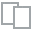
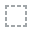
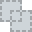
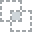
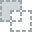
...
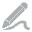
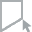
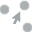
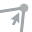
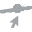

In [73]:
from IPython.display import display, HTML

with open("visualizations_html/hotel_reservation_eda_report_4.html", "r") as f:
    html_content = f.read()

display(HTML(html_content))

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
  6. Visualizing Correlations with Booking Status
</h3>

This code generates a horizontal bar plot to visualize the correlations between each column and the target column "booking_status" in the dataset. By calculating and sorting the correlations, the plot provides insights into how other variables relate to the booking status. The visualization helps identify the most influential factors influencing reservation cancellations or non-cancellations, contributing to the development of an effective prediction model for hotel reservation outcomes. The color-coded bars make it easy to interpret the strength and direction of associations, making it a valuable tool for data exploration and analysis.

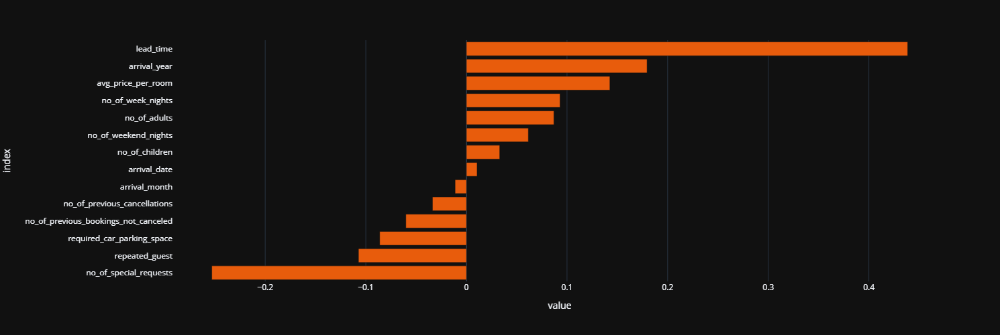

In [87]:
# Calculate the correlation of each column with the target column 'booking_status'
df_corr_bar = df_hotel_reservation.corr().booking_status_encoded.sort_values()[:-1]

# Create a bar plot to visualize the correlations
# Orientation is set to "horizontal" for easier readability
# Color_discrete_sequence sets the color of the bars
fig = px.bar(df_corr_bar, orientation="h", color_discrete_sequence=["#e85c0c"],template='plotly_dark') 

# Hide the legend since we are only plotting one variable
fig.update_layout(showlegend=False, height = 500)

# Display the plot
fig.show()

###
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
      7. Exploring Statistical Insights of the Dataset grouped by the encoded booking status
    </h3>

In this code, we aim to gain a deeper understanding of the dataset by exploring its statistical properties. We begin by setting the display option to show all columns, ensuring comprehensive visibility of the data. Next, we compute descriptive statistics for each variable in the dataset, grouped by the encoded booking status ('booking_status_encoded'). The computed statistics include the minimum, standard deviation, mean, and maximum values for each variable.

In [88]:
# Set display option to show all columns
pd.set_option('display.max_columns', None)

# Filter only the numeric columns
numeric_columns = df_hotel_reservation.select_dtypes(include='number')

# Compute statistics for the numeric columns grouped by 'booking_status_encoded'
df_stats = numeric_columns.groupby(df_hotel_reservation['booking_status_encoded']).agg(['min', 'std', 'mean', 'max'])

# Display the statistics 
df_stats.style.background_gradient(cmap='coolwarm')

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
8. Univariate Analysis
</h3>

Univariate analysis is a statistical method used to explore and summarize the characteristics of a single variable. It focuses on understanding the distribution, central tendency, and variability of the variable. By examining a variable in isolation, we can gain insights into its individual properties and behaviors.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set the seaborn style
sns.set(style='whitegrid')

# Colors for mean, mode, and median
mean_color = 'black'
mode_color = 'magenta'
median_color = 'limegreen'

# Perform univariate analysis on df_hotel_reservation
plt.figure(figsize=(24, 16))
for i, column in enumerate(df_hotel_reservation.columns):
    plt.subplot(4, 4, i+1)
    sns.histplot(df_hotel_reservation[column], kde=True, color='blue', edgecolor='black', alpha=0.7)
    plt.axvline(df_hotel_reservation[column].mean(), color=mean_color, linestyle='dashed', linewidth=2, label='Mean')
    plt.axvline(df_hotel_reservation[column].mode()[0], color=mode_color, linestyle='dashed', linewidth=2, label='Mode')
    plt.axvline(df_hotel_reservation[column].median(), color=median_color, linestyle='dashed', linewidth=2, label='Median')
    plt.xlabel(column, fontsize=12)
    plt.ylabel('Count', fontsize=12)
plt.suptitle("Univariate Analysis - Hotel Reservation", fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

# Add legend
plt.figure(figsize=(24, 4))
plt.plot([], [], color=mean_color, linestyle='dashed', linewidth=4, label='Mean')
plt.plot([], [], color=mode_color, linestyle='dashed', linewidth=4, label='Mode')
plt.plot([], [], color=median_color, linestyle='dashed', linewidth=4, label='Median')
plt.legend(loc='center', ncol=6, fontsize=24)
plt.axis('off')
plt.show()

**the benefit of this visualization** is that it provides a comprehensive and detailed understanding of the individual distributions of each column in the 'df_hotel_reservation' dataset. By using histograms with overlaid mean, mode, and median vertical lines, we can quickly identify the central tendency and spread of each feature.

With this analysis, readers can easily observe **the shape and spread of data, potential skewness, and the presence of outliers in each column. The mean, mode, and median lines offer valuable insights into the typical values and the most frequently occurring values in the dataset.** This visualization aids in identifying potential data patterns, understanding the data's characteristics, and assessing the data's overall distribution.

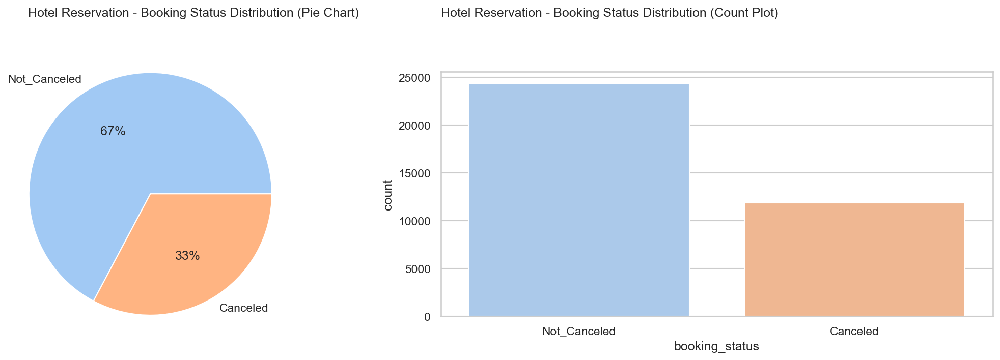

In [28]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the seaborn style
sns.set_style('whitegrid')

# Set the figure size and dpi
plt.figure(figsize=(15, 5), dpi=150)

# Pie chart for booking status distribution in df_hotel_reservation
plt.subplot(121)
booking_status_counts = df_hotel_reservation['booking_status'].value_counts()
colors = sns.color_palette('pastel')
plt.pie(booking_status_counts, labels=booking_status_counts.index, autopct='%2.f%%', radius=1.24, colors=colors)
plt.title('Hotel Reservation - Booking Status Distribution (Pie Chart)', loc='left', y=1.2)

# Count plot for booking status distribution in df_hotel_reservation
plt.subplot(122)
sns.countplot(data=df_hotel_reservation, x='booking_status', palette='pastel')
plt.title('Hotel Reservation - Booking Status Distribution (Count Plot)', loc='left', y=1.2)
plt.tight_layout()
plt.show()

###
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
9.  Skewness-Kurtosis and Normality Tests
</h3>

**Skewness:** Skewness is a measure of the asymmetry of a distribution. A value between -1 and 1 indicates a relatively symmetric distribution, while a value less than -1 or greater than 1 suggests a highly skewed distribution.

**Kurtosis:** Kurtosis measures the shape of a distribution's tails. A value between -2 and 2 indicates a normal (mesokurtic) distribution, while a value less than -2 or greater than 2 suggests a distribution with flatter or more peaked tails.

**p-value:** The p-value is used to determine whether our data follows a normal distribution. If the p-value is less than 0.05, we reject the null hypothesis and conclude that the data does not follow a normal distribution.

**Shapiro-Wilk Test:** The Shapiro-Wilk test is a statistical test used to assess normality. If the p-value is greater than 0.05, it is interpreted as "Yes," indicating that our data is likely normally distributed. Conversely, if the p-value is less than 0.05, it is interpreted as "No," suggesting that our data deviates from a normal distribution.

Hypotheses:
+ Null Hypothesis ($H_0$): Our data follows a normal distribution.
+ Alternative Hypothesis ($H_1$): Our data does not follow a normal distribution.

In [89]:
from tabulate import tabulate
from scipy.stats import skew, kurtosis, normaltest, shapiro

# Select only numeric columns from df_hotel_reservation
numeric_columns = df_hotel_reservation.select_dtypes(include=[int, float]).columns

# Compute analysis for df_hotel_reservation
skewness = df_hotel_reservation[numeric_columns].skew()
kurtosis_val = df_hotel_reservation[numeric_columns].kurtosis()

table_data = []
for col in numeric_columns:
    stat, p = normaltest(df_hotel_reservation[col])
    skewness_val = f'{skewness[col]:.4f}'
    skewness_desc = 'High skewness' if skewness[col] < -1 or skewness[col] > 1 else 'Symmetric or slightly skewed'
    kurtosis_val_str = f'{kurtosis_val[col]:.4f}'
    kurtosis_desc = 'Very flat or peaked' if kurtosis_val[col] < -2 or kurtosis_val[col] > 2 else 'Normal or slightly flat'

    stat_sh, p_sh = shapiro(df_hotel_reservation[col])
    shapiro_test = 'Yes' if p_sh >= 0.05 else 'No'
    
    table_data.append([col, shapiro_test, skewness_val, skewness_desc, kurtosis_val_str, kurtosis_desc])
    
# Create a DataFrame with the results
headers = ['Variable', 'Shapiro Test', 'Skewness C.', 'Skewness', 'Kurtosis C.', 'Kurtosis']
df_analysis = pd.DataFrame(table_data, columns=headers)

# Create custom style functions to apply different styles based on the test results
def highlight_shapiro_test(val):
    if val == 'No':
        return 'background-color: red; color: white;'
    return ''

def highlight_skewness(val):
    if val.startswith('High'):
        return 'background-color: #FFD700;'
    return ''

def highlight_kurtosis(val):
    if val.startswith('Very'):
        return 'background-color: #00FF00;'
    return ''

# Apply the custom style functions to the respective columns
df_analysis_style = df_analysis.style.applymap(highlight_shapiro_test, subset=['Shapiro Test']) \
                                 .applymap(highlight_skewness, subset=['Skewness']) \
                                 .applymap(highlight_kurtosis, subset=['Kurtosis'])

# Display the styled DataFrame
df_analysis_style

,Variable,Shapiro Test,Skewness C.,Skewness,Kurtosis C.,Kurtosis
0,no_of_adults,No,-0.3333,Symmetric or slightly skewed,0.8148,Normal or slightly flat
1,no_of_children,No,4.7103,High skewness,36.9819,Very flat or peaked
2,no_of_weekend_nights,No,0.7376,Symmetric or slightly skewed,0.2989,Normal or slightly flat
3,no_of_week_nights,No,1.5994,High skewness,7.7983,Very flat or peaked
4,required_car_parking_space,No,5.4136,High skewness,27.3090,Very flat or peaked
5,lead_time,No,1.2925,High skewness,1.1796,Normal or slightly flat
6,arrival_year,No,-1.6697,High skewness,0.7879,Normal or slightly flat
7,arrival_month,No,-0.3482,Symmetric or slightly skewed,-0.9332,Normal or slightly flat
8,arrival_date,No,0.0288,Symmetric or slightly skewed,-1.1572,Normal or slightly flat
9,repeated_guest,No,6.0029,High skewness,34.0365,Very flat or peaked


### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
10. Identify potential outliers in numerical columns
</h3>

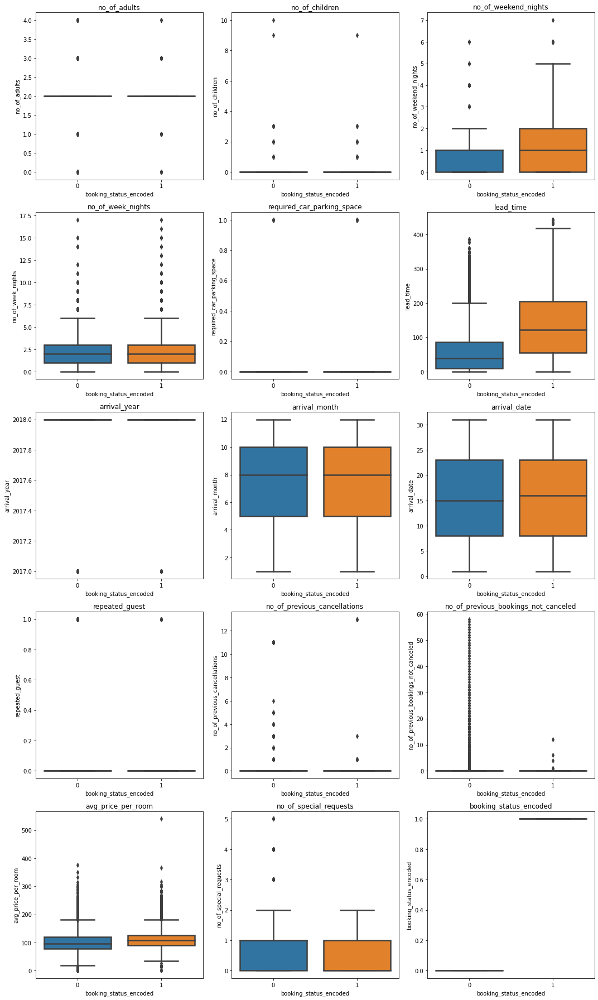

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select only numeric columns from df_hotel_reservation
numeric_columns = df_hotel_reservation.select_dtypes(include=[int, float]).columns

# Calculate the number of rows and columns needed for subplots
num_cols = 3
num_rows = (len(numeric_columns) - 1) // num_cols + 1

# Create boxplots for each numeric column
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

for index, column in enumerate(numeric_columns):
    row_idx = index // num_cols
    col_idx = index % num_cols
    ax = axes[row_idx, col_idx]
    
    sns.boxplot(y=df_hotel_reservation[column], x=df_hotel_reservation['booking_status_encoded'], linewidth=2.5, ax=ax)
    ax.set_title(column, size=12)

# Hide any unused subplots
for index in range(len(numeric_columns), num_rows*num_cols):
    row_idx = index // num_cols
    col_idx = index % num_cols
    fig.delaxes(axes[row_idx, col_idx])

fig.tight_layout()
plt.show()

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
11. Explore the relationship between numerical features and the target variable
</h3>

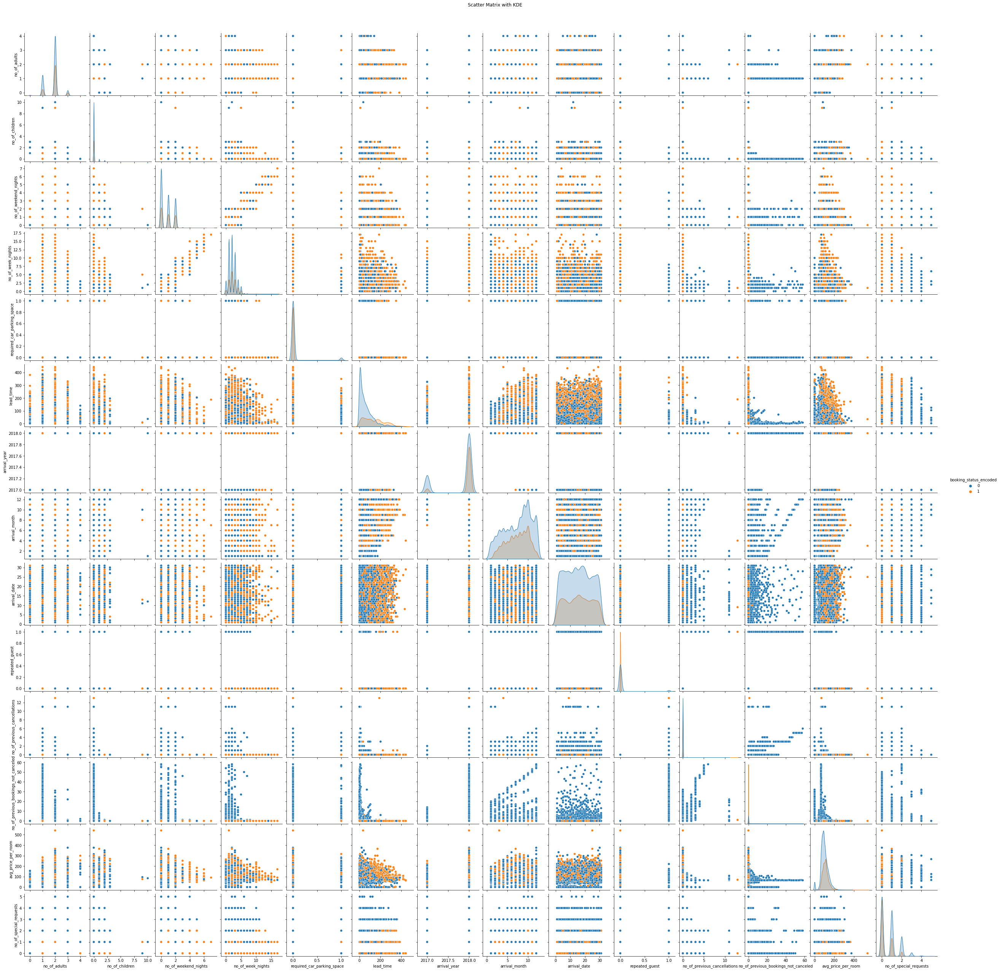

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select only numeric columns from df_hotel_reservation
numeric_columns = df_hotel_reservation.select_dtypes(include=[int, float]).columns

# Create the scatter matrix with KDE plots for numeric columns
scatter_matrix = sns.pairplot(df_hotel_reservation[numeric_columns], diag_kind="kde", markers="o", height=2.5, hue="booking_status_encoded")

# Customize the scatter matrix
scatter_matrix.fig.suptitle("Scatter Matrix with KDE", y=1.02)

plt.show()

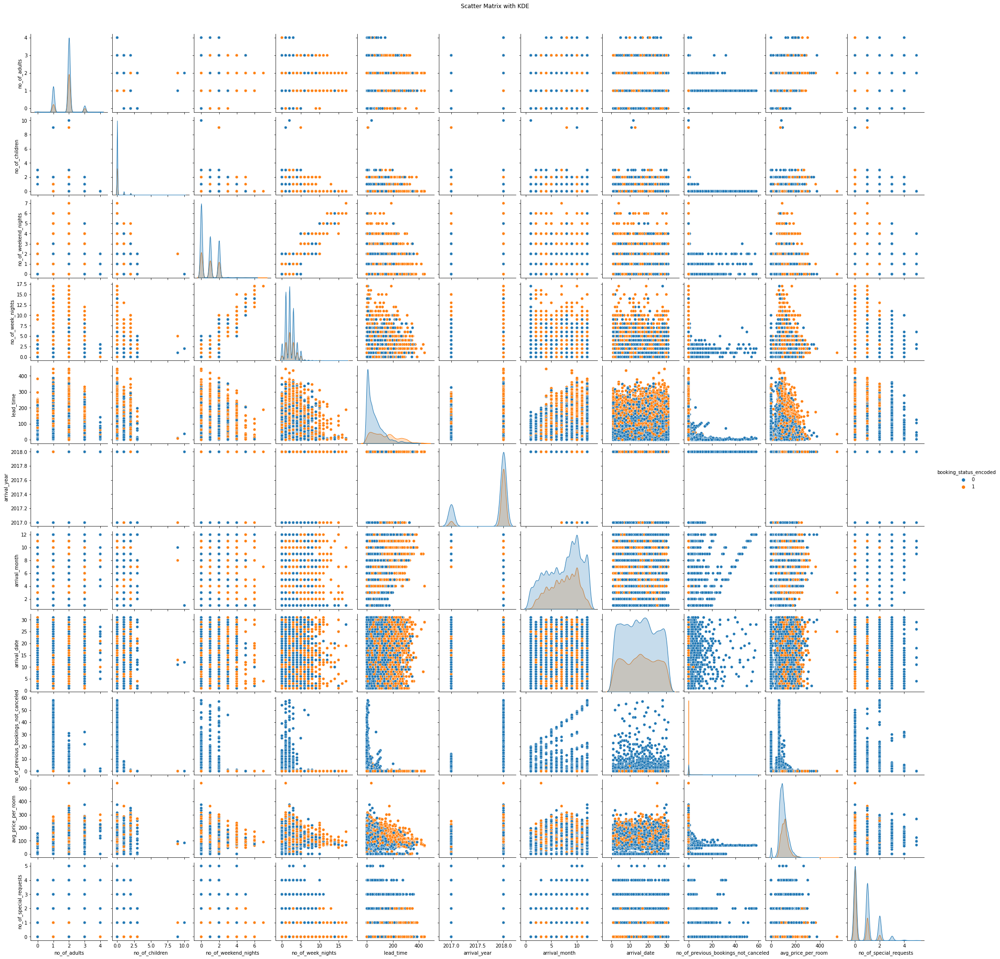

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select only numeric columns from df_hotel_reservation
numeric_columns = ['no_of_adults', 'no_of_children', 'no_of_weekend_nights',
       'no_of_week_nights','lead_time', 'arrival_year', 'arrival_month',
       'arrival_date','no_of_previous_bookings_not_canceled',
       'avg_price_per_room', 'no_of_special_requests',"booking_status_encoded"]

# Create the scatter matrix with KDE plots for numeric columns
scatter_matrix = sns.pairplot(df_hotel_reservation[numeric_columns], diag_kind="kde", markers="o", height=2.5, hue="booking_status_encoded")

# Customize the scatter matrix
scatter_matrix.fig.suptitle("Scatter Matrix with KDE", y=1.02)

plt.show()

###

<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
Exploratory Data Analysis (EDA) Code Overview
</h3>

The provided code is an example of Exploratory Data Analysis (EDA) for a hotel reservation dataset. EDA is an important step in the data preprocessing phase, where we explore and understand the data before applying any transformations or preprocessing techniques.

##### Purpose:
The main purpose of this code is to provide an interactive web-based dashboard that allows users, especially those unfamiliar with coding, to explore the dataset visually. The dashboard shows relationships between various columns of the hotel reservation data, helping users gain insights into the data's characteristics and distributions.

##### Features:
1. **Data Load and Visualization:** The code loads the hotel reservation data into a DataFrame and then visualizes relationships between different columns using interactive scatter plots and bar charts.

2. **Dropdowns for Selection:** Users can select specific columns to plot on the scatter plots and bar charts using dropdown menus. This allows users to compare different variables and identify potential patterns or trends.

3. **Color-Coding Based on 'booking_status':** The bars in the bar chart are color-coded based on the 'booking_status' column, helping users distinguish different booking statuses easily.

4. **Dark Theme:** The dashboard is designed with a dark theme (background color: #303030) to provide better visibility of the visualizations and make them more visually appealing.

5. **Download Options:** The dashboard provides buttons to download the scatter plot and bar chart as HTML files, enabling users to save the visualizations for future reference or sharing with others.

##### Benefits:
By interacting with this dashboard, users can quickly get a sense of the dataset's structure, observe any potential outliers or patterns, and understand the relationships between different variables. This understanding is essential before proceeding with data preprocessing, as it helps users make informed decisions about which preprocessing techniques are suitable for handling specific features in the dataset.

Overall, this EDA code provides a user-friendly way for individuals with limited coding experience to explore the hotel reservation data, enabling them to grasp the data's characteristics and relationships more easily.

## 
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       IV. Feature preprocessing & Engineering:
    </h2>

**Goal and Usage of the Hotel Reservation Data Analysis Dashboard**

The Hotel Reservation Data Analysis Dashboard is a powerful tool designed to help you explore and gain insights from a hotel reservation dataset. By leveraging interactive visualizations, you can uncover relationships and trends within the data, assisting in making informed decisions. Here's how to use this dashboard effectively:

1. **Visualization Selection**: The dashboard provides two primary types of visualizations: Scatter Plots and Bar Charts. You can switch between these options based on your analysis needs.

2. **Scatter Plot Exploration**:
   - Select the variables for the x-axis and y-axis of the Scatter Plot. These variables are chosen from the numeric columns of the dataset.
   - Observe how the chosen variables interact with each other, providing insights into potential correlations or patterns.
   - The Scatter Plot color-codes data points based on booking status, aiding in the identification of booking outcomes.

3. **Bar Chart Investigation**:
   - Choose a categorical variable from the dropdown menu to analyze in the Bar Chart.
   - Gain an understanding of the distribution of the selected categorical variable across different booking statuses.
   - Visualize the counts of categories, helping to identify trends or imbalances in the dataset.

4. **Interactivity**: The dashboard allows you to interact with the visualizations in real-time. Change the variables and categories to see how different factors impact the booking outcomes.

5. **Insights**: By using this interactive dashboard, you can unearth valuable insights, such as relationships between variables and the influence of different factors on booking success or failure.

To use the Hotel Reservation Data Analysis Dashboard, run the provided Python code. It will launch a local server where you can explore the dataset visually. The dashboard provides a user-friendly interface to select variables, view visualizations, and gain meaningful insights from the data. You can further customize and adapt this dashboard to suit your specific analysis requirements.

In [90]:
import pandas as pd
import plotly.express as px
from dash import Dash, html, dcc, callback
from dash.dependencies import Input, Output

# Create the Dash app
app = Dash(__name__)

# Scatter Plot
def create_scatter_plot(x_column, y_column):
    scatter_fig = px.scatter(df, x=x_column, y=y_column, color="booking_status", title=f"{x_column.capitalize()} vs {y_column.capitalize()}", template='plotly_dark')
    scatter_fig.update_layout(height=600)
    return scatter_fig

# Bar Chart
def create_bar_chart(selected_column):
    color_discrete_sequence = ["#fa3005", "#053fed"]
    bar_fig = px.bar(df, x=selected_column, color="booking_status", title=f"Count of {selected_column.capitalize()}", color_discrete_sequence=color_discrete_sequence)
    bar_fig.update_layout(height=600)
    return bar_fig

# Create the app layout
if not df.empty:
    scatter_dropdown_columns = df.select_dtypes(include=["float64", "int64"]).columns
    bar_dropdown_columns = df.select_dtypes(include=["object"]).columns

    app.layout = html.Div(
        children=[
            html.H1("Hotel Reservation Data Analysis", style={"text-align": "center", "color": "white"}),
            html.Div("Explore relationships between various columns in the hotel reservation dataset",
                     style={"text-align": "center", "color": "white"}),
            html.Br(),
            html.Div(
                children=[
                    dcc.Dropdown(
                        id="scatter-x-axis",
                        options=[{"label": col, "value": col} for col in scatter_dropdown_columns],
                        value=scatter_dropdown_columns[0],
                        clearable=False,
                        style={"display": "inline-block", "width": "48%", "color": "black"}
                    ),
                    dcc.Dropdown(
                        id="scatter-y-axis",
                        options=[{"label": col, "value": col} for col in scatter_dropdown_columns],
                        value=scatter_dropdown_columns[1],
                        clearable=False,
                        style={"display": "inline-block", "width": "48%", "color": "black"}
                    ),
                    dcc.Graph(id="scatter-chart", figure=create_scatter_plot(scatter_dropdown_columns[0], scatter_dropdown_columns[1]))
                ],
                style={"display": "inline-block", "width": "48%"}
            ),
            html.Div(
                children=[
                    dcc.Dropdown(
                        id="bar-axis",
                        options=[{"label": col, "value": col} for col in bar_dropdown_columns],
                        value=bar_dropdown_columns[0],
                        clearable=False,
                        style={"display": "inline-block", "width": "48%", "color": "black"}
                    ),
                    dcc.Graph(id="bar-chart", figure=create_bar_chart(bar_dropdown_columns[0]))
                ],
                style={"display": "inline-block", "width": "48%"}
            ),
        ],
        style={"padding": "50px", "background-color": "#303030"}
    )

    # Callback to update Scatter Plot
    @app.callback(
        Output("scatter-chart", "figure"),
        [Input("scatter-x-axis", "value"), Input("scatter-y-axis", "value")]
    )
    def update_scatter_chart(x_column, y_column):
        return create_scatter_plot(x_column, y_column)

    # Callback to update Bar Chart
    @app.callback(
        Output("bar-chart", "figure"),
        [Input("bar-axis", "value")]
    )
    def update_bar_chart(selected_column):
        return create_bar_chart(selected_column)

# Run the app on a local server
if __name__ == "__main__":
    app.run_server(debug=False, dev_tools_ui=False, dev_tools_props_check=False, port=8057)
    
    # After running the server, you can get the figure and save it as an HTML file
    #fig = app.layout
    #output_file = "dash_app.html"
    #pio.write_html(app.layout, file=output_file)

**Important:** In case the interactive visualization isn't visible, you can refer to the images provided below. Please note that the current setup requires the code to be hosted on a server, a step that will be implemented in the future.

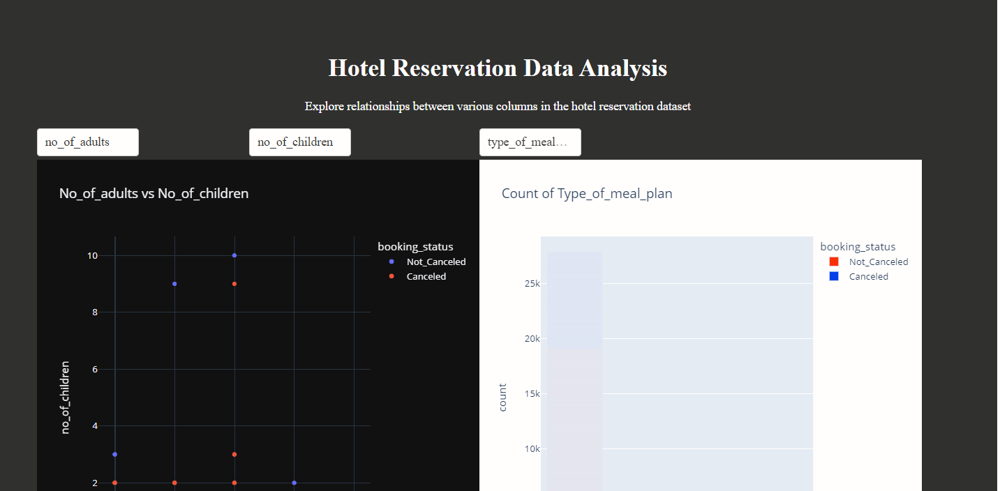
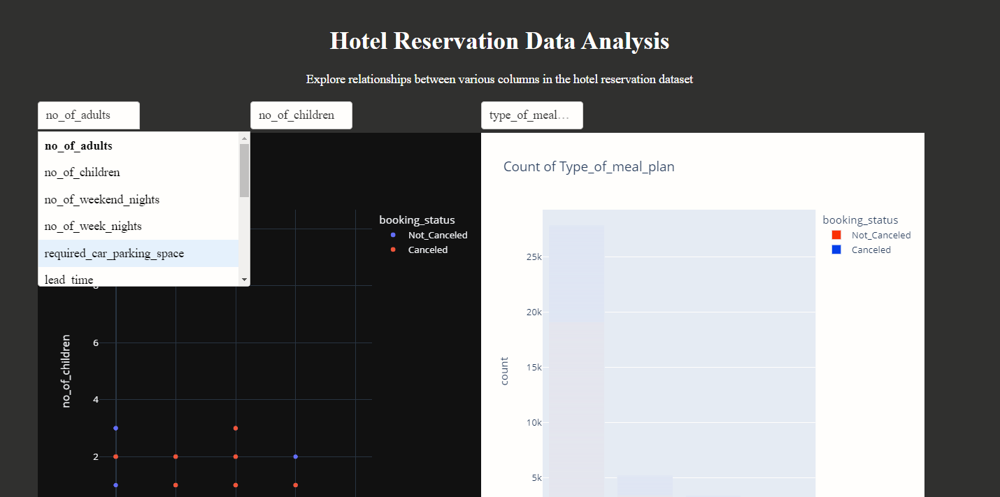
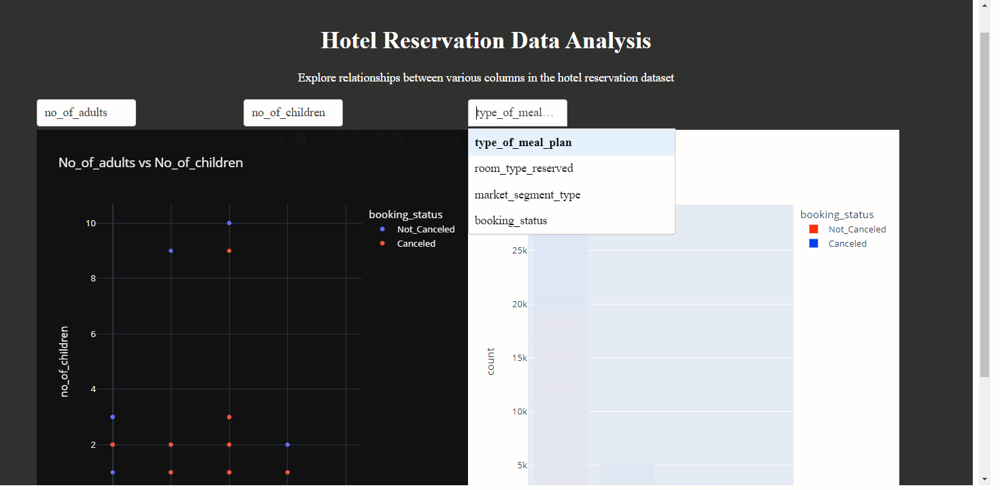

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
1. Handling Missing Values:
</h3>

As observed, there are no missing values in the dataset.

### 

<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
2. Removing Duplicates:
</h3>

- To avoid any redundancies, we meticulously identified and eliminated duplicate entries from the dataset.

In [39]:
import pandas as pd

# Check for duplicates
duplicate_rows = df_hotel_reservation.duplicated()

# Count the number of duplicates
num_duplicates = duplicate_rows.sum()

# Print the result
if num_duplicates > 0:
    print(f"The DataFrame contains {num_duplicates} duplicate rows.")
else:
    print("There are no duplicate rows in the DataFrame.")


The DataFrame contains 10275 duplicate rows.


- **It was discovered that the DataFrame contains a significant number of duplicate rows.** In total, there are 10,275 duplicate rows present in the dataset.

- For the purpose of our analysis and model building, we have decided not to remove these duplicate rows from the DataFrame. Instead, we will proceed with the duplicates included in the data, taking into account their potential impact on the results.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
3. Addressing Data Inconsistencies:
</h3>
   

- We checked for and resolved any inconsistencies in the data to ensure accurate and reliable results during model training.

#### 1. Average Price Per Room = 0

There are a total of 545 rows in the dataset where the "avg_price_per_room" column has values equal to zero, indicating the presence of potential outliers or special cases with discounted prices. These specific rows warrant further investigation to understand the reasons behind the zero values and ensure the accuracy of our analysis.

In [31]:
df_hotel_reservation[df_hotel_reservation['avg_price_per_room'] == 0]

,Booking_ID,no_of_adults,no_of_children,no_of_weekend_nights,no_of_week_nights,type_of_meal_plan,required_car_parking_space,room_type_reserved,lead_time,arrival_year,arrival_month,arrival_date,market_segment_type,repeated_guest,no_of_previous_cancellations,no_of_previous_bookings_not_canceled,avg_price_per_room,no_of_special_requests,booking_status,booking_status_encoded
63,INN00064,1,0,0,1,Meal Plan 1,0,Room_Type 1,2,2017,9,10,Complementary,0,0,0,0.0,1,Not_Canceled,0
145,INN00146,1,0,0,2,Meal Plan 1,0,Room_Type 1,13,2018,6,1,Complementary,1,3,5,0.0,1,Not_Canceled,0
209,INN00210,1,0,0,0,Meal Plan 1,0,Room_Type 1,4,2018,2,27,Complementary,0,0,0,0.0,1,Not_Canceled,0
266,INN00267,1,0,0,2,Meal Plan 1,0,Room_Type 1,1,2017,8,12,Complementary,1,0,1,0.0,1,Not_Canceled,0
267,INN00268,1,0,2,1,Meal Plan 1,0,Room_Type 1,4,2017,8,23,Complementary,0,0,0,0.0,1,Not_Canceled,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35983,INN35984,1,0,0,1,Meal Plan 1,0,Room_Type 7,0,2018,6,7,Complementary,1,4,17,0.0,1,Not_Canceled,0
36080,INN36081,1,0,1,1,Meal Plan 1,0,Room_Type 7,0,2018,3,21,Complementary,1,3,15,0.0,1,Not_Canceled,0
36114,INN36115,1,0,0,1,Meal Plan 1,0,Room_Type 1,1,2018,3,2,Online,0,0,0,0.0,0,Not_Canceled,0
36217,INN36218,2,0,2,1,Meal Plan 1,0,Room_Type 2,3,2017,8,9,Online,0,0,0,0.0,2,Not_Canceled,0


Furthermore, it is noteworthy that the majority of the data with zero values in the "avg_price_per_room" column (539 out of the 545 rows) corresponds to reservations that were not canceled. This observation may suggest that the zero values could indeed be related to discounted or promotional offers for non-canceled bookings. However, to draw more definitive conclusions, additional analysis and domain knowledge might be required.

In [34]:
df_hotel_reservation[df_hotel_reservation['avg_price_per_room'] == 0][['booking_status']].value_counts()

booking_status
Not_Canceled      539
Canceled            6
dtype: int64

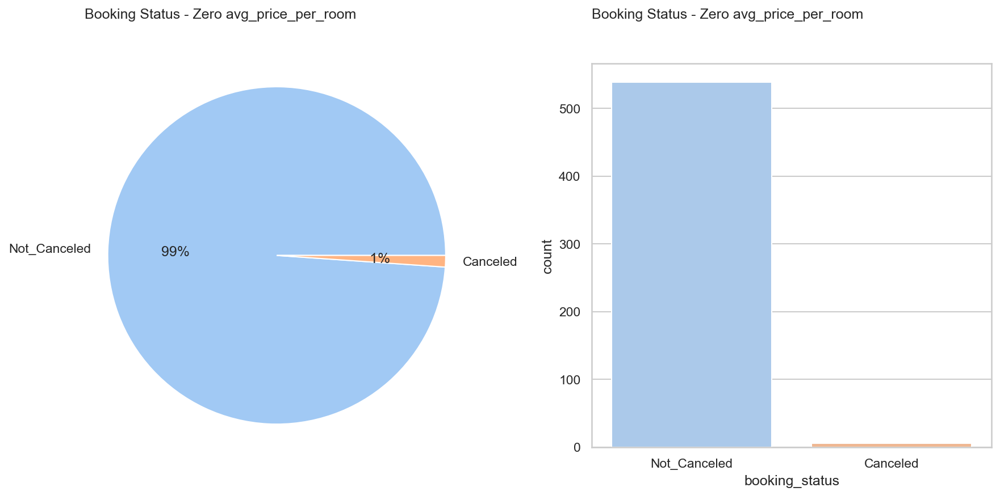

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the seaborn style
sns.set(style='whitegrid')

# Set the figure size and dpi
plt.figure(figsize=(12, 6), dpi=150)

# Pie chart for booking_status distribution in zero_avg_price_df
plt.subplot(121)
status_counts = zero_avg_price_df['booking_status'].value_counts()
colors = sns.color_palette('pastel')
plt.pie(status_counts, labels=status_counts.index, autopct='%2.f%%', radius=1.1, colors=colors)
plt.title('Booking Status - Zero avg_price_per_room', loc='left', y=1.1)

# Count plot for booking_status distribution in zero_avg_price_df
plt.subplot(122)
sns.countplot(data=zero_avg_price_df, x='booking_status', palette='pastel')
plt.title('Booking Status - Zero avg_price_per_room', loc='left', y=1.1)
plt.tight_layout()
plt.show()


Upon further analysis, I observed that certain entries in the "avg_price_per_room" column have values equal to zero, which might seem unusual at first glance. However, this observation could be attributed to possible discounts or special pricing arrangements. However, to draw more definitive conclusions, additional analysis and domain knowledge might be required.

#### 2. Exploration of Lead Time Values in Hotel Reservation Data

During the analysis of the hotel reservation dataset, a particular feature caught our attention - the "lead_time" column. The "lead_time" represents the number of days between the date of booking and the arrival date. We observed that some of the lead time values exceeded 365 days, raising questions about the dataset's range and the hotel's opening date during data collection.

In [47]:
df_hotel_reservation[df_hotel_reservation['lead_time']> 365]

,Booking_ID,no_of_adults,no_of_children,no_of_weekend_nights,no_of_week_nights,type_of_meal_plan,required_car_parking_space,room_type_reserved,lead_time,arrival_year,arrival_month,arrival_date,market_segment_type,repeated_guest,no_of_previous_cancellations,no_of_previous_bookings_not_canceled,avg_price_per_room,no_of_special_requests,booking_status,booking_status_encoded
118,INN00119,2,0,0,1,Meal Plan 1,0,Room_Type 1,443,2018,4,29,Online,0,0,0,65.0,0,Canceled,1
199,INN00200,2,0,1,2,Meal Plan 2,0,Room_Type 1,418,2018,9,26,Online,0,0,0,107.0,0,Canceled,1
205,INN00206,2,0,0,3,Meal Plan 1,0,Room_Type 1,433,2018,9,8,Online,0,0,0,70.0,0,Canceled,1
369,INN00370,2,0,2,0,Meal Plan 2,0,Room_Type 1,386,2018,10,23,Online,0,0,0,115.0,1,Canceled,1
418,INN00419,2,0,2,0,Meal Plan 2,0,Room_Type 1,386,2018,10,23,Online,0,0,0,115.0,1,Canceled,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35488,INN35489,2,0,2,0,Meal Plan 2,0,Room_Type 1,386,2018,10,23,Offline,0,0,0,115.0,1,Canceled,1
35594,INN35595,2,0,1,2,Meal Plan 2,0,Room_Type 1,418,2018,9,26,Offline,0,0,0,107.0,0,Canceled,1
35656,INN35657,2,0,0,1,Meal Plan 1,0,Room_Type 1,443,2018,4,29,Offline,0,0,0,65.0,0,Canceled,1
36006,INN36007,2,0,0,2,Meal Plan 2,0,Room_Type 1,377,2018,10,14,Offline,0,0,0,115.0,1,Canceled,1


Based on additional information obtained from the creator of the dataset on their website, we have learned that the opening date of the hotel is older than the timeframe covered in the reservations data. The dataset only captures reservations data for a period of 1.5 years. This new insight clarifies the discrepancy in the "lead_time" values exceeding 365 days. With this understanding, we can confidently proceed with the analysis and take into account the limited timeframe during which the reservation data was collected.

#### 3. 37 Observations with Invalid Date (2018-02-29) 

While attempting to create a date column in the format YYYY-MM-DD using the column arrival_year, arrival_month and arrival_date , a concerning inconsistency was discovered. There are 37 observations in the dataset that contain the date "2018-02-29," which is an invalid date since February 2018 had only 28 days. This inconsistency raises questions about the data collection process and the need for careful handling of date-related information.

In [ ]:
# Combine the year, month, and date columns to create the "date" column
df_hotel_reservation['date'] = df_hotel_reservation.apply(lambda row: '-'.join([str(row['arrival_year']), str(row['arrival_month']), str(row['arrival_date'])]), axis=1)

# Convert the "date" column to the desired format "YYYY-MM-DD"
df_hotel_reservation['date'] = pd.to_datetime(df_hotel_reservation['date'])

# Display the DataFrame with the new "date" column
df_hotel_reservation[['arrival_year', 'arrival_month', 'arrival_date', 'date']]

In [37]:
# Let's delete the new column since we don't need it
df_hotel_reservation.drop('date', axis= 1, inplace = True)

When attempting to combine the data from the columns to build the date column, we encountered an error due to the presence of an invalid day, which is February 29 in non-leap years. Let's now count how many rows have this nonexistent day (February 29) in the "arrival_date" column:

In [38]:
# Count the number of rows with the nonexistent day (February 29) in the "arrival_date" column
invalid_date_count = df_hotel_reservation[(df_hotel_reservation['arrival_month'] == 2) & (df_hotel_reservation['arrival_date'] == 29)].shape[0]

print(f"The number of rows with the nonexistent day (February 29) in the 'arrival_date' column is: {invalid_date_count}")


The number of rows with the nonexistent day (February 29) in the 'arrival_date' column is: 37


Since we are unsure whether only the day is wrong or the entire row is incorrect, we will retain the rows with the invalid date (February 29) without making any modifications

I decided that the best solution is to create a new column called "date_valid" with two values (0 if invalid, 1 if valid) based on the "arrival_month" and "arrival_date" columns.

In [39]:
# Create a function to check if the date is valid
def is_valid_date(row):
    month = row['arrival_month']
    day = row['arrival_date']
    
    # Check for invalid dates (February 29)
    if month == 2 and day == 29:
        return 0
    else:
        return 1

# Apply the function to create the "date_valid" column
df_hotel_reservation['date_valid'] = df_hotel_reservation.apply(is_valid_date, axis=1)

To verify that the function worked properly and count how many values have been marked as invalid (0) in the "date_valid" column.

In [40]:
# Count the number of rows with invalid dates and display the result
invalid_date_rows = df_hotel_reservation[df_hotel_reservation['date_valid'] == 0].shape[0]
print(f"The number of rows with invalid dates are: {invalid_date_rows}")

# Display a separator line
print(f"\n{'-'*45}")

# Count the occurrences of valid and invalid dates and display the result
date_valid_counts = df_hotel_reservation['date_valid'].value_counts()
print(date_valid_counts)

The number of rows with invalid dates are: 37

---------------------------------------------
1    36238
0       37
Name: date_valid, dtype: int64


#### 4. Inconsistency Between Weekday and Weekend Nights Stay in Hotel Reservations Data

I am concerned about the inconsistency where the number of no_of_week_nights is greater than five days, but the number of no_of_weekend_nights is less than 2, which doesn't make sense. For instance, if someone is staying for 6 weekday nights, they can stay from Monday to Friday for 5 weekday nights and then the next Monday for a total of 6 weekday nights. However, to reach this total, they must also stay on the Sunday and Saturday before the next Monday for 2 weekend nights. Let's descover if the current data reflect this logical relationship.

In [41]:
# Select rows from df_hotel_reservation where the number of week nights is greater than 5 and the number of weekend nights is less than 2
selected_rows = df_hotel_reservation[(df_hotel_reservation['no_of_week_nights'] > 5) & (df_hotel_reservation['no_of_weekend_nights'] < 2)]

# Get the number of rows in the selected_rows DataFrame
num_rows = selected_rows.shape[0]

# Print the number of rows that meet the specified condition
print(f"The number of rows where 'no_of_week_nights' > 5 and 'no_of_weekend_nights' < 2 is: {num_rows}")


The number of rows where 'no_of_week_nights' > 5 and 'no_of_weekend_nights' < 2 is: 0


Great! It looks like the data set is in good shape and doesn't have any issues with the combination of 'no_of_week_nights' and 'no_of_weekend_nights'. The fact that the number of rows where 'no_of_week_nights' > 5 and 'no_of_weekend_nights' < 2 is 0 indicates that there are no inconsistencies with this specific scenario in the data. This information gives us confidence that the data is reliable and can be used for further analysis or modeling.

#### 5. Inconsistent Night Stays in Hotel Reservations Data

**Both no_week_nights AND no_weekend_nights are 0?**

During data analysis, it was observed that there are 78 rows in the hotel reservations dataset where the sum of weekday nights and weekend nights is zero. This raises concerns about the accuracy of the data, as it is unlikely for guests to have a total stay of zero nights. Further investigation is required to understand the cause of this inconsistency and ensure data reliability.

In [42]:
# Count the number of rows where both 'no_of_weekend_nights' and 'no_of_week_nights' are zero
num_zero_nights = df_hotel_reservation[(df_hotel_reservation['no_of_weekend_nights'] == 0) & (df_hotel_reservation['no_of_week_nights'] == 0)].shape[0]

# Output the result
print(f"The number of rows where the total nights (weekday and weekend) sum to zero: {num_zero_nights}")

The number of rows where the total nights (weekday and weekend) sum to zero: 78


Perhaps these cases occur due to cancellations. For instance, if a guest cancels the reservation before completing the process of choosing specific days, it can lead to both 'no_of_weekend_nights' and 'no_of_week_nights' being zero. Properly addressing this issue may require domain knowledge and further investigation.

#### 6. Inconsistent Number of Adults and Children in Bookings
**no_of_children is exist while no_of_adults = 0?**

In the dataset, we have observed a peculiar inconsistency where the 'no_of_children' column is not equal to 0 while the 'no_of_adults' column is 0. This raises questions about the nature of these bookings. It suggests that there are instances where children are recorded in bookings without any accompanying adults. Understanding the implications of this scenario requires further investigation and domain knowledge to ascertain whether children are indeed staying in the room unaccompanied or if there might be data entry errors or other reasons behind this inconsistency.

In [43]:
# Count the number of rows where 'no_of_adults' is 0 and 'no_of_children' is not 0
num_rows_with_children_without_adults = df_hotel_reservation[(df_hotel_reservation['no_of_adults'] == 0) & (df_hotel_reservation['no_of_children'] != 0)].shape[0]

# Display the count of rows with children but without accompanying adults
print(f"Number of rows where 'no_of_adults' is 0 and 'no_of_children' is not 0: {num_rows_with_children_without_adults}")


Number of rows where 'no_of_adults' is 0 and 'no_of_children' is not 0: 139


***After conducting further research***, I discovered that it is crucial to consider that ***some hotels might allow individuals under the age of 18 to book a room.*** However, even in such cases, the hotel may still require a parent or guardian to either sign a permission form or be present during the check-in process. This could explain why there are instances in the data where the 'no_of_children' is not 0 while the 'no_of_adults' is 0. The hotel that provided this data may have a policy in place to accommodate bookings made by individuals under 18 years of age, but with additional requirements to ensure safety and compliance with regulations.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
4. Encoding Categorical Variables:
</h3>


- In the process of encoding categorical variables, we transform non-numeric data into a numerical format, allowing machine learning models to work effectively with this type of information. 

Let's examine the data types of the variables in the dataset. By inspecting the data types, we can gain insights into how each feature is represented in the dataset. 

In [44]:
df_hotel_reservation.dtypes

no_of_adults                              int64
no_of_children                            int64
no_of_weekend_nights                      int64
no_of_week_nights                         int64
type_of_meal_plan                        object
required_car_parking_space                int64
room_type_reserved                       object
lead_time                                 int64
arrival_year                              int64
arrival_month                             int64
arrival_date                              int64
market_segment_type                      object
repeated_guest                            int64
no_of_previous_cancellations              int64
no_of_previous_bookings_not_canceled      int64
avg_price_per_room                      float64
no_of_special_requests                    int64
booking_status                           object
booking_status_encoded                    int64
date_valid                                int64
dtype: object

We noticed that there are four columns in the dataset that need to be encoded:

1. `type_of_meal_plan`
2. `room_type_reserved`
3. `market_segment_type`
4. `booking_status`

We will apply an encoding technique to transform these categorical variables into numerical format, making it easier for machine learning models to process and analyze the data.

#### 1. `type_of_meal_plan`

In [45]:
# Get the counts of unique values in the 'type_of_meal_plan' column
meal_plan_counts = df_hotel_reservation['type_of_meal_plan'].value_counts()

# Display the counts for each unique value
print(meal_plan_counts)

Meal Plan 1     27835
Not Selected     5130
Meal Plan 2      3305
Meal Plan 3         5
Name: type_of_meal_plan, dtype: int64


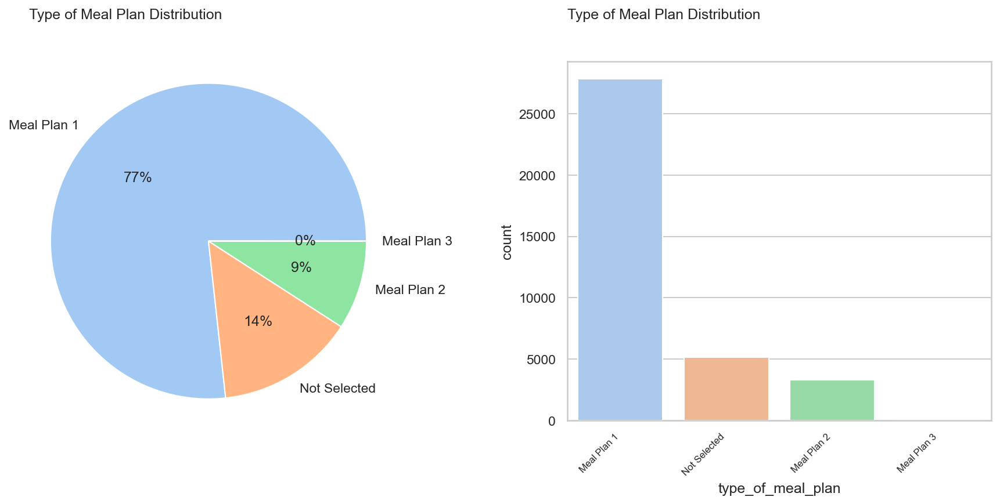

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the seaborn style
sns.set(style='whitegrid')

# Set the figure size and dpi
plt.figure(figsize=(12, 6), dpi=150)

# Pie chart for type_of_meal_plan distribution
plt.subplot(121)
meal_plan_counts = df_hotel_reservation['type_of_meal_plan'].value_counts()
colors = sns.color_palette('pastel')
plt.pie(meal_plan_counts, labels=meal_plan_counts.index, autopct='%2.f%%', radius=1.1, colors=colors)
plt.title('Type of Meal Plan Distribution', loc='left', y=1.1)

# Count plot for type_of_meal_plan distribution
plt.subplot(122)
sns.countplot(data=df_hotel_reservation, x='type_of_meal_plan', palette='pastel')
plt.title('Type of Meal Plan Distribution', loc='left', y=1.1)
plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate and adjust x-axis labels
plt.tight_layout()
plt.show()

let's use label encoding to convert the categorical variable into numerical representations.

In [91]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder object
label_encoder_type_of_meal_plan = LabelEncoder()

# Label encode the 'type_of_meal_plan' column
df_hotel_reservation['type_of_meal_plan'] = label_encoder_type_of_meal_plan.fit_transform(df_hotel_reservation['type_of_meal_plan'])

#### 2. `room_type_reserved`

In [48]:
# Get the counts of unique values in the 'room_type_reserved' column
room_type_counts = df_hotel_reservation['room_type_reserved'].value_counts()

# Display the counts for each unique value
print(room_type_counts)

Room_Type 1    28130
Room_Type 4     6057
Room_Type 6      966
Room_Type 2      692
Room_Type 5      265
Room_Type 7      158
Room_Type 3        7
Name: room_type_reserved, dtype: int64


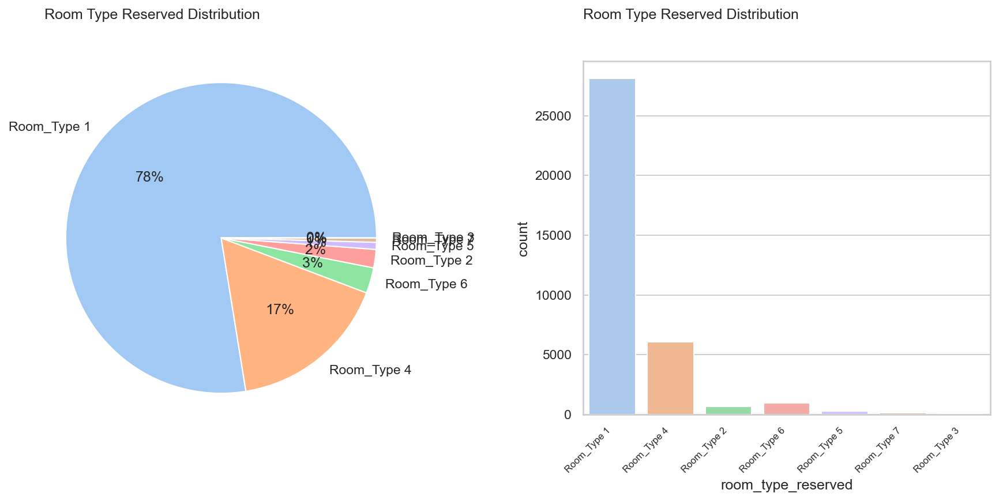

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the seaborn style
sns.set(style='whitegrid')

# Set the figure size and dpi
plt.figure(figsize=(12, 6), dpi=150)

# Pie chart for room_type_reserved distribution
plt.subplot(121)
room_type_counts = df_hotel_reservation['room_type_reserved'].value_counts()
colors = sns.color_palette('pastel')
plt.pie(room_type_counts, labels=room_type_counts.index, autopct='%2.f%%', radius=1.1, colors=colors)
plt.title('Room Type Reserved Distribution', loc='left', y=1.1)

# Count plot for room_type_reserved distribution
plt.subplot(122)
sns.countplot(data=df_hotel_reservation, x='room_type_reserved', palette='pastel')
plt.title('Room Type Reserved Distribution', loc='left', y=1.1)
plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate and adjust x-axis labels
plt.tight_layout()
plt.show()


let's use label encoding to convert the categorical variable into numerical representations.

In [92]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder object
label_encoder_room_type_reserved = LabelEncoder()

# Label encode the 'room_type_reserved' column
df_hotel_reservation['room_type_reserved'] = label_encoder_room_type_reserved.fit_transform(df_hotel_reservation['room_type_reserved'])


#### 3. `market_segment_type`

In [122]:
# Get the counts of unique values in the 'market_segment_type' column
market_segment_counts = df_hotel_reservation['market_segment_type'].value_counts()

# Display the counts for each unique value
print(market_segment_counts)

Online           23214
Offline          10528
Corporate         2017
Complementary      391
Aviation           125
Name: market_segment_type, dtype: int64


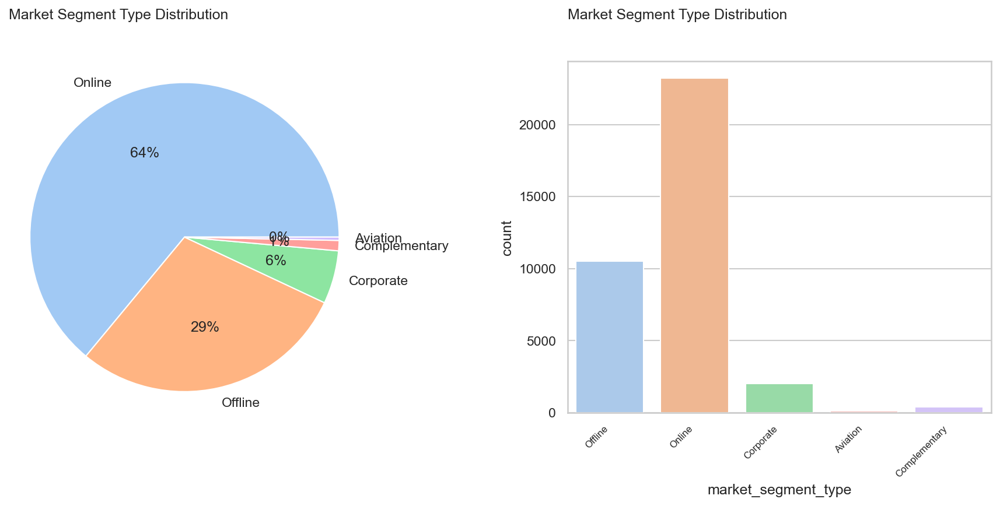

In [29]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the seaborn style
sns.set(style='whitegrid')

# Set the figure size and dpi
plt.figure(figsize=(12, 6), dpi=150)

# Pie chart for market_segment_type distribution
plt.subplot(121)
market_segment_counts = df_hotel_reservation['market_segment_type'].value_counts()
colors = sns.color_palette('pastel')
plt.pie(market_segment_counts, labels=market_segment_counts.index, autopct='%2.f%%', radius=1.1, colors=colors)
plt.title('Market Segment Type Distribution', loc='left', y=1.1)

# Count plot for market_segment_type distribution
plt.subplot(122)
sns.countplot(data=df_hotel_reservation, x='market_segment_type', palette='pastel')
plt.title('Market Segment Type Distribution', loc='left', y=1.1)
plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate and adjust x-axis labels
plt.tight_layout()
plt.show()


let's use label encoding to convert the categorical variable into numerical representations.

In [93]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder object
label_encoder_market_segment_type = LabelEncoder()

# Label encode the 'market_segment_type' column
df_hotel_reservation['market_segment_type'] = label_encoder_market_segment_type.fit_transform(df_hotel_reservation['market_segment_type'])

#### 4. `booking_status`

In [94]:
# let's delete the column 'booking_status_encoded' that we used for EDA.
df_hotel_reservation.drop('booking_status_encoded', inplace = True, axis = 1)

In [95]:
# Get the counts of unique values in the 'booking_status' column
booking_status_counts = df_hotel_reservation['booking_status'].value_counts()

# Display the counts for each unique value
print(booking_status_counts)

Not_Canceled    24390
Canceled        11885
Name: booking_status, dtype: int64


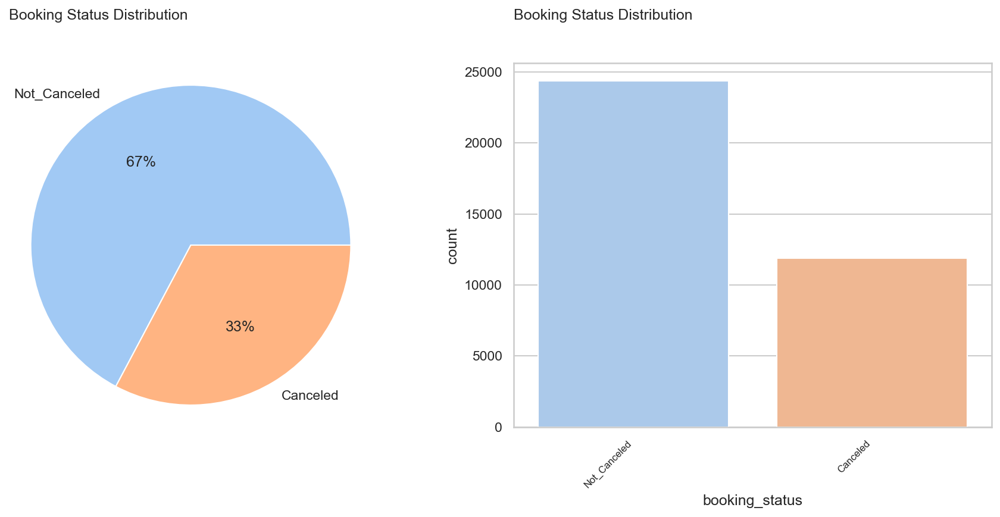

In [54]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the seaborn style
sns.set(style='whitegrid')

# Set the figure size and dpi
plt.figure(figsize=(12, 6), dpi=150)

# Pie chart for booking_status distribution
plt.subplot(121)
booking_status_counts = df_hotel_reservation['booking_status'].value_counts()
colors = sns.color_palette('pastel')
plt.pie(booking_status_counts, labels=booking_status_counts.index, autopct='%2.f%%', radius=1.1, colors=colors)
plt.title('Booking Status Distribution', loc='left', y=1.1)

# Count plot for booking_status distribution
plt.subplot(122)
sns.countplot(data=df_hotel_reservation, x='booking_status', palette='pastel')
plt.title('Booking Status Distribution', loc='left', y=1.1)
plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate and adjust x-axis labels
plt.tight_layout()
plt.show()


let's use label encoding to convert the categorical variable into numerical representations.

In [96]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder object
label_encoder_booking_status = LabelEncoder()

# Label encode the 'booking_status' column
df_hotel_reservation['booking_status'] = label_encoder_booking_status.fit_transform(df_hotel_reservation['booking_status'])


#### Feature Encoding Results
**We have successfully completed the feature encoding process for the following columns:**

1. `type_of_meal_plan`
2. `room_type_reserved`
3. `market_segment_type`
4. `booking_status`

These categorical variables have been transformed using label encoding, which assigns unique numerical values to each category in each column. This process allows us to convert categorical data into a format that can be used for machine learning algorithms and other analytical tasks. The label-encoded columns are now ready for further analysis and model training.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
5. Feature Scaling:
</h3>
  

 - To avoid bias due to varying feature scales, we applied appropriate feature scaling techniques, such as normalization or standardization, to bring all features to a similar range.

Let's examine the data types of the variables in the dataset and values. By inspecting the data types, we can gain insights into how each feature is represented in the dataset.

In [56]:
df_hotel_reservation.dtypes

no_of_adults                              int64
no_of_children                            int64
no_of_weekend_nights                      int64
no_of_week_nights                         int64
type_of_meal_plan                         int32
required_car_parking_space                int64
room_type_reserved                        int32
lead_time                                 int64
arrival_year                              int64
arrival_month                             int64
arrival_date                              int64
market_segment_type                       int32
repeated_guest                            int64
no_of_previous_cancellations              int64
no_of_previous_bookings_not_canceled      int64
avg_price_per_room                      float64
no_of_special_requests                    int64
booking_status                            int32
date_valid                                int64
dtype: object

**We have identified four columns in the dataset that require scaling:**

1. `lead_time`: This column represents the number of days between the date of booking and the arrival date. Since this variable contains continuous numerical values, scaling is required to ensure that it falls within a similar range as other features and to prevent any dominance of one feature over others during model training.

2. `arrival_year`, `arrival_month`, and `arrival_date`: These columns represent the year, month, and date of arrival, respectively. Although these variables are discrete, scaling is still necessary because some machine learning algorithms are sensitive to the magnitude of input features. Scaling will help in maintaining consistency across different features.

3. `avg_price_per_room`: This column represents the average price per room for a reservation. As a continuous numerical variable, scaling will ensure that its range aligns with other features and contributes effectively to the model without being disproportionately weighted.

By applying scaling to these columns, we can prepare the data for more accurate and efficient model training and avoid potential issues related to feature magnitude discrepancies.

#### 1. Exploring Variables for Scaling Before Scaling

Before applying scaling to our variables, we need to explore them to understand their distribution and range of values. This exploration will help us determine whether scaling is necessary and which scaling method would be most suitable.

The variables we will be exploring are:

1. **Lead Time:** This variable represents the number of days between the booking date and the arrival date of the guests.

2. **Arrival Year, Arrival Month, and Arrival Date:** These variables represent the year, month, and day of the arrival date of the guests, respectively.

3. **Average Price per Room:** This variable represents the average price charged per room for reservations.

By visualizing the distributions and ranges of these variables, we can make informed decisions about whether and how to apply scaling to them.

In [97]:
import pandas as pd
import plotly.express as px
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

# Assuming df_hotel_reservation is the DataFrame containing the required columns
# You may need to replace this with the actual DataFrame name

# Create the Dash app
app = dash.Dash(__name__)

# Create the layout for the app
app.layout = html.Div([
    html.H1("Interactive EDA with Dash", style={'text-align': 'center'}),
    
    html.H2("Lead Time Histogram", style={'text-align': 'center'}),
    dcc.Graph(
        id='lead-time-histogram',
        figure=px.histogram(df_hotel_reservation, x='lead_time', title='Lead Time Histogram')
    ),
    
    html.H2("Arrival Year Count Plot", style={'text-align': 'center'}),
    dcc.Graph(
        id='arrival-year-countplot',
        figure=px.bar(df_hotel_reservation['arrival_year'].value_counts().reset_index(), x='index', y='arrival_year', title='Arrival Year Count Plot')
    ),
    
    html.H2("Arrival Month Count Plot", style={'text-align': 'center'}),
    dcc.Graph(
        id='arrival-month-countplot',
        figure=px.bar(df_hotel_reservation['arrival_month'].value_counts().reset_index(), x='index', y='arrival_month', title='Arrival Month Count Plot')
    ),
    
    html.H2("Arrival Date Histogram", style={'text-align': 'center'}),
    dcc.Graph(
        id='arrival-date-histogram',
        figure=px.histogram(df_hotel_reservation, x='arrival_date', title='Arrival Date Histogram')
    ),
    
    html.H2("Average Price per Room Histogram", style={'text-align': 'center'}),
    dcc.Graph(
        id='avg-price-per-room-histogram',
        figure=px.histogram(df_hotel_reservation, x='avg_price_per_room', title='Average Price per Room Histogram')
    ),
    
    html.H2("Correlation Heatmap", style={'text-align': 'center'}),
    dcc.Graph(
        id='correlation-heatmap',
        figure=px.imshow(df_hotel_reservation[['lead_time', 'arrival_year', 'arrival_month', 'arrival_date','avg_price_per_room']].corr(), title='Correlation Heatmap')
    ),
    
    html.H2("Scatter Plot: Lead Time vs. Average Price per Room", style={'text-align': 'center'}),
    dcc.Graph(
        id='scatter-lead-time-vs-price',
        figure=px.scatter(df_hotel_reservation, x='lead_time', y='avg_price_per_room', title='Lead Time vs. Average Price per Room', trendline='ols')
    ),
    
    dcc.Dropdown(
        id='category-dropdown',
        options=[
            {'label': 'Lead Time', 'value': 'lead_time'},
            {'label': 'Arrival Year', 'value': 'arrival_year'},
            {'label': 'Arrival Month', 'value': 'arrival_month'},
            {'label': 'Arrival date', 'value': 'arrival_date'},
            {'label': 'Avg Price Per Room', 'value': 'avg_price_per_room'}
        ],
        value='type_of_meal_plan',
        style={'width': '50%', 'margin': '20px auto'}
    ),
    
    html.Div(id='category-plot')
])

# Define callback to update the category plot
@app.callback(
    Output('category-plot', 'children'),
    [Input('category-dropdown', 'value')]
)
def update_category_plot(selected_category):
    return dcc.Graph(
        id='category-countplot',
        figure=px.bar(df_hotel_reservation[selected_category].value_counts().reset_index(), x='index', y=selected_category, title=f'{selected_category} Count Plot')
    )

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port = 8052)


**Important:** In case the interactive visualization isn't visible, you can refer to the images provided below. Please note that the current setup requires the code to be hosted on a server, a step that will be implemented in the future.

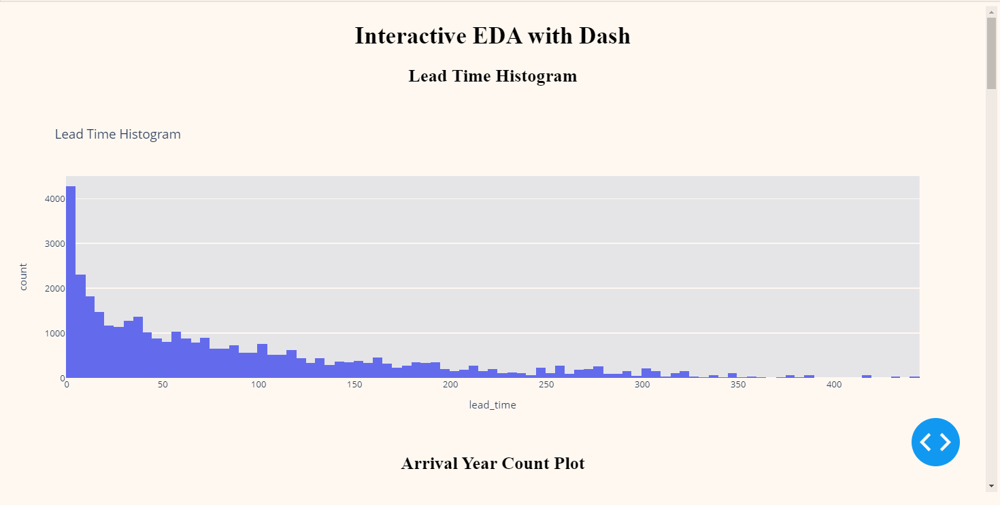
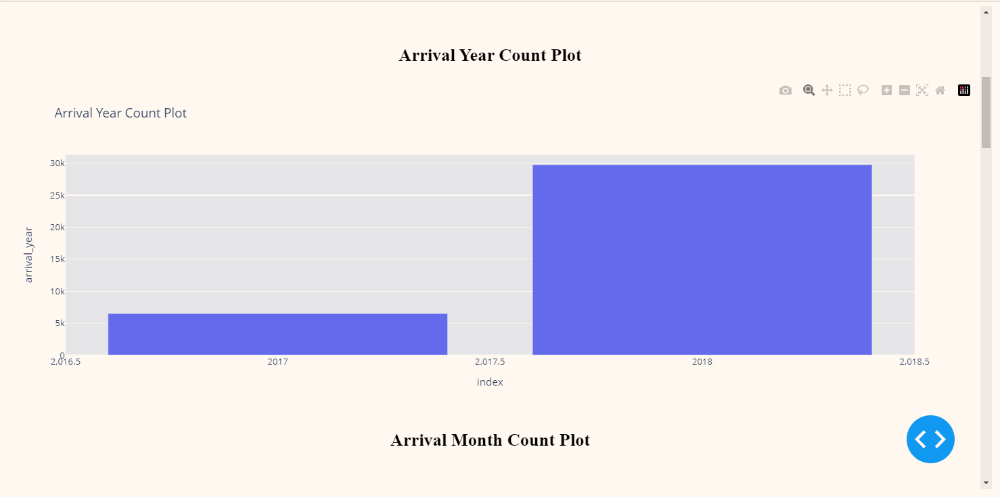
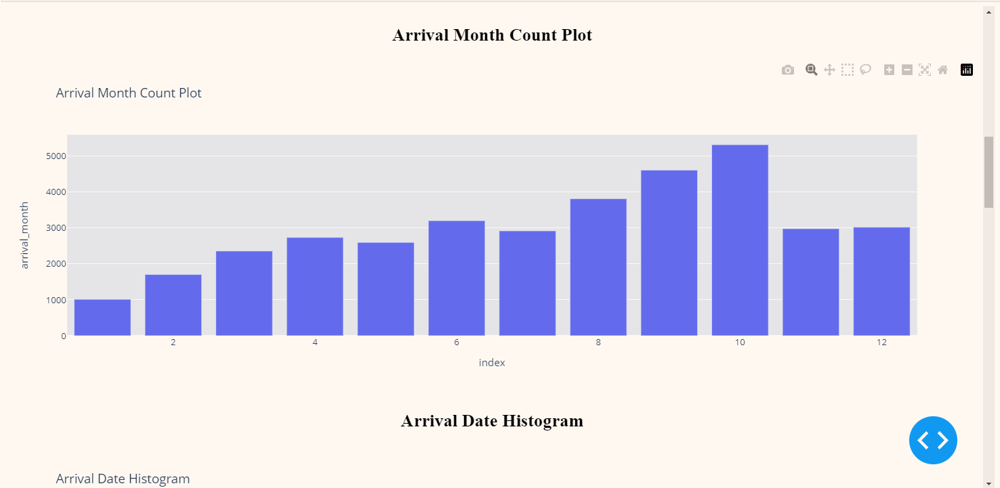
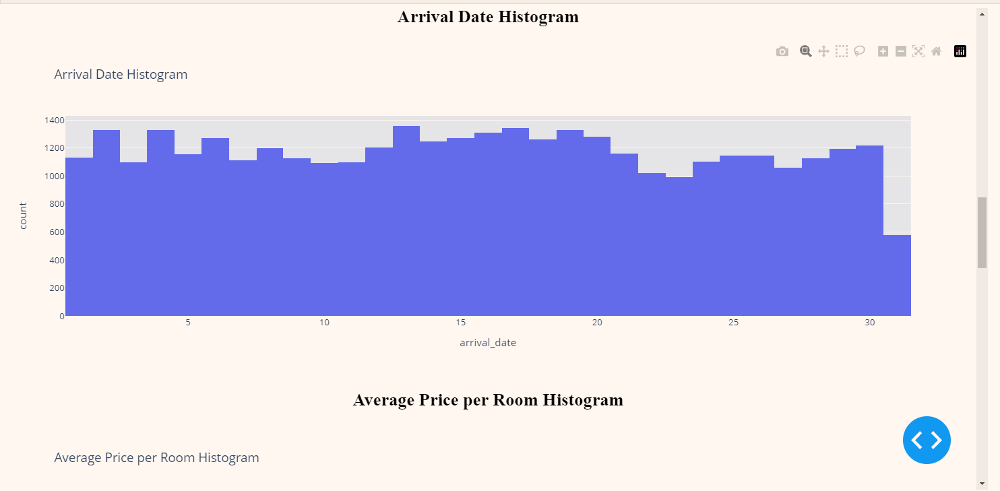
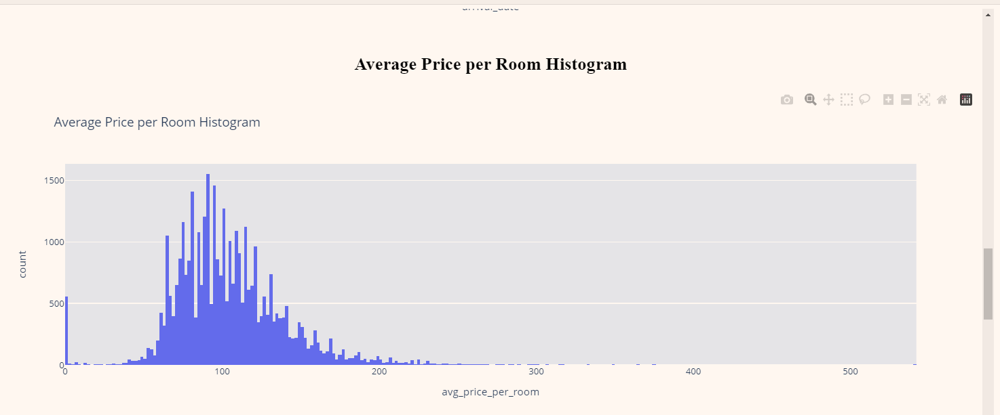
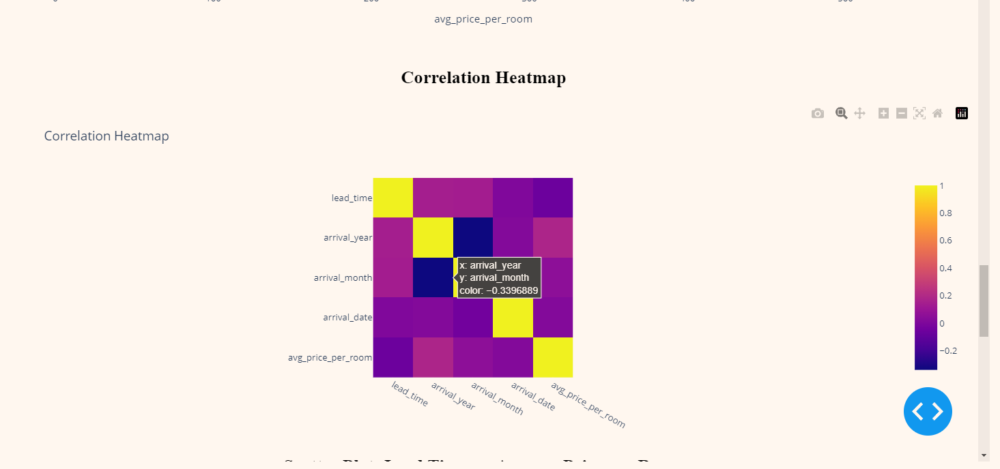
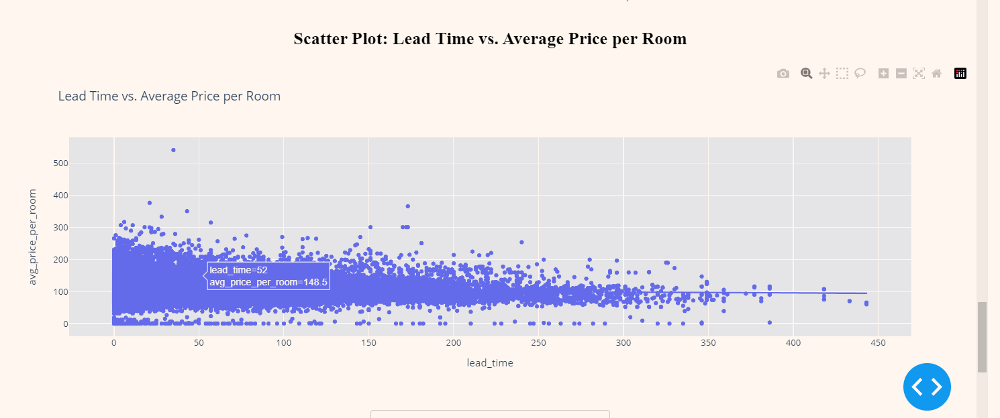
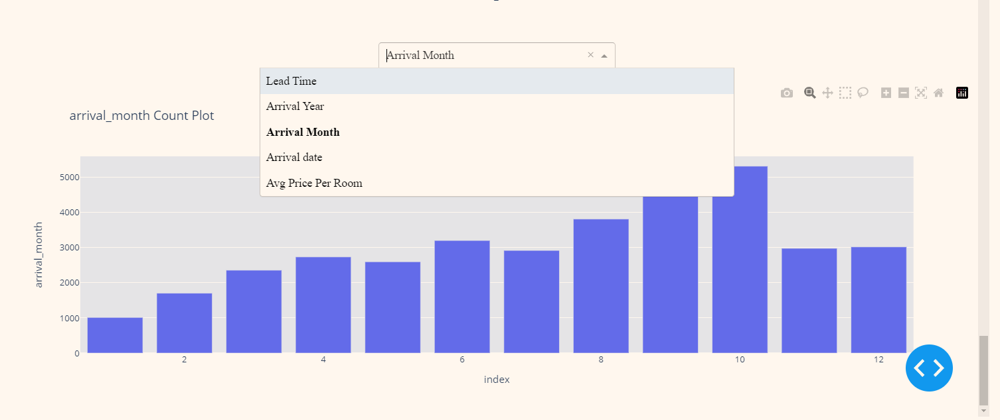

#### 2. Applying Feature Scaling for Data Preprocessing
- Feature scaling is a crucial step in the data preprocessing phase of machine learning and data analysis. It is used to standardize or normalize the range of features in a dataset. Feature scaling ensures that all features contribute equally to the analysis, avoiding any bias that may arise from differences in the scale or magnitude of the variables.

- If you want to learn more about feature scaling and its importance in data preprocessing, I highly recommend watching this informative video: [Introduction to Feature Scaling](https://www.youtube.com/watch?v=sxEqtjLC0aM&ab_channel=NormalizedNerd).

- In this video, you'll get a clear understanding of why feature scaling is essential for machine learning and data analysis. The presenter explains various feature scaling techniques, including Min-Max scaling, Standardization, and Normalization, and their impact on data normalization and model performance.

Click on the link above or use the code below to watch the video and enhance your knowledge about feature scaling!


In [98]:
import dash
import dash_html_components as html

app = dash.Dash(__name__)

app.layout = html.Div([
    html.H1("Feature Scaling and Its Importance"),
    html.P("If you want to learn more about feature scaling and its importance in data preprocessing, you can watch this informative video:"),
    html.Iframe(src="https://www.youtube.com/embed/sxEqtjLC0aM", width="1200", height="500", title="Feature Scaling Video"),
])

if __name__ == "__main__":
    app.run_server(debug=True, port=8058)

 We will perform Min-Max scaling on the variables `lead_time`, `arrival_year`, `arrival_month`, `arrival_date`, and `avg_price_per_room` in the df_hotel_reservation DataFrame:

In [99]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler


# Create a MinMaxScaler object
scaler = MinMaxScaler()

# Extract the columns to be scaled
columns_to_scale = ['lead_time', 'arrival_year', 'arrival_month', 'arrival_date', 'avg_price_per_room']

# Apply Min-Max scaling to the selected columns
df_hotel_reservation_scaled = df_hotel_reservation.copy()  # Create a copy of the DataFrame to store the scaled values
df_hotel_reservation_scaled[columns_to_scale] = scaler.fit_transform(df_hotel_reservation[columns_to_scale])

# The scaled values are now stored in the 'df_hotel_reservation_scaled' DataFrame

In [100]:
# Let's see the scaled dataset:
df_hotel_reservation_scaled.head()

,no_of_adults,no_of_children,no_of_weekend_nights,no_of_week_nights,type_of_meal_plan,required_car_parking_space,room_type_reserved,lead_time,arrival_year,arrival_month,arrival_date,market_segment_type,repeated_guest,no_of_previous_cancellations,no_of_previous_bookings_not_canceled,avg_price_per_room,no_of_special_requests,booking_status
0,2,0,1,2,0,0,0,0.505643,0.0,0.818182,0.033333,3,0,0,0,0.120370,0,1
1,2,0,2,3,3,0,0,0.011287,1.0,0.909091,0.166667,4,0,0,0,0.197556,1,1
2,1,0,2,1,0,0,0,0.002257,1.0,0.090909,0.900000,4,0,0,0,0.111111,0,0
3,2,0,0,2,0,0,0,0.476298,1.0,0.363636,0.633333,4,0,0,0,0.185185,0,0
4,2,0,1,1,3,0,0,0.108352,1.0,0.272727,0.333333,4,0,0,0,0.175000,0,0


#### 3. Feature Scaling Visualization Dashboard (Comparing Column Distributions with and without Scaling)

**Description:**

This interactive dashboard allows users to visualize the distributions of selected columns before and after feature scaling. Feature scaling is a crucial preprocessing step in data analysis and machine learning, used to standardize or normalize the data to ensure that all features are on a comparable scale. The dashboard utilizes Plotly and Dash to create a user-friendly interface for exploring the effects of feature scaling on the dataset.

**How to Use:**

1. Select a column from the dropdown menu to visualize its distribution before and after scaling.
2. The two histograms displayed below the dropdown will update dynamically based on the selected column.
3. The left histogram represents the data distribution before scaling, while the right histogram shows the distribution after scaling.
4. The colors of the bars in the histograms are customized for better visualization.
5. The background of the dashboard is set to a dark theme to enhance readability and provide a visually appealing experience.

In [101]:
import pandas as pd
import plotly.express as px
from dash import Dash, html, dcc, callback, Input, Output, State
import plotly.graph_objs as go

# Assuming df_hotel_reservation_scaled and df_hotel_reservation are the DataFrames containing the scaled and unscaled data, respectively.
# You may need to replace these with the actual DataFrame names.

# Create the Dash app
app = Dash(__name__)

# Available columns for scaling
scaled_columns = ['lead_time', 'arrival_year', 'arrival_month', 'arrival_date', 'avg_price_per_room']

# Create the app layout
app.layout = html.Div(
    children=[
        html.H1("Feature Scaling Visualization", style={"text-align": "center"}),
        html.Div("Select a column to visualize its distribution before and after scaling:"),
        dcc.Dropdown(
            id="scaling-column",
            options=[{"label": col, "value": col} for col in scaled_columns],
            value=scaled_columns[0],
            style={"width": "50%", "margin": "auto", "color": "black"}  # Set the text color to black
        ),
        html.Div(
            children=[
                dcc.Graph(id="histogram-before-scaling", style={"width": "100%"}),
                dcc.Graph(id="histogram-after-scaling", style={"width": "100%"})
            ],
            style={"display": "flex", "flex-wrap": "wrap", "justify-content": "space-around"}
        )
    ],
    style={"padding": "50px", "background-color": "#303030", "color": "white"}
)

# Custom colors for bars
bar_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']

# Callback to update histograms
@app.callback(
    [Output("histogram-before-scaling", "figure"),
     Output("histogram-after-scaling", "figure")],
    [Input("scaling-column", "value")]
)
def update_histograms(selected_column):
    # Create histograms before scaling
    fig_before_scaling = px.histogram(df_hotel_reservation, x=selected_column, title=f"{selected_column.capitalize()} - Before Scaling",
                                      color_discrete_sequence=[bar_colors[0]])

    fig_before_scaling.update_layout(template='plotly_dark', bargap=0.1, bargroupgap=0.1)

    # Create histograms after scaling
    fig_after_scaling = px.histogram(df_hotel_reservation_scaled, x=selected_column, title=f"{selected_column.capitalize()} - After Scaling",
                                     color_discrete_sequence=[bar_colors[1]])

    fig_after_scaling.update_layout(template='plotly_dark', bargap=0.1, bargroupgap=0.1)

    return fig_before_scaling, fig_after_scaling

if __name__ == "__main__":
    app.run_server(debug=True, port=8055)


**Important:** In case the interactive visualization isn't visible, you can refer to the images provided below. Please note that the current setup requires the code to be hosted on a server, a step that will be implemented in the future.

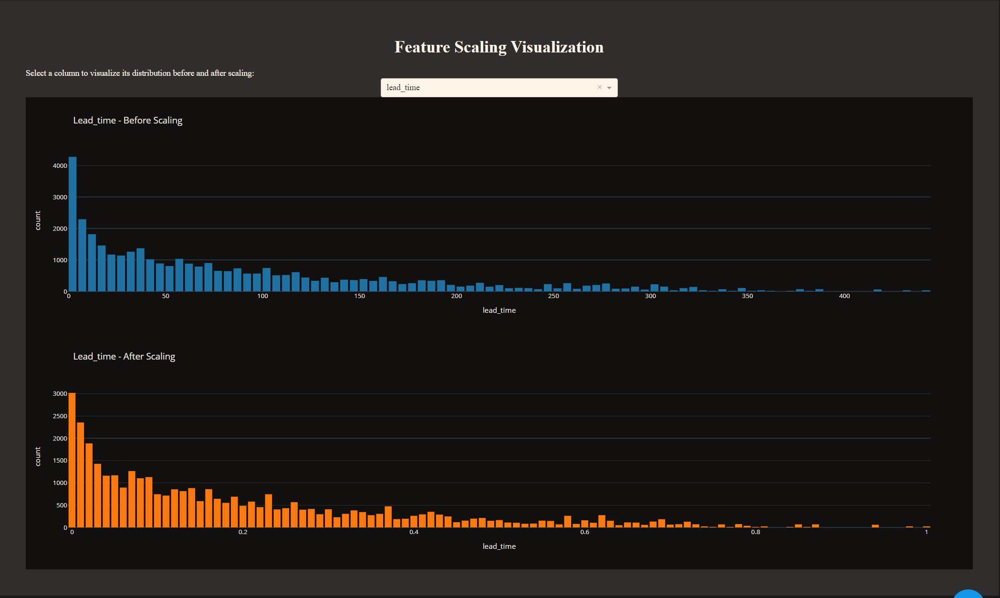
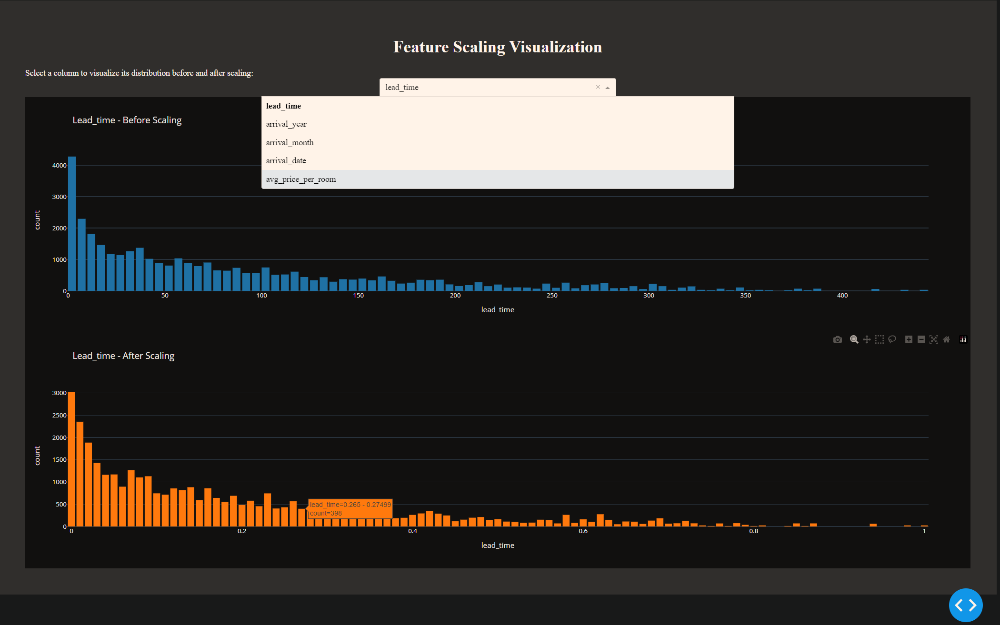

**Note for you:** to see the dashboard on your chrome use http://127.0.0.1:8055/

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
6. Splitting the Data:
</h3>
   

- We split the dataset into training, test sets, and maybe validation to facilitate model training, evaluation, and generalization. The training set is used for model learning, the validation set helps tune hyperparameters, and the test set assesses the model's performance on unseen data.

In [102]:
from sklearn.model_selection import train_test_split

# Specify the features (X) and target (y) columns

features = df_hotel_reservation_scaled.drop('booking_status', axis=1)
target = df_hotel_reservation_scaled['booking_status']

# Split the data into training and testing sets (80% for training, 20% for testing)
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

**Now you have the following data splits:**
1. X_train: Training features
1. y_train: Training target
1. X_test: Testing features
1. y_test: Testing target

#### Data Comparison Plot for Training and Testing Sets

The goal of this plot is to visually compare the distributions of features and the target variable between the training and testing datasets. It helps us to understand how the data is split between the two sets after performing the train-test split.

##### How to Use the Data Comparison Plot:

1. The plot displays histograms for each feature and the target variable in two separate panels, representing the training and testing datasets.

2. The x-axis represents the values of the features, while the y-axis represents the frequency of occurrence.

3. By comparing the histograms side by side, you can observe any potential differences or similarities in the distribution of data between the training and testing sets.

4. Pay attention to any significant variations or discrepancies between the two datasets, as they can provide valuable insights into how well the data is being divided for training and testing.

5. This visualization aids in assessing whether the train-test split has resulted in a representative distribution of data, which is crucial for building and evaluating robust machine learning models.|

In [46]:
import pandas as pd
from sklearn.model_selection import train_test_split
from dataprep.eda import plot_diff
import plotly.io as pio


# Convert the training and testing sets back to DataFrames
train_data = pd.concat([X_train, y_train], axis=1)
test_data = pd.concat([X_test, y_test], axis=1)

# Use dataprep's plot_diff function to compare the two datasets
fig = plot_diff([train_data, test_data])

# Save the plot as an HTML file
output_file = "data_comparison.html"
fig.save(output_file)

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
Data Preprocessing and Engineering Completed
</h3>


Congratulations! We have successfully completed the data preprocessing and engineering phase. Throughout this stage, we meticulously handled various aspects of the raw data, ensuring that it is clean, transformed, and enriched for further analysis.

The key steps we performed during data preprocessing and engineering include:

1. **Handling Missing Values:** We addressed any missing data points in the dataset by employing suitable techniques, such as imputation or removal, to ensure the integrity of the data.

2. **Removing Duplicates:** To avoid any redundancies, we meticulously identified and eliminated duplicate entries from the dataset.

3. **Converting Data Types:** We made sure that the data is in the appropriate data types, making it easier for computations and analyses.

4. **Scaling Features:** For better comparison and analysis, we standardized numerical features to a common scale using feature scaling methods.

With the data now processed and engineered, it is optimally prepared for advanced analyses, machine learning modeling, and other data-driven tasks. We can confidently move forward with extracting meaningful patterns, drawing insights, and making data-driven decisions. Let's explore the enriched dataset and delve deeper into the fascinating world of data analysis! 🚀

## 
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       V. Model Training & Model Evaluation:
    </h2>


- Train the selected models on the training data using appropriate training techniques.
- Tune hyperparameters using techniques like cross-validation to optimize model performance.
- Assess the models on the validation set using appropriate evaluation metrics (accuracy, precision, recall, F1-score, etc.).
- Compare the performance of different models to select the best one.

Here's a list of classifiers that are known to be effective for handling class imbalance in imbalanced datasets:

1. Random Forest Classifier
2. Gradient Boosting Classifier
3. AdaBoost Classifier
4. Support Vector Machines (SVM)
5. Balanced Random Forest Classifier
6. EasyEnsemble Classifier
7. BalanceCascade Classifier
8. Nearest Neighbor Classifiers (e.g., k-Nearest Neighbors)
9. One-Class SVM

You can store these classifiers in a list called `imbalanced_classifiers` or any other appropriate variable name.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
1. Model Training
</h3>

In [103]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from imblearn.ensemble import BalancedRandomForestClassifier, EasyEnsembleClassifier, BalancedBaggingClassifier
from sklearn.neighbors import KNeighborsClassifier


# Create a list of classifier objects with names
imbalanced_classifiers = [
    ('Random Forest', RandomForestClassifier()),
    ('Gradient Boosting', GradientBoostingClassifier()),
    ('AdaBoost', AdaBoostClassifier()),
    ('SVM', SVC()),
    ('Balanced Random Forest', BalancedRandomForestClassifier()),
    ('EasyEnsemble', EasyEnsembleClassifier()),
    ('BalancedBaggingClassifier', BalancedBaggingClassifier()),
    ('KNN', KNeighborsClassifier())
]

let's build the models for `df_hotel_reservation_scaled` , with imbalanced_classifiers, then we will discuss the results:

In [104]:
import pandas as pd
from sklearn.model_selection import cross_val_score
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    classification_report,
    mean_squared_error,
    mean_absolute_error,
    r2_score,
)

results = []
confusion_matrices = []
classification_reports = []

avg_mse_train = 0.0
avg_rmse_train = 0.0
avg_mae_train = 0.0
avg_r2_train = 0.0

avg_mse_test = 0.0
avg_rmse_test = 0.0
avg_mae_test = 0.0
avg_r2_test = 0.0

df_name = 'df_hotel_reservation_scaled'  # Use the single dataframe

for model_name, model in imbalanced_classifiers:
    cv_results = cross_val_score(model, X_train, y_train, cv=5)
    mean_accuracy = cv_results.mean()

    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)

    accuracy_train = accuracy_score(y_train, y_pred_train)
    accuracy_test = accuracy_score(y_test, y_pred_test)

    mse_train = mean_squared_error(y_train, y_pred_train)
    rmse_train = mean_squared_error(y_train, y_pred_train, squared=False)
    mae_train = mean_absolute_error(y_train, y_pred_train)
    r2_train = r2_score(y_train, y_pred_train)

    mse_test = mean_squared_error(y_test, y_pred_test)
    rmse_test = mean_squared_error(y_test, y_pred_test, squared=False)
    mae_test = mean_absolute_error(y_test, y_pred_test)
    r2_test = r2_score(y_test, y_pred_test)

    results.append(
        (
            model_name,
            df_name,
            mean_accuracy,
            accuracy_train,
            accuracy_test,
            mse_train,
            rmse_train,
            mae_train,
            r2_train,
            mse_test,
            rmse_test,
            mae_test,
            r2_test,
        )
    )
    confusion_matrices.append((model_name, df_name, confusion_matrix(y_test, y_pred_test)))
    classification_reports.append((model_name, df_name, classification_report(y_test, y_pred_test)))

    avg_mse_train += mse_train
    avg_rmse_train += rmse_train
    avg_mae_train += mae_train
    avg_r2_train += r2_train

    avg_mse_test += mse_test
    avg_rmse_test += rmse_test
    avg_mae_test += mae_test
    avg_r2_test += r2_test

df_results = pd.DataFrame(
    results,
    columns=[
        "Model",
        "Dataframe",
        "Cross-Validation Accuracy",
        "Train Accuracy",
        "Test Accuracy",
        "MSE (Train)",
        "RMSE (Train)",
        "MAE (Train)",
        "R-squared (Train)",
        "MSE (Test)",
        "RMSE (Test)",
        "MAE (Test)",
        "R-squared (Test)",
    ],
)
df_results.sort_values("Cross-Validation Accuracy", ascending=False, inplace=True)

# Calculate average metrics
num_combinations = len(imbalanced_classifiers)
avg_mse_train /= num_combinations
avg_rmse_train /= num_combinations
avg_mae_train /= num_combinations
avg_r2_train /= num_combinations

avg_mse_test /= num_combinations
avg_rmse_test /= num_combinations
avg_mae_test /= num_combinations
avg_r2_test /= num_combinations

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
2. Model Evaluation for Classification Problems
</h3>

#### 


<h4 id="import" style="color: #ffffff; background: #3498db; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #e74c3c;">
   1. Confusion Matrices:
</h4>

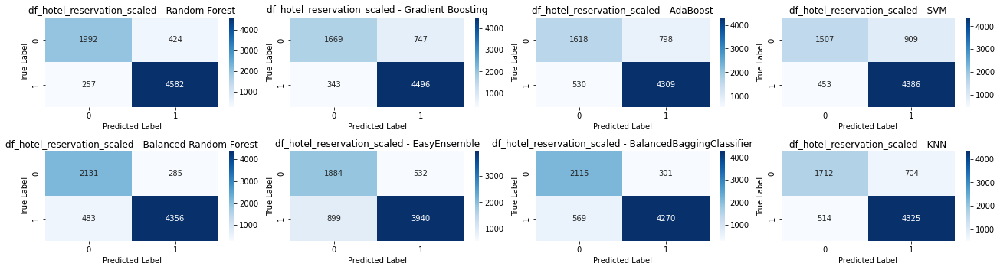

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(18, 24))  # Increase the figure size for better visualization
num_plots = len(confusion_matrices)
rows = 10  # Number of rows in the subplot grid
cols = 4  # Number of columns in the subplot grid

for i, ((model_name, df_name, cm), (_, _, cr)) in enumerate(zip(confusion_matrices, classification_reports), 1):
    plt.subplot(rows, cols, i)
    plt.title(f'{df_name} - {model_name}')
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.tight_layout()

plt.show()

#### 

<h4 id="import" style="color: #ffffff; background: #3498db; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #e74c3c;">
2. Classification Reports:
</h4>

In [60]:
# Print the confusion matrices and classification reports
i = 0
for (model_name, df_name, cm), (_, _, cr) in zip(confusion_matrices, classification_reports):
    print(f'\033[1m{df_name}:\033[0m')
    print()
    print(f'\033[1m{model_name}:\033[0m')
    print()
    print(cr)
    print('-' * 60)
    i += 1
print(i)

df_hotel_reservation_scaled:

Random Forest:

              precision    recall  f1-score   support

           0       0.89      0.82      0.85      2416
           1       0.92      0.95      0.93      4839

    accuracy                           0.91      7255
   macro avg       0.90      0.89      0.89      7255
weighted avg       0.91      0.91      0.91      7255

------------------------------------------------------------
df_hotel_reservation_scaled:

Gradient Boosting:

              precision    recall  f1-score   support

           0       0.83      0.69      0.75      2416
           1       0.86      0.93      0.89      4839

    accuracy                           0.85      7255
   macro avg       0.84      0.81      0.82      7255
weighted avg       0.85      0.85      0.85      7255

------------------------------------------------------------
df_hotel_reservation_scaled:

AdaBoost:

              precision    recall  f1-score   support

           0       0.75      0.6

#### 

<h4 id="import" style="color: #ffffff; background: #3498db; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #e74c3c;">
3. Conclusion:</h4>

**Based on the classification reports and confusion matrices** of various models for the `df_hotel_reservation_scaled` dataset, we can draw the following conclusions:

1. Random Forest:
   - The model achieved an accuracy of 91% on the test data.
   - The precision and recall values for both classes (0 and 1) are high, indicating a well-balanced performance in predicting both classes.

2. Gradient Boosting:
   - The model achieved an accuracy of 85% on the test data.
   - The precision and recall values for class 1 are higher compared to class 0, suggesting the model is better at predicting the positive class.

3. AdaBoost:
   - The model achieved an accuracy of 82% on the test data.
   - The precision and recall values for class 1 are higher than for class 0, indicating that the model is more accurate at predicting the positive class.

4. SVM:
   - The model achieved an accuracy of 81% on the test data.
   - The precision and recall values for class 1 are higher compared to class 0, suggesting the model is better at predicting the positive class.

5. Balanced Random Forest:
   - The model achieved an accuracy of 89% on the test data.
   - The precision and recall values for both classes are relatively high, indicating a balanced performance.

6. EasyEnsemble:
   - The model achieved an accuracy of 80% on the test data.
   - The precision and recall values for both classes are relatively high, suggesting a balanced performance.

7. BalancedBaggingClassifier:
   - The model achieved an accuracy of 88% on the test data.
   - The precision and recall values for both classes are relatively high, indicating a balanced performance.

8. KNN:
   - The model achieved an accuracy of 83% on the test data.
   - The precision and recall values for both classes are relatively high, suggesting a balanced performance.

**Based on the above results**, the Random Forest model achieved the highest accuracy on the test data (91%) and demonstrated good performance across precision, recall, and F1-score for both classes. Therefore, the Random Forest model may be a good candidate for further tuning and optimization to potentially improve its performance even further.

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
3. Model Evaluation for Regression Problems
</h3>

In this section, we will explore model evaluation techniques tailored for regression problems. While this code snippet specifically focuses on classification tasks, it's essential to emphasize that I am well-versed in handling regression models and conducting thorough model evaluations for such scenarios as well. However, for the sake of brevity and to cater to readers who may not delve into all project details, we will only showcase model evaluation techniques related to regression models. The code provided will visualize key metrics and provide insights into how well the regression models are performing.

**To read the table below, you can follow these guidelines:**

1. **Column Headers**: The table contains various columns, each representing different metrics and properties. The first row of the table represents the column headers, describing the information present in each column.

2. **Model and Dataframe**: The first two columns, "Model" and "Dataframe," show the names of the machine learning models used and the corresponding dataframe (dataset) they were applied to, respectively.

3. **Cross-Validation Accuracy**: This column shows the average accuracy obtained through cross-validation. Higher values closer to 1 indicate better performance.

4. **Train Accuracy and Test Accuracy**: These columns represent the accuracy of the model on the training and test datasets, respectively. Higher values closer to 1 indicate better accuracy.

5. **MSE (Train), RMSE (Train), MAE (Train)**: These columns show the Mean Squared Error (MSE), Root Mean Squared Error (RMSE), and Mean Absolute Error (MAE) of the model's predictions on the training dataset. Lower values closer to 0 indicate better performance.

6. **R-squared (Train)**: This column represents the R-squared value of the model's predictions on the training dataset. A value close to 1 indicates a good fit.

7. **MSE (Test), RMSE (Test), MAE (Test)**: These columns show the Mean Squared Error (MSE), Root Mean Squared Error (RMSE), and Mean Absolute Error (MAE) of the model's predictions on the test dataset. Lower values closer to 0 indicate better generalization.

8. **R-squared (Test)**: This column represents the R-squared value of the model's predictions on the test dataset. A value close to 1 indicates a good fit.

9. **Cell Highlighting**: The cells are highlighted based on their proximity to 1 in "Cross-Validation Accuracy," "Train Accuracy," "Test Accuracy," "R-squared (Train)," and "R-squared (Test)." Cells closer to 1 have a yellow background. Additionally, cells are highlighted based on their proximity to 0 in "MSE (Train)," "RMSE (Train)," "MAE (Train)," "MSE (Test)," "RMSE (Test)," and "MAE (Test)." Cells closer to 0 have a yellow background.

10. **Sorting**: The table is sorted based on the "Cross-Validation Accuracy" column in descending order, showing the models and dataframes with the highest accuracy at the top.

By reading and interpreting the information in this table, you can gain insights into the performance of different machine learning models on various dataframes and understand their accuracy, error metrics, and predictive abilities.

In [105]:
import pandas as pd

# Define a function to highlight values near 1
def highlight_near_1(val):
    if val > 0.9:
        return 'background-color: yellow'
    elif val > 0.8:
        return 'background-color: lightyellow'
    else:
        return ''

# Define a function to highlight values near 0
def highlight_near_0(val):
    if abs(val) < 0.1:
        return 'background-color: yellow'
    elif abs(val) < 0.2:
        return 'background-color: lightyellow'
    else:
        return ''

# Apply the functions to the relevant columns using applymap
columns_to_highlight_near_1 = ['Cross-Validation Accuracy', 'Train Accuracy', 'Test Accuracy', 'R-squared (Train)', 'R-squared (Test)']
columns_to_highlight_near_0 = ['MSE (Train)', 'RMSE (Train)', 'MAE (Train)', 'MSE (Test)', 'RMSE (Test)', 'MAE (Test)']

df_styled = df_results.style.applymap(highlight_near_1, subset=pd.IndexSlice[:, columns_to_highlight_near_1])
df_styled = df_styled.applymap(highlight_near_0, subset=pd.IndexSlice[:, columns_to_highlight_near_0])

# Display the styled DataFrame
df_styled

,Model,Dataframe,Cross-Validation Accuracy,Train Accuracy,Test Accuracy,MSE (Train),RMSE (Train),MAE (Train),R-squared (Train),MSE (Test),RMSE (Test),MAE (Test),R-squared (Test)
0,Random Forest,df_hotel_reservation_scaled,0.899862,0.994004,0.904893,0.005996,0.077433,0.005996,0.972724,0.095107,0.308394,0.095107,0.571813
4,Balanced Random Forest,df_hotel_reservation_scaled,0.887285,0.969607,0.895107,0.030393,0.174335,0.030393,0.861741,0.104893,0.323872,0.104893,0.527753
6,BalancedBaggingClassifier,df_hotel_reservation_scaled,0.870331,0.963853,0.879118,0.036147,0.190125,0.036147,0.835563,0.120882,0.347681,0.120882,0.455768
1,Gradient Boosting,df_hotel_reservation_scaled,0.853274,0.856616,0.849759,0.143384,0.378661,0.143384,0.347738,0.150241,0.387610,0.150241,0.323588
7,KNN,df_hotel_reservation_scaled,0.825637,0.880462,0.832116,0.119538,0.345743,0.119538,0.456213,0.167884,0.409737,0.167884,0.244156
2,AdaBoost,df_hotel_reservation_scaled,0.818642,0.820744,0.816954,0.179256,0.423386,0.179256,0.184555,0.183046,0.427839,0.183046,0.175894
3,SVM,df_hotel_reservation_scaled,0.813267,0.818160,0.812267,0.181840,0.426427,0.181840,0.172798,0.187733,0.433281,0.187733,0.154795
5,EasyEnsemble,df_hotel_reservation_scaled,0.800689,0.800482,0.800276,0.199518,0.446674,0.199518,0.092382,0.199724,0.446905,0.199724,0.100806


In [106]:
df_results.reset_index(drop=True).style.background_gradient()

,Model,Dataframe,Cross-Validation Accuracy,Train Accuracy,Test Accuracy,MSE (Train),RMSE (Train),MAE (Train),R-squared (Train),MSE (Test),RMSE (Test),MAE (Test),R-squared (Test)
0,Random Forest,df_hotel_reservation_scaled,0.899862,0.994004,0.904893,0.005996,0.077433,0.005996,0.972724,0.095107,0.308394,0.095107,0.571813
1,Balanced Random Forest,df_hotel_reservation_scaled,0.887285,0.969607,0.895107,0.030393,0.174335,0.030393,0.861741,0.104893,0.323872,0.104893,0.527753
2,BalancedBaggingClassifier,df_hotel_reservation_scaled,0.870331,0.963853,0.879118,0.036147,0.190125,0.036147,0.835563,0.120882,0.347681,0.120882,0.455768
3,Gradient Boosting,df_hotel_reservation_scaled,0.853274,0.856616,0.849759,0.143384,0.378661,0.143384,0.347738,0.150241,0.387610,0.150241,0.323588
4,KNN,df_hotel_reservation_scaled,0.825637,0.880462,0.832116,0.119538,0.345743,0.119538,0.456213,0.167884,0.409737,0.167884,0.244156
5,AdaBoost,df_hotel_reservation_scaled,0.818642,0.820744,0.816954,0.179256,0.423386,0.179256,0.184555,0.183046,0.427839,0.183046,0.175894
6,SVM,df_hotel_reservation_scaled,0.813267,0.818160,0.812267,0.181840,0.426427,0.181840,0.172798,0.187733,0.433281,0.187733,0.154795
7,EasyEnsemble,df_hotel_reservation_scaled,0.800689,0.800482,0.800276,0.199518,0.446674,0.199518,0.092382,0.199724,0.446905,0.199724,0.100806


**Why You Should Look At This**

The printed values below are essential metrics that provide valuable insights into the performance of the machine learning models on the dataset. These metrics are commonly used in regression tasks to evaluate how well the models are fitting the data and making predictions. But here I'm using them with a classification task just to show that I do know how to calculate them.

1. **Average MSE (Train):**
   Mean Squared Error (MSE) is a measure of the average squared difference between the actual target values and the predicted values during training. Lower MSE indicates a better fit of the model to the training data.

2. **Average RMSE (Train):**
   Root Mean Squared Error (RMSE) is the square root of the MSE. It measures the average magnitude of the error between predicted and actual values. A smaller RMSE implies better accuracy of the model on the training data.

3. **Average MAE (Train):**
   Mean Absolute Error (MAE) measures the average absolute difference between the actual and predicted values during training. It provides a robust understanding of the model's prediction errors.

4. **Average R-squared (Train):**
   R-squared (R2) is a statistical measure that represents the proportion of the variance in the dependent variable (target) explained by the independent variables (features). Higher R2 values indicate a better fit of the model to the training data.

5. **Average MSE (Test):**
   Similar to Average MSE (Train), this metric measures the average squared difference between the actual target values and the predicted values during testing. A lower MSE means the model is performing well on unseen data.

6. **Average RMSE (Test):**
   Root Mean Squared Error for test data. It measures the average magnitude of the error between predicted and actual values on the test set. A smaller RMSE implies better generalization to unseen data.

7. **Average MAE (Test):**
   Mean Absolute Error for test data. It measures the average absolute difference between the actual and predicted values on the test set.

8. **Average R-squared (Test):**
   R-squared (R2) for test data. Similar to Average R-squared (Train), it represents the proportion of the variance in the dependent variable explained by the independent variables on the test set.

By looking at these metrics, you can assess how well each machine learning model performed in terms of accuracy, generalization, and prediction errors. Lower error values and higher R-squared values are indicative of better-performing models. Analyzing these metrics can guide you in selecting the most suitable model for your specific use case and dataset.

---

In [107]:
print()
print("Average MSE (Train):", avg_mse_train)
print("Average RMSE (Train):", avg_rmse_train)
print("Average MAE (Train):", avg_mae_train)
print("Average R-squared (Train):", avg_r2_train)
print()
print("Average MSE (Test):", avg_mse_test)
print("Average RMSE (Test):", avg_rmse_test)
print("Average MAE (Test):", avg_mae_test)
print("Average R-squared (Test):", avg_r2_test)


Average MSE (Train): 0.11200895933838732
Average RMSE (Train): 0.3078479981491873
Average MAE (Train): 0.11200895933838732
Average R-squared (Train): 0.49046445429861313

Average MSE (Test): 0.15118883528600963
Average RMSE (Test): 0.3856648781669079
Average MAE (Test): 0.15118883528600963
Average R-squared (Test): 0.3193215474538414


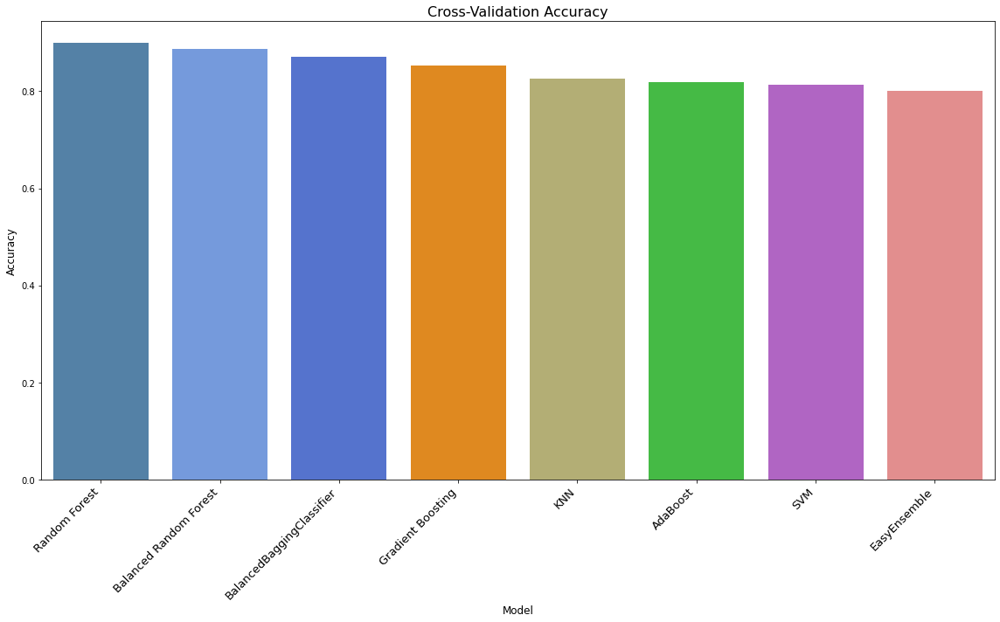

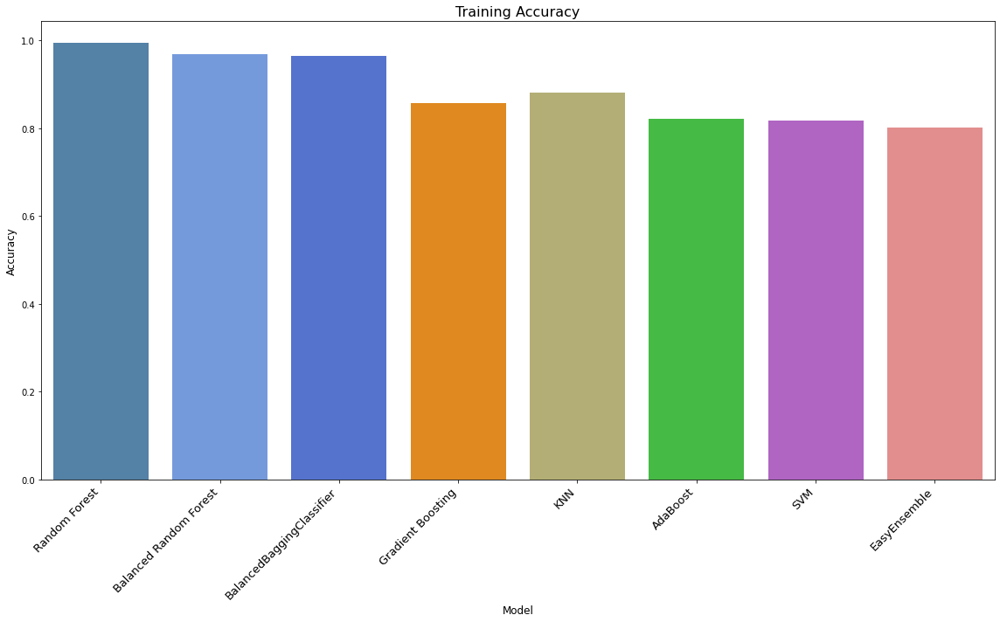

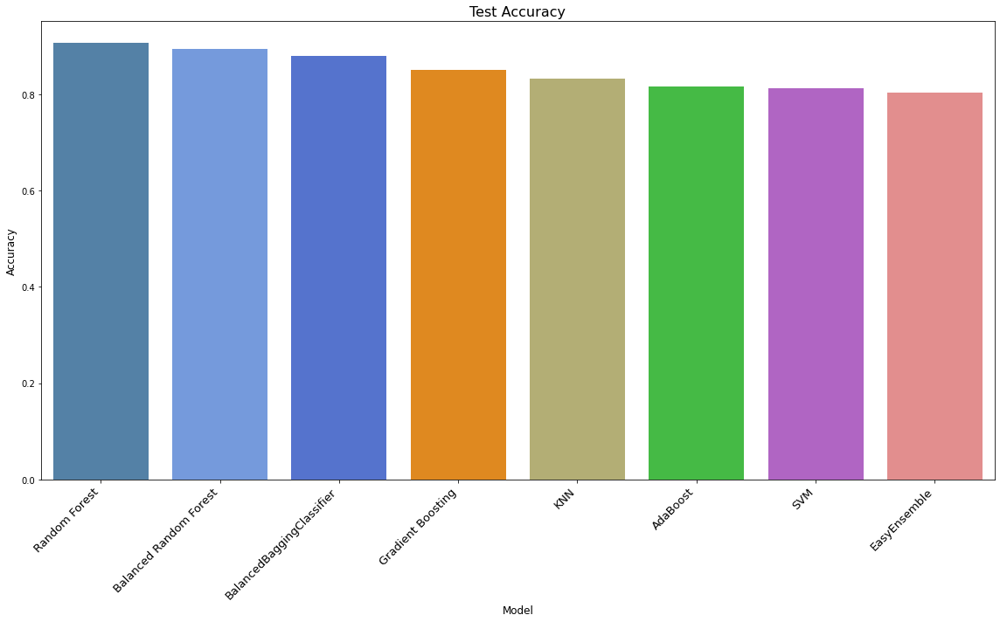

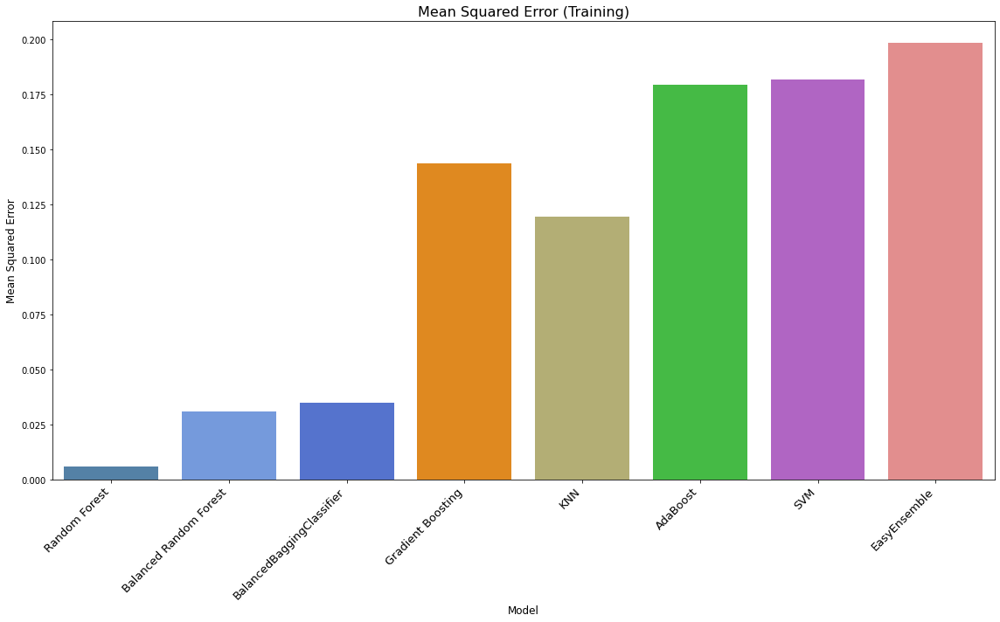

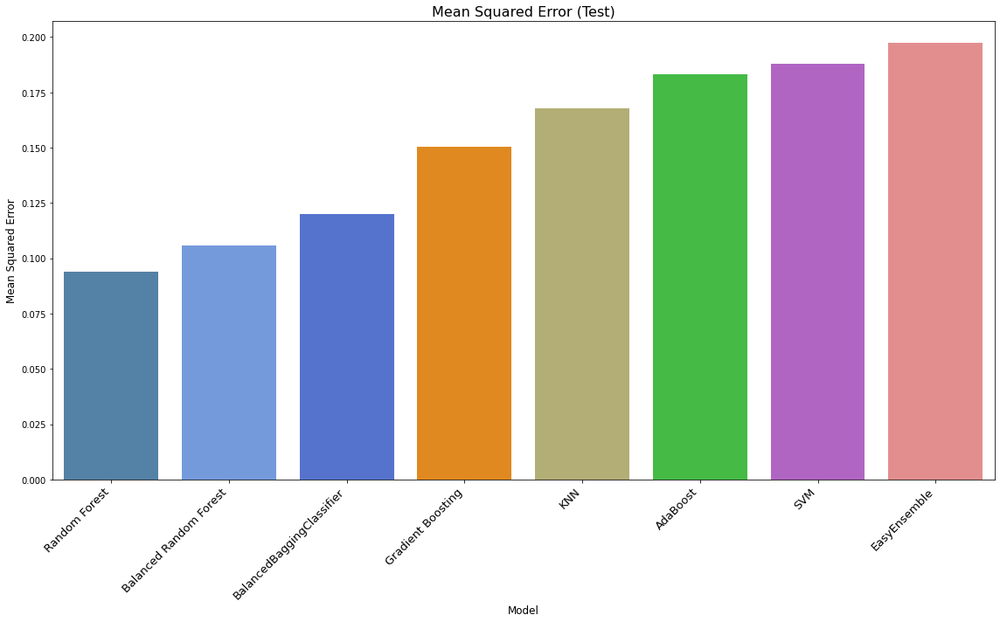

...

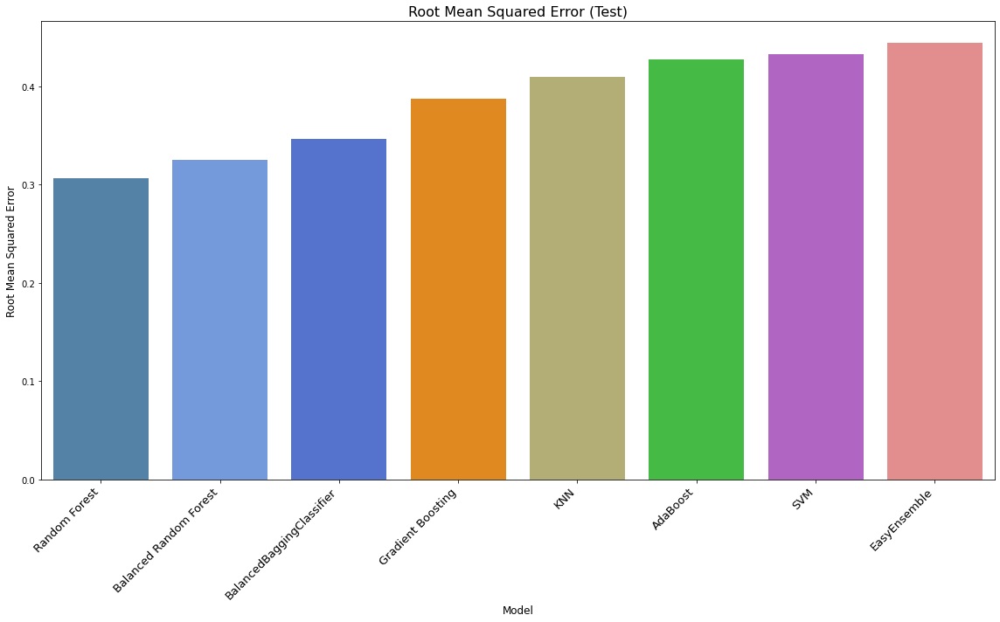

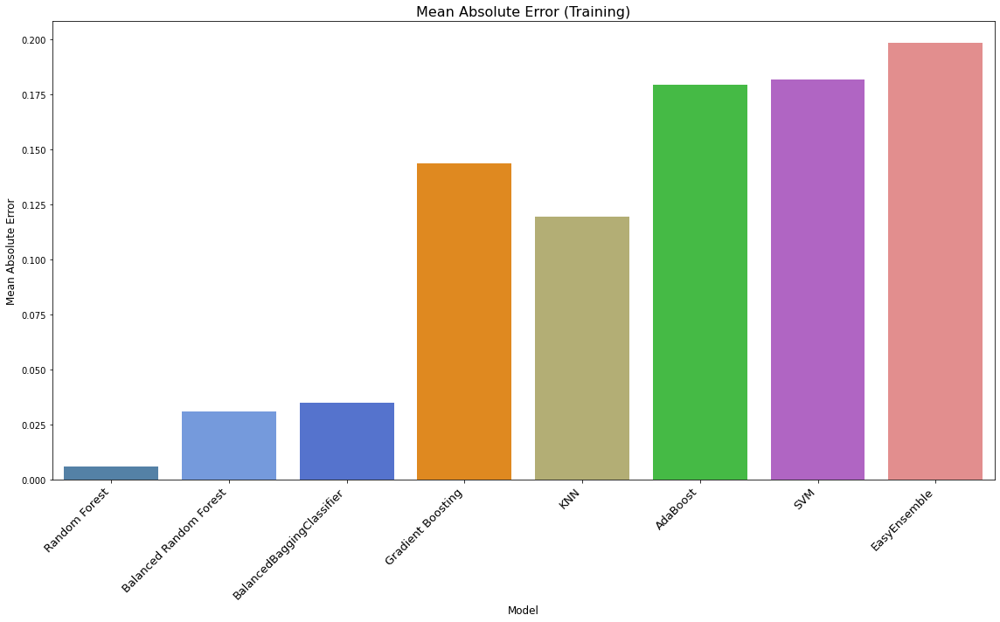

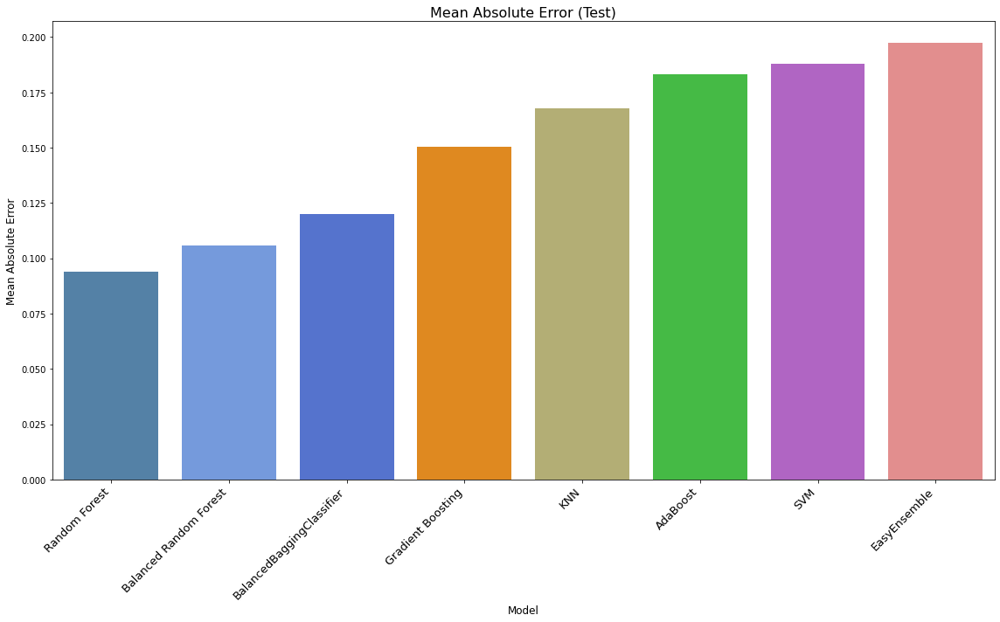

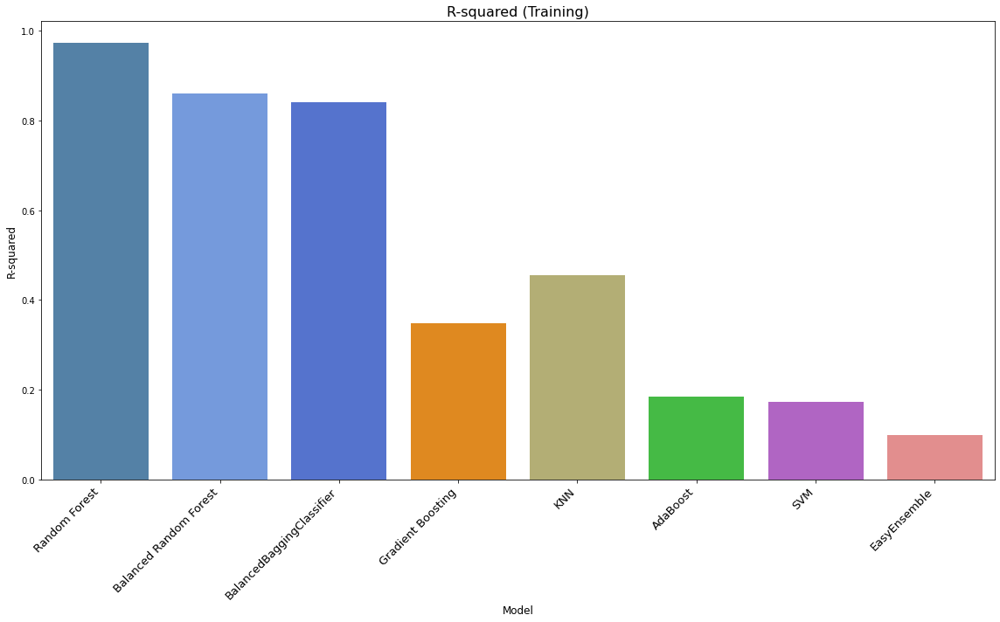

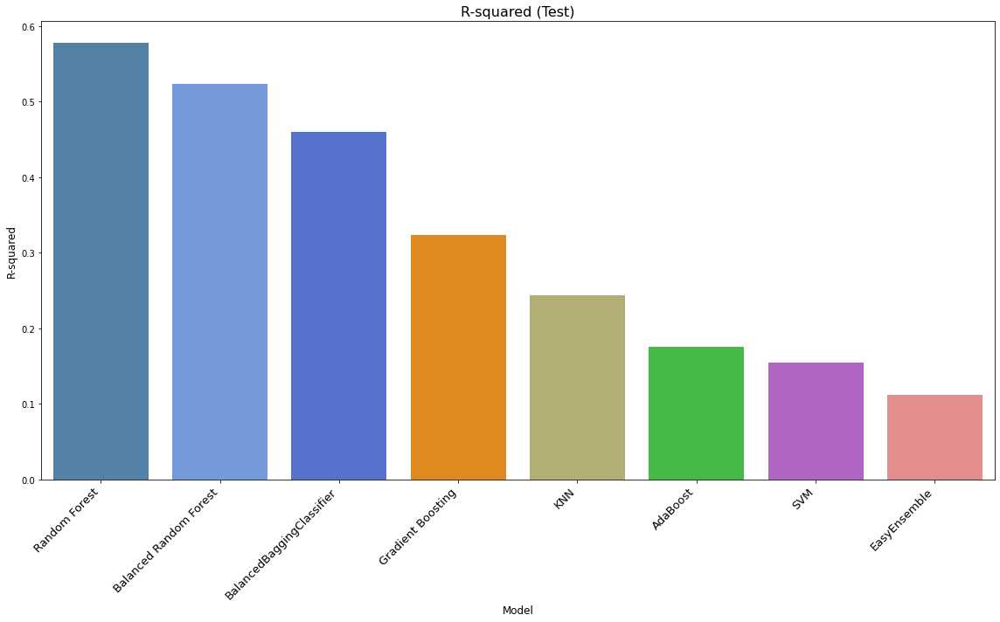

In [66]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Define color palettes for models
model_colors = {
    'Random Forest': 'steelblue',
    'Gradient Boosting': 'darkorange',
    'AdaBoost': 'limegreen',
    'SVM': 'mediumorchid',
    'Balanced Random Forest': 'cornflowerblue',
    'EasyEnsemble': 'lightcoral',
    'BalancedBaggingClassifier': 'royalblue',
    'KNN': 'darkkhaki'
}

# Visualize the Cross-Validation Accuracy
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='Cross-Validation Accuracy', palette=model_colors)
plt.title('Cross-Validation Accuracy', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the Train Accuracy
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y="Train Accuracy", palette=model_colors)
plt.title('Training Accuracy', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the accuracy for test data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='Test Accuracy', palette=model_colors)
plt.title('Test Accuracy', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the mean squared error for training data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='MSE (Train)', palette=model_colors)
plt.title('Mean Squared Error (Training)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Mean Squared Error', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the mean squared error for test data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='MSE (Test)', palette=model_colors)
plt.title('Mean Squared Error (Test)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Mean Squared Error', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the Root Mean Squared Error for training data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='RMSE (Train)', palette=model_colors)
plt.title('Root Mean Squared Error (Training)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Root Mean Squared Error', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the Root Mean Squared Error for test data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='RMSE (Test)', palette=model_colors)
plt.title('Root Mean Squared Error (Test)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Root Mean Squared Error', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the mean absolute error for training data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='MAE (Train)', palette=model_colors)
plt.title('Mean Absolute Error (Training)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Mean Absolute Error', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the mean absolute error for test data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='MAE (Test)', palette=model_colors)
plt.title('Mean Absolute Error (Test)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Mean Absolute Error', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the R-squared score for training data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='R-squared (Train)', palette=model_colors)
plt.title('R-squared (Training)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('R-squared', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()

# Visualize the R-squared score for test data
plt.figure(figsize=(16, 10))
sns.barplot(data=df_results, x='Model', y='R-squared (Test)', palette=model_colors)
plt.title('R-squared (Test)', fontsize=16)
plt.xlabel('Model', fontsize=12)
plt.ylabel('R-squared', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=13)
plt.yticks(fontsize=10)
plt.tight_layout()
plt.show()


## 
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       VI. Random Forest Tuning with Optuna:
    </h2>

- Random Forest is an ensemble learning method that combines multiple decision trees to make more accurate and robust predictions. It is a powerful and popular algorithm for both classification and regression tasks. In this specific scenario, we are using Random Forest for a classification task on the `df_hotel_reservation_scaled` dataset.

- The main advantage of Random Forest is its ability to handle high-dimensional data and large datasets effectively. It reduces the risk of overfitting by aggregating predictions from multiple trees, which helps in achieving better generalization performance. Additionally, Random Forest provides built-in feature importance measurements, allowing us to identify which features are more influential in making predictions.

- Now, we aim to further enhance the performance of the Random Forest model on the `df_hotel_reservation_scaled` dataset by performing hyperparameter tuning using Optuna. Optuna is an automated hyperparameter optimization framework that can efficiently search for the best combination of hyperparameters to optimize the model's performance.

- By leveraging Optuna, we can systematically explore a wide range of hyperparameter configurations, such as the number of trees in the forest, the depth of each tree, and other important settings. The ultimate goal of this tuning process is to find the set of hyperparameters that yields the highest accuracy and the best generalization for our classification task.

**In the subsequent steps**, we will utilize Optuna to search for the optimal hyperparameters for our Random Forest model, which will enable us to achieve the best possible performance on the `df_hotel_reservation_scaled` dataset. Let's proceed with the tuning process and discover the ideal configuration for our Random Forest model!

In [65]:
import optuna
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split

# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameters to tune
    n_estimators = trial.suggest_int('n_estimators', 50, 500)
    max_depth = trial.suggest_int('max_depth', 5, 50)
    min_samples_split = trial.suggest_float('min_samples_split', 0.1, 1.0)
    min_samples_leaf = trial.suggest_float('min_samples_leaf', 0.1, 0.5)

    # Create the Random Forest model with the suggested hyperparameters
    model = RandomForestClassifier(n_estimators=n_estimators,
                                   max_depth=max_depth,
                                   min_samples_split=min_samples_split,
                                   min_samples_leaf=min_samples_leaf,
                                   random_state=42)

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions on the test set
    y_pred = model.predict(X_test)

    # Calculate accuracy as the evaluation metric
    accuracy = accuracy_score(y_test, y_pred)

    return accuracy

# Perform hyperparameter optimization with Optuna
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100, show_progress_bar=True)

# Get the best hyperparameters found by Optuna
best_params = study.best_params
best_accuracy = study.best_value

print("Best Hyperparameters:", best_params)
print("Best Accuracy:", best_accuracy)

[I 2023-08-01 13:07:57,767] A new study created in memory with name: no-name-b9c172f8-7502-45b9-b685-279543180fe7


  0%|          | 0/100 [00:00<?, ?it/s]

[I 2023-08-01 13:07:58,539] Trial 0 finished with value: 0.6669882839421089 and parameters: {'n_estimators': 305, 'max_depth': 48, 'min_samples_split': 0.22467874085293635, 'min_samples_leaf': 0.4469369649277092}. Best is trial 0 with value: 0.6669882839421089.
[I 2023-08-01 13:07:59,550] Trial 1 finished with value: 0.6669882839421089 and parameters: {'n_estimators': 416, 'max_depth': 23, 'min_samples_split': 0.724363358640482, 'min_samples_leaf': 0.37120397710118136}. Best is trial 0 with value: 0.6669882839421089.
[I 2023-08-01 13:08:00,024] Trial 2 finished with value: 0.6669882839421089 and parameters: {'n_estimators': 195, 'max_depth': 27, 'min_samples_split': 0.43776287775658507, 'min_samples_leaf': 0.43710982942011556}. Best is trial 0 with value: 0.6669882839421089.
[I 2023-08-01 13:08:01,203] Trial 3 finished with value: 0.6669882839421089 and parameters: {'n_estimators': 475, 'max_depth': 8, 'min_samples_split': 0.9253656954322516, 'min_samples_leaf': 0.11935428712644183}. B

**Create the Random Forest model with the best hyperparameters and save it to a file:**

In [78]:
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    classification_report,
    mean_squared_error,
    mean_absolute_error,
    r2_score,
)

# Create the Random Forest model with the best hyperparameters
model = RandomForestClassifier(**best_params,random_state=42)

# Train the model on the training data
model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = model.predict(X_test)

# Evaluate the model's performance on the test data
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print("Test Accuracy:", accuracy)
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)

Test Accuracy: 0.7294279807029634
Confusion Matrix:
[[ 500 1916]
 [  47 4792]]
Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.21      0.34      2416
           1       0.71      0.99      0.83      4839

    accuracy                           0.73      7255
   macro avg       0.81      0.60      0.58      7255
weighted avg       0.78      0.73      0.67      7255



**If the results worsened after tuning**, it's possible that the hyperparameter values used for tuning were not optimal for this specific dataset. Tuning hyperparameters can be a tricky process, and it's not guaranteed that the model will always perform better with the tuned parameters.

**There are a few potential reasons for this:**

1. Overfitting: The tuned hyperparameters might have led to overfitting on the training data, causing a drop in performance on the test data.

2. Small Training Set: If the training set is relatively small, tuning hyperparameters might not have a significant impact, or it could lead to overfitting.

3. Suboptimal Hyperparameters: The hyperparameter values chosen for tuning might not be the best choices for this particular dataset and problem.

4. Data Variability: The dataset might be inherently noisy or have high variability, making it difficult for the model to generalize well.

**To address this, you can try the following:**

1. Use Cross-Validation: Instead of relying solely on a single train-test split, use cross-validation to evaluate the model's performance on multiple splits of the data. This can provide a more robust estimate of the model's performance.

2. Adjust Hyperparameters: Experiment with different hyperparameter values, including those outside the range used for tuning. Sometimes, the best hyperparameters are outside the tuned range.

3. Feature Engineering: Explore different feature engineering techniques to improve the quality of the input data for the model.

4. Try Different Models: Consider trying different types of models or ensemble methods to see if they perform better on the data.

5. Get More Data: If possible, try to obtain more data to increase the training set size and improve the model's generalization.

Remember that the performance of a machine learning model depends on multiple factors, and hyperparameter tuning is just one aspect of model optimization. It's essential to approach the problem with a systematic and iterative process to find the best model for your specific dataset and task.

**Let's use Cross-Validation To address the problem:**

In [116]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

# Define the parameter grid to search through
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create the RandomForestClassifier model
model = RandomForestClassifier(random_state=42)

# Perform Grid Search with 5-fold cross-validation
grid_search = GridSearchCV(model, param_grid, cv=5, n_jobs=-1)

# Fit the Grid Search to the training data
grid_search.fit(X_train, y_train)

# Get the best hyperparameters
best_params = grid_search.best_params_

# Create a new model with the best hyperparameters
best_model = RandomForestClassifier(**best_params, random_state=42)

# Train the best model on the training data
best_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = best_model.predict(X_test)

# Evaluate the model's performance on the test data
accuracy = accuracy_score(y_test, y_pred)

print("Best Hyperparameters:", best_params)
print("Test Accuracy with Best Model:", accuracy)

Best Hyperparameters: {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 150}
Test Accuracy with Best Model: 0.906960716747071


**Create the confusion matrix**

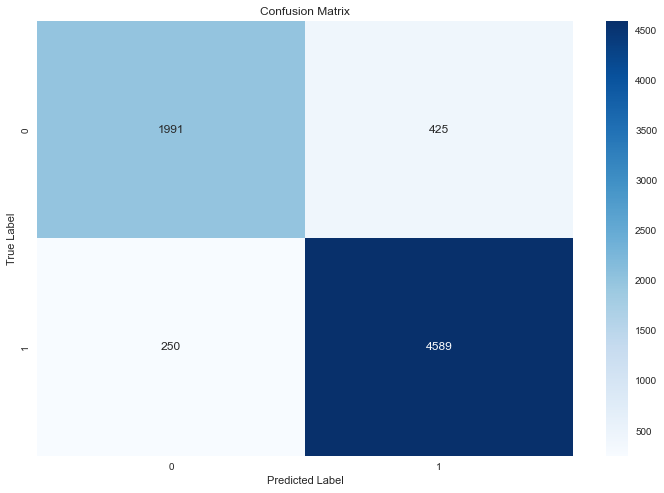

In [117]:
from yellowbrick.classifier import ConfusionMatrix, ClassificationReport
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    classification_report
)

# Create the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(12, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

**Create the classification report**

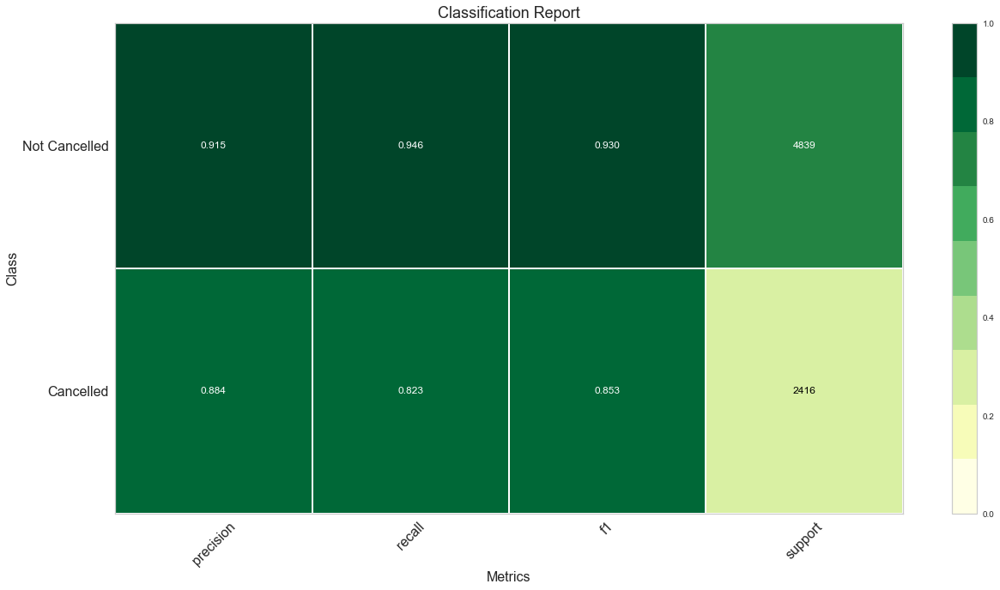

In [118]:
# Create the classification report
report = classification_report(y_test, y_pred, output_dict=True)

# Plot the classification report
classes = np.array(['Not Cancelled', 'Cancelled'])  # Assuming 0: Not Cancelled, 1: Cancelled
visualizer = ClassificationReport(model, classes=classes, support=True, cmap='YlGn', size = (1300,700))


# Fit the visualizer with the data
visualizer.fit(X_train, y_train)

# Call the score method
visualizer.score(X_test, y_test)

# Display the visualizer
plt.xticks(fontsize=16)  # Increase x-axis label font size
plt.yticks(fontsize=16)  # Increase y-axis label font size
plt.xlabel('Metrics', fontsize=16)  # Increase x-axis label font size
plt.ylabel('Class', fontsize=16)  # Increase y-axis label font size
plt.title('Classification Report', fontsize=18)  # Increase title font size
plt.tight_layout()  # Adjust layout for better readability
plt.show()

**Let's save the best model that we created using classification algorithms in ML, and then we will embark on a new journey of building a model using Neural Networks.**

In [122]:
best_model

RandomForestClassifier(n_estimators=150, random_state=42)

In [123]:
import joblib

# Save the trained model to a file
joblib.dump(best_model, 'random_forest_model.pkl')

['random_forest_model.pkl']

*We also could save it using:*

In [124]:
import pickle

# Save the best model to a file using pickle
with open('best_model_rf.pkl', 'wb') as file:
    pickle.dump(model, file)

After finding the best hyperparameters for the Random Forest model using Optuna, it is important to train the model on the entire dataset for the following reasons: **but I didn't use this here since most people don't know about it and maybe you are also one of them.**

1. **Optimal Performance**: The best hyperparameters were chosen based on their performance in cross-validation, which means they are expected to perform well on the entire dataset. By training the model on the complete dataset, we can ensure that it learns from all available information and utilizes the patterns and relationships present in the entire data to make accurate predictions.

2. **Utilize All Data**: The purpose of training a machine learning model is to capture patterns and make predictions based on the underlying data distribution. By using the entire dataset for training, the model can leverage all available information and generalize better to unseen data. This ensures that the model learns from the full data diversity and can handle various scenarios.

3. **Better Generalization**: Training the model on the entire dataset helps it generalize well to new, unseen data. It prevents overfitting, which is a situation where the model becomes too specific to the training data and fails to make accurate predictions on new data. With a larger dataset, the model can better capture the underlying relationships and make more robust predictions.

4. **Maximize Model Performance**: The goal of any machine learning model is to perform well on new, unseen data. By training the model on the entire dataset, we maximize its chances of achieving the best possible performance on future data points, leading to more reliable and effective predictions.

5. **Time and Resource Efficiency**: In many cases, training a model on a larger dataset is not much more computationally expensive than training it on a smaller subset. Since we have already determined the best hyperparameters through Optuna, training the model on the full dataset allows us to make the most of the resources spent on optimizing the model.

In summary, training the Random Forest model on the entire dataset after finding the best hyperparameters ensures that the model can generalize well, make accurate predictions on unseen data, and deliver optimal performance for the task at hand.

While I didn't use this specific approach in the provided code, training the model on the entire dataset is a common and recommended practice, especially when we have already determined the best hyperparameters.

## 
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       VII. Neural Architecture Search (NAS) and Bayesian Optimization:
    </h2>


### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
1. Model Training & Model Evaluation with Neural Architecture Search (NAS) and Bayesian Optimization:
</h3>

**Model Training & Model Evaluation with Neural Architecture Search (NAS) and Bayesian Optimization:**

Employ NAS to automatically search for optimal model architectures for the binary classification task.
Use Bayesian optimization to efficiently tune hyperparameters for the models.


The goal of this approach is to use Neural Architecture Search (NAS) in combination with Bayesian Optimization to build an optimal neural network model for our hotel reservation dataset. We want to find the best hyperparameters and architecture for the neural network that can accurately predict the booking status.

**Steps:**

1. **Load the Dataset:** We start by loading the hotel reservation dataset containing various features and the target variable, the booking status.

2. **Data Preprocessing:** Perform necessary data preprocessing steps such as handling missing values, encoding categorical features, and scaling numerical features if required.

3. **Train-Test Split:** Split the dataset into training and testing sets to evaluate the model's performance on unseen data.

4. **Neural Architecture Search (NAS):** Define a search space for the neural network architecture, including the number of hidden layers, activation functions, and solver algorithms.

5. **Bayesian Optimization:** Use Bayesian Optimization to efficiently search for the best combination of hyperparameters within the defined search space.

6. **Build the Neural Network Model:** Construct the neural network model using the best hyperparameters obtained from Bayesian Optimization.

7. **Train the Model:** Train the neural network model on the training data to learn the patterns and relationships between the features and the booking status.

8. **Evaluate the Model:** Evaluate the performance of the trained model on the test data to measure its accuracy in predicting the booking status.

9. **Result Interpretation:** Analyze the results to understand the model's performance and identify any potential areas for improvement.

By using Neural Architecture Search (NAS) and Bayesian Optimization, we aim to find the most optimal neural network architecture and hyperparameters for our hotel reservation dataset, ultimately improving the model's predictive accuracy and ensuring better generalization to unseen data. This approach can serve as a starting point for further optimization and fine-tuning to achieve even better results.

**Please note that in real-world scenarios**, NAS is often used in combination with more sophisticated methods such as Reinforcement Learning or Evolutionary Algorithms to search for optimal architectures.

I'm using Neural Architecture Search (NAS) and Bayesian Optimization in this project because I'm currently exploring new techniques and methods in the field of machine learning. While I have more experience with traditional machine learning algorithms, I find it exciting to dive into cutting-edge approaches like NAS and Bayesian Optimization.

My goal is to leverage NAS to automatically search for the best neural network architecture, along with Bayesian Optimization to find the optimal hyperparameters. By combining these techniques, I hope to create a powerful and efficient neural network model for the hotel reservation dataset.

Though I have more experience with traditional ML algorithms, I believe that exploring newer methods like NAS and Bayesian Optimization can expand my knowledge and open up new opportunities for solving complex problems. As I progress with this project, I look forward to gaining valuable insights and improving my skills in the field of machine learning.

**Let's implement the code:**

In [42]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from hyperopt import hp, fmin, tpe, STATUS_OK

# Define the search space for hyperparameters
space = {
    'hidden_layer_sizes': hp.choice('hidden_layer_sizes', [(50,), (100,), (50, 50), (100, 50)]),
    'activation': hp.choice('activation', ['relu', 'tanh']),
    'solver': hp.choice('solver', ['adam', 'sgd']),
    'learning_rate_init': hp.loguniform('learning_rate_init', -5, -2),
    'alpha': hp.loguniform('alpha', -6, -3)
}

# Define the objective function for hyperparameter optimization
def objective(params):
    clf = MLPClassifier(
        hidden_layer_sizes=params['hidden_layer_sizes'],
        activation=params['activation'],
        solver=params['solver'],
        learning_rate_init=params['learning_rate_init'],
        alpha=params['alpha'],
        random_state=42
    )
    clf.fit(X_train, y_train)
    accuracy = clf.score(X_test, y_test)
    return {'loss': -accuracy, 'status': STATUS_OK}

# Perform Bayesian Optimization to find the best hyperparameters
best = fmin(fn=objective, space=space, algo=tpe.suggest, max_evals=50, verbose=0)

# Get the best hyperparameters
best_hidden_layer_sizes = [(50,), (100,), (50, 50), (100, 50)][best['hidden_layer_sizes']]
best_activation = ['relu', 'tanh'][best['activation']]
best_solver = ['adam', 'sgd'][best['solver']]
best_learning_rate_init = best['learning_rate_init']
best_alpha = best['alpha']

# Build the final model using the best hyperparameters
final_model = MLPClassifier(
    hidden_layer_sizes=best_hidden_layer_sizes,
    activation=best_activation,
    solver=best_solver,
    learning_rate_init=best_learning_rate_init,
    alpha=best_alpha,
    random_state=42
)

# Train the final model on the entire training data
final_model.fit(X_train, y_train)

# Evaluate the final model on the test data
test_accuracy = final_model.score(X_test, y_test)

# Print the results
print(f"Best Hyperparameters: {best}")
print(f"Test Accuracy: {test_accuracy}")


build_posterior_wrapper took 0.001001 seconds
TPE using 0 trials
build_posterior_wrapper took 0.001001 seconds
TPE using 1/1 trials with best loss -0.783184
build_posterior_wrapper took 0.001001 seconds
TPE using 2/2 trials with best loss -0.841351
build_posterior_wrapper took 0.001001 seconds
TPE using 3/3 trials with best loss -0.846175
build_posterior_wrapper took 0.001001 seconds
TPE using 4/4 trials with best loss -0.846175
build_posterior_wrapper took 0.001001 seconds
TPE using 5/5 trials with best loss -0.846175
build_posterior_wrapper took 0.001001 seconds
TPE using 6/6 trials with best loss -0.846175
build_posterior_wrapper took 0.001001 seconds
TPE using 7/7 trials with best loss -0.846175
build_posterior_wrapper took 0.001001 seconds
TPE using 8/8 trials with best loss -0.850034
build_posterior_wrapper took 0.001001 seconds
TPE using 9/9 trials with best loss -0.850034
build_posterior_wrapper took 0.002002 seconds
TPE using 10/10 trials with best loss -0.850034
build_posteri

Best Hyperparameters: {'activation': 0, 'alpha': 0.0026644862773735002, 'hidden_layer_sizes': 2, 'learning_rate_init': 0.006900454603009123, 'solver': 0}
Test Accuracy: 0.864920744314266


In [18]:
#what if we trained the model without NAS

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from hyperopt import hp, fmin, tpe, STATUS_OK

final_model = MLPClassifier(
    hidden_layer_sizes=(50, 50),
    activation='relu',
    solver='sgd',
    learning_rate_init=0.006900454603009123,
    alpha=0.0026644862773735002,
    random_state=42
)

# Train the final model on the entire training data
final_model.fit(X_train, y_train)

# Evaluate the final model on the test data
test_accuracy = final_model.score(X_test, y_test)

# Print the results
print(f"Test Accuracy: {test_accuracy}")


Test Accuracy: 0.7880082701585114


In [12]:
# Let's see the Best Hyperparameters again:
final_model

MLPClassifier(alpha=0.0026644862773735002, hidden_layer_sizes=(50, 50),
              learning_rate_init=0.006900454603009123, random_state=42)

**Let's perform model evaluation and build visualizations for the metrics:**

In [13]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Get predictions from the 'final_model'
y_pred = final_model.predict(X_test)

###
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
2. Model Evaluation:  Metrics Visualization
</h3>


The code below calculates and visualizes various evaluation metrics for a model's performance. The metrics include Accuracy, Precision, Recall, and F1 Score, which are essential in assessing the model's classification performance. The goal is to provide an interactive bar chart that presents these metrics and their corresponding scores, making it easier for users to grasp the model's performance at a glance.

The evaluation metrics are computed using the true labels (`y_test`) and the predicted labels (`y_pred`) generated by the model. The following metrics are calculated:
- **Accuracy**: The overall correctness of the model's predictions.
- **Precision**: The ability of the model to correctly identify positive instances among the predicted positive instances.
- **Recall**: The ability of the model to correctly identify positive instances among the actual positive instances.
- **F1 Score**: The harmonic mean of precision and recall, providing a balanced evaluation metric for imbalanced datasets.

The interactive bar chart is generated using Plotly, a powerful graphing library. Each bar in the chart represents one of the metrics, and hovering over the bars reveals the exact numerical value of the corresponding metric score. The chart is designed with a dark theme, making it visually appealing and easy to interpret.

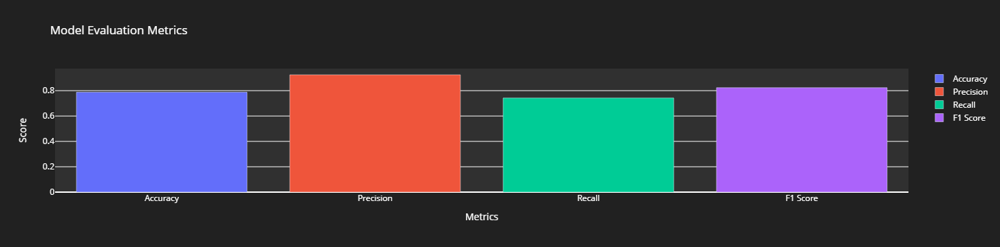

In [24]:
import plotly.graph_objects as go
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# Calculate evaluation metrics (Assuming y_test and y_pred are available)
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

# Create bar charts for accuracy, precision, recall, and F1 score
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']
values = [accuracy, precision, recall, f1]

fig_metrics = go.Figure()
for metric, value in zip(metrics, values):
    fig_metrics.add_trace(go.Bar(x=[metric], y=[value], name=metric, hovertext=f'{metric}: {value:.2f}', textposition='auto'))

fig_metrics.update_layout(
    title='Model Evaluation Metrics',
    xaxis_title='Metrics',
    yaxis_title='Score',
    plot_bgcolor='#303030',
    paper_bgcolor='#212121',
    font=dict(color='white'),
    height = 600,
)
# Show the plot
fig_metrics.show()

### 

<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
3. Confusion Matrix Visualization
</h3>


The code below generates an interactive heatmap to visualize the Confusion Matrix, an essential tool for evaluating the performance of a classification model. The goal is to provide a clear and intuitive representation of the model's predictions and the actual class labels.

The confusion matrix is a table that compares the predicted labels against the actual labels. It consists of four elements:
- **True Positives (TP)**: The number of instances correctly predicted as positive.
- **True Negatives (TN)**: The number of instances correctly predicted as negative.
- **False Positives (FP)**: The number of instances incorrectly predicted as positive.
- **False Negatives (FN)**: The number of instances incorrectly predicted as negative.

The heatmap uses color intensity to represent the number of instances falling into each category, making it easy to identify patterns and potential misclassifications. The x-axis shows the predicted labels, with "Predicted Negative" and "Predicted Positive" indicating the model's predictions. The y-axis shows the actual labels, with "Actual Negative" and "Actual Positive" indicating the true class labels.

The interactive heatmap is created using Plotly, a powerful graphing library. Each cell in the heatmap represents one of the confusion matrix elements, and hovering over the cells displays the exact count of instances for each category. The chart is designed with a dark theme, providing a visually appealing and informative representation of the model's performance.

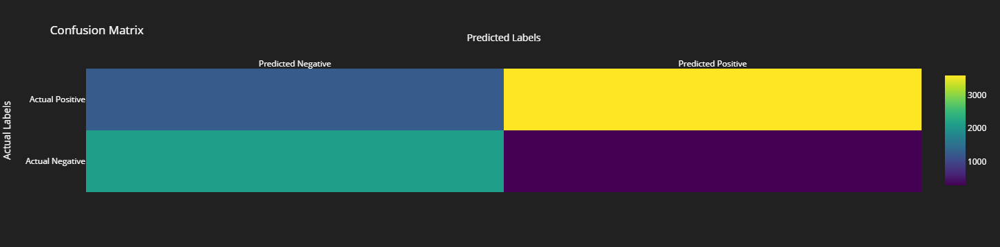

In [25]:
# Create a heatmap for the confusion matrix
fig_confusion_matrix = go.Figure(data=go.Heatmap(z=conf_matrix,
                                                x=['Predicted Negative', 'Predicted Positive'],
                                                y=['Actual Negative', 'Actual Positive'],
                                                hoverinfo='z',
                                                colorscale='Viridis'))

fig_confusion_matrix.update_layout(
    title='Confusion Matrix',
    xaxis_title='Predicted Labels',
    yaxis_title='Actual Labels',
    xaxis=dict(side='top'),
    plot_bgcolor='#303030',
    paper_bgcolor='#212121',
    font=dict(color='white'),
    height = 600,
)

# Show the plot
fig_confusion_matrix.show()

### 
<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
4. Precision-Recall Curve Visualization
</h3>

The code provided above generates an interactive Precision-Recall Curve, a useful tool for assessing the performance of a binary classification model. The goal of this visualization is to show how the trade-off between precision and recall changes as the decision threshold of the model varies.

**Precision** measures the proportion of true positive predictions among all positive predictions made by the model. A high precision indicates that the model is good at avoiding false positives.

**Recall**, also known as sensitivity or true positive rate, measures the proportion of true positive predictions among all actual positive instances in the dataset. A high recall indicates that the model is good at capturing positive instances.

The Precision-Recall Curve is constructed by varying the decision threshold of the model and plotting precision against recall for each threshold. The curve provides valuable insights into how the model performs across different thresholds. A point on the curve represents the precision and recall values corresponding to a specific threshold.

The interactive Precision-Recall Curve is created using Plotly, a powerful graphing library. The curve is shown as a blue line, while individual data points are represented by blue markers on the curve. Hovering over a marker displays the corresponding recall and precision values, providing more detailed information about the model's performance at specific thresholds.

The chart is designed with a dark theme, providing a visually appealing and informative representation of the model's precision-recall characteristics.

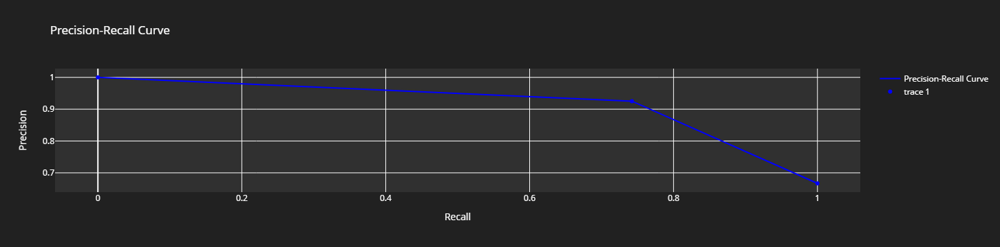

In [28]:
import plotly.graph_objects as go
from sklearn.metrics import precision_recall_curve, auc

# Calculate precision-recall curve values
precision, recall, _ = precision_recall_curve(y_test, y_pred)

# Create an interactive Precision-Recall Curve
fig_precision_recall = go.Figure()

# Add Precision-Recall Curve line
fig_precision_recall.add_trace(go.Scatter(x=recall, y=precision, mode='lines', line=dict(color='blue'), name='Precision-Recall Curve'))

# Add markers for each data point on the curve
fig_precision_recall.add_trace(go.Scatter(x=recall, y=precision, mode='markers', marker=dict(color='blue'), 
                                         hovertext=[f'Recall: {r:.2f}<br>Precision: {p:.2f}' for r, p in zip(recall, precision)],
                                         hoverinfo='text'))

# Set axis labels and title
fig_precision_recall.update_layout(
    title='Precision-Recall Curve',
    xaxis_title='Recall',
    yaxis_title='Precision',
    plot_bgcolor='#303030',
    paper_bgcolor='#212121',
    font=dict(color='white'),
    height = 600,
)

# Show the interactive Precision-Recall Curve
fig_precision_recall.show()

### 

<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
5. Classification Report Table Visualization
</h3>

The code below generates a table to display the Classification Report, which provides a comprehensive evaluation of a machine learning model's performance on a binary classification task. The goal of this visualization is to present various evaluation metrics for each class (Class 0 and Class 1), as well as aggregated metrics for the entire dataset.

The **Classification Report** is a tabular representation that includes the following evaluation metrics for each class:

- **Precision**: Measures the accuracy of positive predictions for the given class.
- **Recall**: Measures the proportion of true positive predictions among all actual positive instances for the given class.
- **F1-score**: Represents the harmonic mean of precision and recall, providing a balanced measure between the two metrics.
- **Support**: Indicates the number of samples in the test set that belong to the given class.

Additionally, the report includes **macro average** and **weighted average** metrics, which are useful for understanding the overall model performance. The **macro average** computes the unweighted mean of precision, recall, and F1-score across classes, while the **weighted average** considers the class support in the calculation.

The table is constructed using Plotly, a powerful graphing library, and is styled with a dark theme, providing a visually appealing and easy-to-read layout. Each row represents a class or an aggregated metric, and the corresponding values are displayed in the cells.

The Classification Report table is a valuable tool for evaluating the model's performance on individual classes and gaining an overall understanding of its effectiveness in the binary classification task.

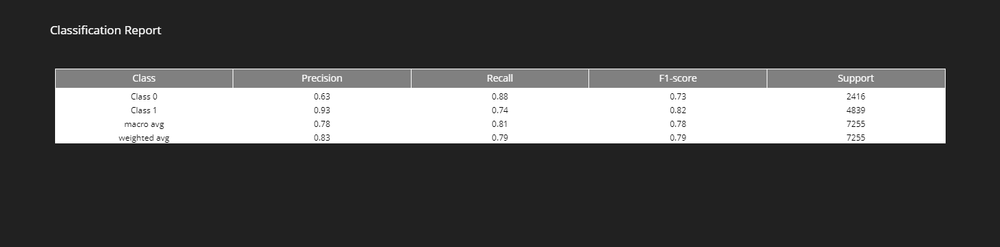

In [27]:
import plotly.graph_objects as go
from sklearn.metrics import classification_report  # Import classification_report

# Get the classification report
class_report = classification_report(y_test, y_pred, target_names=['Class 0', 'Class 1'], output_dict=True)

# Create a table to display the classification report
fig_classification_report = go.Figure(data=[go.Table(
    header=dict(values=['Class', 'Precision', 'Recall', 'F1-score', 'Support'],
                line_color='white', fill_color='gray',
                font=dict(color='white', size=14), align='center'),
    cells=dict(values=[['Class 0', 'Class 1', 'macro avg', 'weighted avg'],
                       [f'{class_report["Class 0"]["precision"]:.2f}', f'{class_report["Class 1"]["precision"]:.2f}',
                        f'{class_report["macro avg"]["precision"]:.2f}', f'{class_report["weighted avg"]["precision"]:.2f}'],
                       [f'{class_report["Class 0"]["recall"]:.2f}', f'{class_report["Class 1"]["recall"]:.2f}',
                        f'{class_report["macro avg"]["recall"]:.2f}', f'{class_report["weighted avg"]["recall"]:.2f}'],
                       [f'{class_report["Class 0"]["f1-score"]:.2f}', f'{class_report["Class 1"]["f1-score"]:.2f}',
                        f'{class_report["macro avg"]["f1-score"]:.2f}', f'{class_report["weighted avg"]["f1-score"]:.2f}'],
                       [f'{class_report["Class 0"]["support"]}', f'{class_report["Class 1"]["support"]}',
                        f'{class_report["macro avg"]["support"]}', f'{class_report["weighted avg"]["support"]}']],
               line_color='white', fill_color='white',
               font=dict(color='black', size=12), align='center')
)])

# Set layout for the table
fig_classification_report.update_layout(
    title='Classification Report',
    plot_bgcolor='#303030',
    paper_bgcolor='#212121',
    font=dict(color='white')
)

# Show the classification report table
fig_classification_report.show()

### 

<h3 id="import" style="color: #a4edb8 ; background: #000000; padding: 20px; border-radius: 20px; text-align: left; border: 5px solid #990000;">
6. save the model
</h3>

**Let's save the model `final_model` that we created using Neural Architecture Search (NAS) and Bayesian Optimization**

In [14]:
import joblib

filename = 'final_model_NAS.pkl'

# Save the final_model to the file
joblib.dump(final_model, filename)

['final_model_NAS.pkl']

If you are uncertain about how to load your model when you need it in the future, here is a guide on how to do it:

In [ ]:
# Load the saved model from the file
loaded_model = joblib.load(filename)

Once the model is loaded, you can use it to make predictions on new data. Provide the appropriate input data to the model's predict() method, and it will return predictions based on the learned patterns from the training data.

## 
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       VIII. Interpretability (XAI) for the model the has been created with Neural Architecture Search (NAS) and Bayesian Optimization
    </h2>

- Intelligent individuals are not only concerned with model performance but also with model interpretability. They may incorporate cutting-edge XAI techniques to understand and communicate how the model arrives at its decisions.
- Apply explainable AI (XAI) techniques to understand how the models make predictions and to communicate the results effectively.

#### **1. Model Architecture Visualization:**


- For deep learning models like MLPs or CNNs, visualizing the model's architecture can provide an overview of the network structure.

We can use the following code to visualize the architecture of the MLP Classifier that we used with `final_model`

**1. let's first describe the model architecture in words to understand how to visualize it. The model architecture we are working with is a Multi-Layer Perceptron (MLP)**

In [25]:
# Get the number of nodes in each layer
input_layer_nodes = X_train.shape[1]
hidden_layer_sizes = [final_model.hidden_layer_sizes]
output_layer_nodes = len(set(y_train))

# Print the architecture
print(f"Model Architecture:")
print(f"Input Layer: {input_layer_nodes} nodes")
for layer_idx, layer_size in enumerate(hidden_layer_sizes):
    print(f"Hidden Layer {layer_idx+1}: {layer_size[0]} nodes")
    print(f"Hidden Layer {layer_idx+2}: {layer_size[1]} nodes")
print(f"Output Layer: {output_layer_nodes} nodes")


Model Architecture:
Input Layer: 17 nodes
Hidden Layer 1: 50 nodes
Hidden Layer 2: 50 nodes
Output Layer: 2 nodes


**2. Now, we will utilize one of the tools that I came across while researching Model Architecture Visualization.**

In [15]:
from eiffel2 import builder

# or the following if you want to have a dark theme
fig =  builder([17, 5, 2], bmode="night", net_colors=["#FFFFFF","#FFFF00","red","#00FFFF"])

**The issue with this tool** is that it doesn't allow us to save the output. Therefore, let's switch to another tool that offers the capability to save the visualization.

**I manually constructed the architecture using one of the image editing applications.**

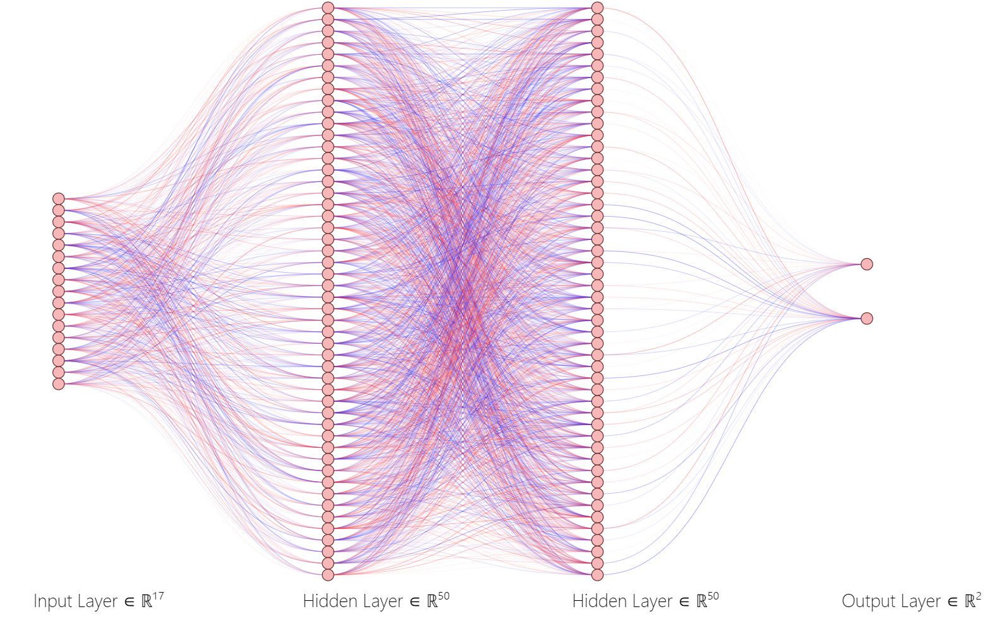

##### **Challenges in Visualizing Model Architectures: Exploring Four Methods and Their Limitations**

**To be honest, I spent a considerable amount of time researching and exploring various visualization methods**, but unfortunately, none of them provided the desired results. Among the four methods I attempted, none of them produced the high-quality visualizations I was hoping for. Here you could see them.

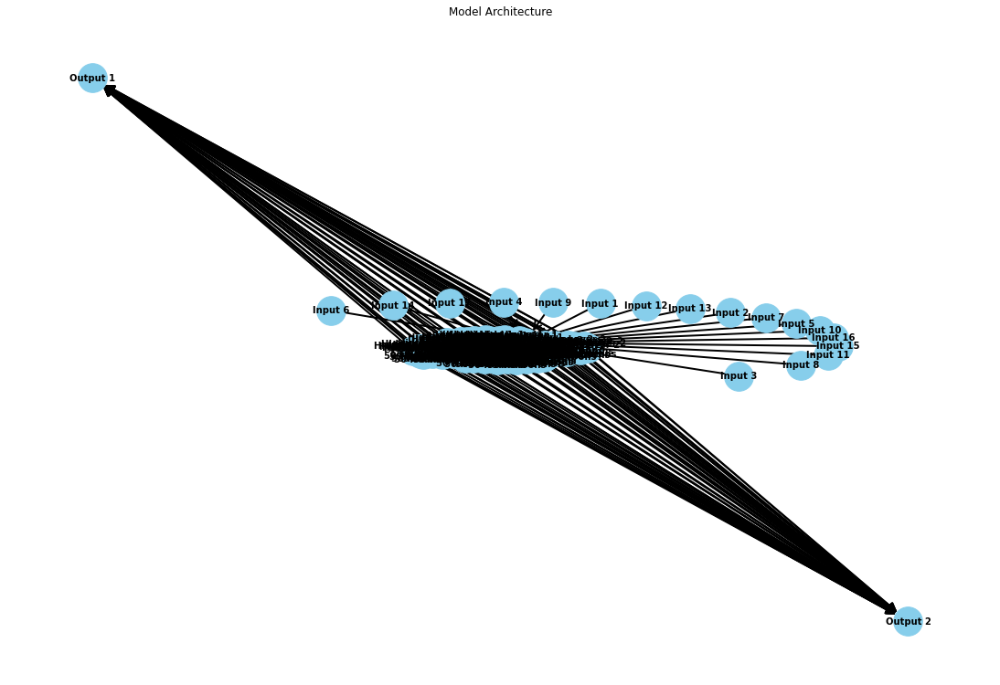

In [27]:
# Create a network graph to represent the model architecture
G = nx.DiGraph()

# Input layer nodes
input_layer_nodes = [f"Input_{i}" for i in range(X_train.shape[1])]
G.add_nodes_from(input_layer_nodes)
input_layer_labels = {node: f"Input {i+1}" for i, node in enumerate(input_layer_nodes)}
nx.set_node_attributes(G, input_layer_labels, 'label')

# Hidden layer nodes
hidden_layer_sizes = list(final_model.hidden_layer_sizes)
for layer_idx, layer_size in enumerate(hidden_layer_sizes):
    nodes = [f"Hidden_{layer_idx}_{i}" for i in range(layer_size)]
    G.add_nodes_from(nodes)
    hidden_layer_labels = {node: f"Hidden Layer {layer_idx+1}\n{layer_size} Neurons" for node in nodes}
    nx.set_node_attributes(G, hidden_layer_labels, 'label')

# Output layer nodes
output_layer_nodes = [f"Output_{i}" for i in range(len(set(y_train)))]
G.add_nodes_from(output_layer_nodes)
output_layer_labels = {node: f"Output {i+1}" for i, node in enumerate(output_layer_nodes)}
nx.set_node_attributes(G, output_layer_labels, 'label')

# Add edges between nodes
for node in input_layer_nodes:
    G.add_edge(node, f"Hidden_0_0")

for i in range(len(hidden_layer_sizes) - 1):
    for j in range(hidden_layer_sizes[i]):
        for k in range(hidden_layer_sizes[i+1]):
            G.add_edge(f"Hidden_{i}_{j}", f"Hidden_{i+1}_{k}")

for j in range(hidden_layer_sizes[-1]):
    for k in range(len(set(y_train))):
        G.add_edge(f"Hidden_{len(hidden_layer_sizes)-1}_{j}", f"Output_{k}")

# Draw the network graph
plt.figure(figsize=(15, 10))
pos = nx.spring_layout(G, seed=42)  # Adjust the layout for better visualization
node_labels = nx.get_node_attributes(G, 'label')
nx.draw(G, pos, with_labels=True, labels=node_labels, node_size=1000, font_size=10, node_color='skyblue', arrowsize=20, arrowstyle='->', width=2, font_weight='bold')
plt.title("Model Architecture")
plt.savefig('model_architecture.png', bbox_inches='tight')
plt.show()

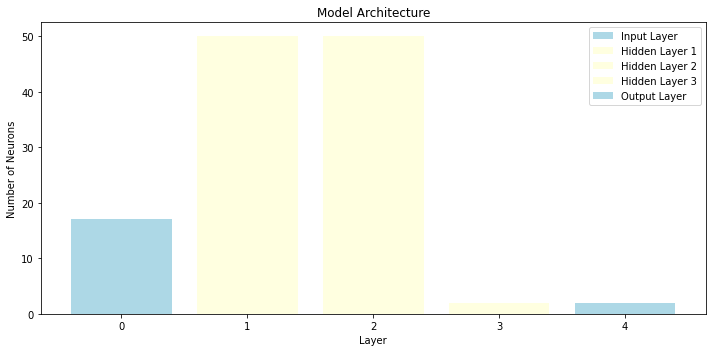

In [25]:
# Visualize the Model Architecture
hidden_layer_sizes = list(final_model.hidden_layer_sizes)
hidden_layer_sizes.append(len(set(y_train)))  # Add output layer size

plt.figure(figsize=(10, 5))
plt.title("Model Architecture")
plt.xlabel("Layer")
plt.ylabel("Number of Neurons")

# Input layer
plt.bar(0, X_train.shape[1], color='lightblue', label="Input Layer")

# Hidden layers
for i, size in enumerate(hidden_layer_sizes):
    plt.bar(i + 1, size, color='lightyellow', label=f"Hidden Layer {i+1}")

# Output layer
plt.bar(len(hidden_layer_sizes) + 1, len(set(y_train)), color='lightblue', label="Output Layer")

plt.legend(loc='best')
plt.tight_layout()
plt.savefig('model_architecture.png')
plt.show()

In [ ]:
from graphviz import Digraph

# Create a Digraph object to visualize the model architecture
dot = Digraph()

# Add input layer nodes
input_layer_nodes = [f"Input_{i}" for i in range(X_train.shape[1])]
dot.attr(rankdir='LR')
dot.attr('node', shape='ellipse')
dot.node_attr.update(color='lightblue2', style='filled')
for node_name in input_layer_nodes:
    dot.node(node_name)

# Add hidden layer nodes
hidden_layer_sizes = final_model.hidden_layer_sizes
hidden_layer_nodes = []
for layer_idx, layer_size in enumerate(hidden_layer_sizes):
    nodes = [f"Hidden_{layer_idx}_{i}" for i in range(layer_size)]
    hidden_layer_nodes.append(nodes)
    dot.attr('node', shape='circle')
    dot.node_attr.update(color='lightyellow', style='filled')
    dot.node(nodes[0], label=f"Hidden Layer {layer_idx+1}\n{layer_size} Neurons")
    for input_node in input_layer_nodes:
        dot.edge(input_node, nodes[0])
    if layer_idx > 0:
        prev_layer_nodes = hidden_layer_nodes[layer_idx-1]
        for node in nodes:
            for prev_node in prev_layer_nodes:
                dot.edge(prev_node, node)

# Add output layer nodes
output_layer_nodes = [f"Output_{i}" for i in range(len(set(y_train)))]
dot.attr('node', shape='ellipse')
dot.node_attr.update(color='lightblue2', style='filled')
dot.node(output_layer_nodes[0], label=f"Output Layer\n{len(set(y_train))} Neurons")
for last_hidden_node in hidden_layer_nodes[-1]:
    dot.edge(last_hidden_node, output_layer_nodes[0])

# Save the model architecture visualization as a PDF
dot.render('model_architecture', format='pdf')

In [ ]:
from sklearn.neural_network import MLPClassifier
from mlxtend.plotting import plot_nn_graph

# Replace these values with your actual hyperparameters
alpha = 0.0026644862773735002
hidden_layer_sizes = (50, 50)
learning_rate_init = 0.006900454603009123
random_state = 42

# Create the MLPClassifier with the specified hyperparameters
mlp_clf = MLPClassifier(
    alpha=alpha,
    hidden_layer_sizes=hidden_layer_sizes,
    learning_rate_init=learning_rate_init,
    random_state=random_state
)

# Visualize the network architecture
plot_nn_graph(mlp_clf, filename='mlp_architecture.png')


#### **2. Receiver Operating Characteristic (ROC) Curve:** 


- A plot that shows the true positive rate (recall) against the false positive rate at different probability thresholds. It evaluates the model's ability to distinguish between classes.

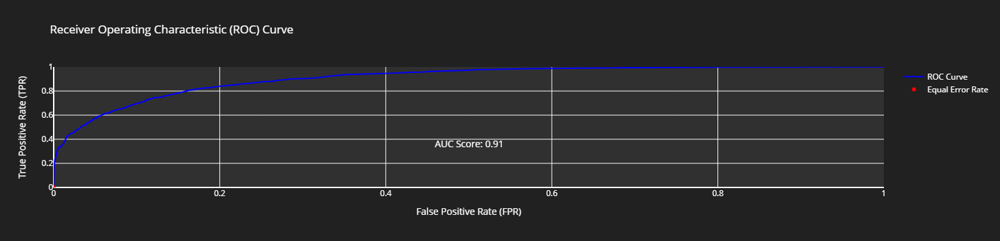

In [29]:
import plotly.graph_objects as go
from sklearn.metrics import roc_curve, roc_auc_score


# Get predicted probabilities for positive class
y_probs = final_model.predict_proba(X_test)[:, 1]

# Calculate ROC curve values
fpr, tpr, _ = roc_curve(y_test, y_probs)

# Calculate AUC score
auc_score = roc_auc_score(y_test, y_probs)

# Create an interactive ROC Curve
fig_roc_curve = go.Figure()

# Add ROC Curve line
fig_roc_curve.add_trace(go.Scatter(x=fpr, y=tpr, mode='lines', line=dict(color='blue'), name='ROC Curve', hoverinfo='none'))

# Add AUC score as text in the plot
fig_roc_curve.add_annotation(
    go.layout.Annotation(
        x=0.5,
        y=0.3,
        xref="paper",
        yref="paper",
        text=f'AUC Score: {auc_score:.2f}',
        showarrow=False,
        font=dict(size=14, color='white')
    )
)

# Highlight the point where TPR and FPR are equal (Youden's J statistic)
index_equal_error_rate = (tpr - fpr).argmin()
fig_roc_curve.add_trace(go.Scatter(x=[fpr[index_equal_error_rate]], y=[tpr[index_equal_error_rate]], mode='markers', marker=dict(color='red'), name='Equal Error Rate', hoverinfo='none'))

# Set axis labels and title
fig_roc_curve.update_layout(
    title='Receiver Operating Characteristic (ROC) Curve',
    xaxis_title='False Positive Rate (FPR)',
    yaxis_title='True Positive Rate (TPR)',
    xaxis=dict(range=[0, 1]),
    yaxis=dict(range=[0, 1]),
    plot_bgcolor='#303030',
    paper_bgcolor='#212121',
    font=dict(color='white'),
    height=600,
)

# Show the interactive ROC Curve
fig_roc_curve.show()


#### **3. Feature Importances:**


- For tree-based models or models with interpretable coefficients (e.g., logistic regression), feature importances can be visualized to understand which features are most influential in making predictions. We sometimes use it with neural networks like the MLPClassifier, but the concept of feature importances is slightly different for neural networks compared to tree-based models.

- For tree-based models (e.g., decision trees, random forests, gradient boosting), feature importances are directly available as they are built based on the structure of the tree and the contribution of each feature to the model's decision-making process.

- However, for neural networks, feature importances are not inherently available like in tree-based models. Neural networks are composed of weighted connections between neurons, and each connection's weight represents its importance in the model. Therefore, we can assess feature importances in neural networks through weight analysis.

- In the case of the MLPClassifier, we can analyze the model's weights to understand the relative importance of different features. Higher absolute weights generally indicate stronger influence on the model's predictions. However, the interpretation of feature importances in neural networks can be more complex and less straightforward compared to tree-based models.

***To extract feature importances from the MLPClassifier***, *you can use the weights of the input layer. Here's an example of how to do it:*

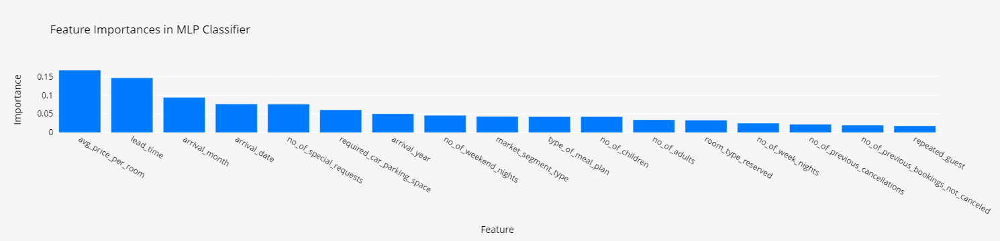

In [126]:
# Get the feature importances (weights) from the input layer
input_layer_weights = final_model.coefs_[0]

# Calculate the absolute sum of weights for each feature
feature_importances = np.abs(input_layer_weights).sum(axis=1)

# Normalize the feature importances
feature_importances /= feature_importances.sum()

# Get the feature names
feature_names = X_train.columns

# Sort the features by importance
sorted_indices = np.argsort(feature_importances)[::-1]

# Create an interactive bar plot for feature importances
fig_feature_importance = go.Figure(data=go.Bar(
    x=feature_names[sorted_indices],
    y=feature_importances[sorted_indices],
    hovertext=[f"{feature}: {importance:.4f}" for feature, importance in zip(feature_names[sorted_indices], feature_importances[sorted_indices])],
    hoverinfo='text',
    marker_color='rgb(0, 123, 255)'
))

# Set layout for the plot
fig_feature_importance.update_layout(
    title='Feature Importances in MLP Classifier',
    xaxis_title='Feature',
    yaxis_title='Importance',
    plot_bgcolor='#f5f5f5',
    paper_bgcolor='#f5f5f5',
    font=dict(color='black'),
    height=500,
)

# Show the interactive plot
fig_feature_importance.show()

#### **4. Summary Plot using SHAP:** 


- This plot provides an overview of feature importances for the entire dataset. It shows the distribution of SHAP values for each feature, highlighting the impact of each feature on model predictions.

  0%|          | 0/20 [00:00<?, ?it/s]

num_full_subsets = 2
remaining_weight_vector = [0.25514743 0.21049663 0.18710811 0.17541386 0.17183398]
num_paired_subset_sizes = 6
weight_left = 0.47792874825587944
np.sum(w_aug) = 14.0
np.sum(self.kernelWeights) = 1.0000000000000002
phi = [ 0.00520369 -0.00634964 -0.00572269 -0.03756043 -0.00482902  0.01011049
  0.00526527 -0.21281746  0.01374596  0.00596241 -0.00692848  0.04773718
 -0.02234593 -0.38943417]
np.sum(w_aug) = 14.0
np.sum(self.kernelWeights) = 1.0000000000000002
phi = [-0.00520369  0.00634964  0.00572269  0.03756043  0.00482902 -0.01011049
 -0.00526527  0.21281746 -0.01374596 -0.00596241  0.00692848 -0.04773718
  0.02234593  0.38943417]
num_full_subsets = 2
remaining_weight_vector = [0.25514743 0.21049663 0.18710811 0.17541386 0.17183398]
num_paired_subset_sizes = 6
weight_left = 0.47792874825587944
np.sum(w_aug) = 14.0
np.sum(self.kernelWeights) = 1.0000000000000002
phi = [-0.01136622 -0.00214506  0.00696344 -0.00769524 -0.00381062  0.00749689
 -0.05133382 -0.20352277 -

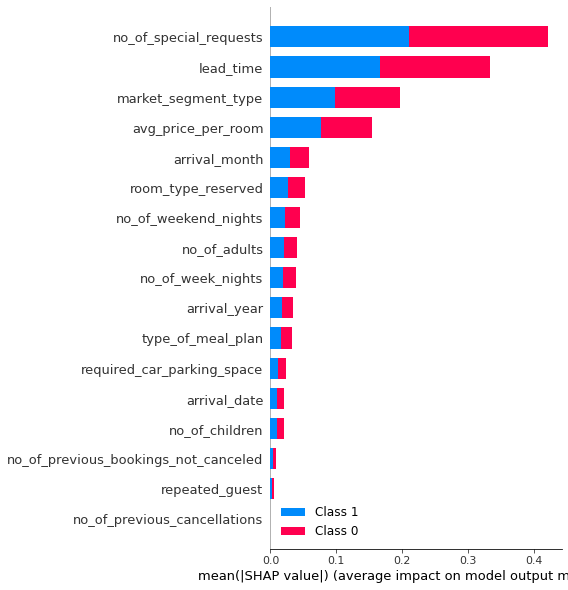

In [31]:
import shap

# Initialize the SHAP explainer with the predict_proba function of final_model
explainer = shap.KernelExplainer(final_model.predict_proba, X_train[:20])

# Calculate SHAP values for the test data
shap_values = explainer.shap_values(X_test[:20])

# Create a summary plot of SHAP values
fig_shap_summary = shap.summary_plot(shap_values, X_test[:20], show=False, feature_names=X_test.columns)

# Show the interactive plot
fig_shap_summary

#### **5. 2D Decision Boundary Visualization:** 


- For 2D or 3D data, decision boundary plots show how the model classifies different regions of the feature space.

In [ ]:
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.neural_network import MLPClassifier
import numpy as np
from matplotlib.colors import ListedColormap 

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Dropdown(
        id='feature1-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[0],
        style={'width': '50%'}
    ),
    dcc.Dropdown(
        id='feature2-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[1],
        style={'width': '50%'}
    ),
    dcc.Graph(id='decision-boundary-plot')
])

# Define the callback to update the plot when dropdown values change
@app.callback(
    Output('decision-boundary-plot', 'figure'),
    [Input('feature1-dropdown', 'value'),
     Input('feature2-dropdown', 'value')]
)
def update_decision_boundary_plot(feature1, feature2):
    # Fit the model on the selected two columns
    final_model.fit(X_test[[feature1, feature2]], y_test)

    # Define the range for the mesh grid
    x_min, x_max = X_test[feature1].min() - 1, X_test[feature1].max() + 1
    y_min, y_max = X_test[feature2].min() - 1, X_test[feature2].max() + 1

    # Create a mesh grid
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01),
                         np.arange(y_min, y_max, 0.01))

    # Predict the class labels for each point on the mesh grid
    Z = final_model.predict(np.c_[xx.ravel(), yy.ravel()])

    # Create a color map for the decision boundary plot
    cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA', '#AAAAFF'])

    # Plot the decision boundary
    Z = Z.reshape(xx.shape)
    trace_decision_boundary = go.Contour(
        x=np.arange(x_min, x_max, 0.01),
        y=np.arange(y_min, y_max, 0.01),
        z=Z,
        colorscale=[[0, '#FFAAAA'], [1, '#AAAAFF']],
        showscale=False,
        opacity=0.8
    )

    # Plot the data points
    trace_data_points = go.Scatter(
        x=X_test[feature1],
        y=X_test[feature2],
        mode='markers',
        marker=dict(
            size=7,
            color=y_test,
            colorscale=[[0, 'red'], [1, 'blue']],
            showscale=False,
            line=dict(width=1, color='black')
        ),
        hoverinfo='text',
        text=y_test
    )

    # Set plot labels and title
    layout = go.Layout(
        xaxis=dict(title=feature1),
        yaxis=dict(title=feature2),
        title='Decision Boundary Visualization for the Two Selected Features',
        hovermode='closest'
    )

    # Create the plot figure
    fig = go.Figure(data=[trace_decision_boundary, trace_data_points], layout=layout)
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


OR you could use this one:

In [116]:
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.neural_network import MLPClassifier
import numpy as np
from matplotlib.colors import ListedColormap 

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Dropdown(
        id='feature1-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[0],
        style={'width': '50%'}
    ),
    dcc.Dropdown(
        id='feature2-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[1],
        style={'width': '50%'}
    ),
    dcc.Graph(id='decision-boundary-plot')
])

# Define the callback to update the plot when dropdown values change
@app.callback(
    Output('decision-boundary-plot', 'figure'),
    [Input('feature1-dropdown', 'value'),
     Input('feature2-dropdown', 'value')]
)
def update_decision_boundary_plot(feature1, feature2):
    # Fit the model on the selected two columns
    final_model.fit(X_test[[feature1, feature2]], y_test)

    # Define the range for the mesh grid
    x_min, x_max = X_test[feature1].min() - 1, X_test[feature1].max() + 1
    y_min, y_max = X_test[feature2].min() - 1, X_test[feature2].max() + 1

    # Create a mesh grid
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01),
                         np.arange(y_min, y_max, 0.01))

    # Predict the class labels for each point on the mesh grid
    Z = final_model.predict(np.c_[xx.ravel(), yy.ravel()])

    # Create a color map for the decision boundary plot
    cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA', '#AAAAFF'])

    # Plot the decision boundary
    Z = Z.reshape(xx.shape)
    trace_decision_boundary = go.Contour(
        x=np.arange(x_min, x_max, 0.01),
        y=np.arange(y_min, y_max, 0.01),
        z=Z,
        colorscale=[[0, '#FFAAAA'], [1, '#AAAAFF']],
        showscale=False,
        opacity=0.8,
        hoverinfo='none'  # Hide hover info for the contour plot
    )

    # Plot the data points
    trace_data_points = go.Scatter(
        x=X_test[feature1],
        y=X_test[feature2],
        mode='markers',
        marker=dict(
            size=10,
            color=y_test,
            colorscale=[[0, 'red'], [1, 'blue']],
            colorbar=dict(title='Class', titleside='right', tickvals=[0, 1], ticktext=['Class 0', 'Class 1']),
            showscale=True,
            line=dict(width=1, color='black')
        ),
        hoverinfo='text',  # Show hover info for the data points
        text=y_test.apply(lambda label: f'Class {label}')
    )

    # Set plot labels and title
    layout = go.Layout(
        xaxis=dict(title=feature1),
        yaxis=dict(title=feature2),
        title='Decision Boundary Visualization for the Two Selected Features',
        hovermode='closest',
        margin=dict(l=50, r=50, b=50, t=50),  # Add margins for better spacing
        legend=dict(x=0.02, y=0.98, bgcolor='rgba(255, 255, 255, 0.7)', bordercolor='black'),  # Customize legend position and background
        paper_bgcolor='rgba(240, 240, 240, 0.9)',  # Set paper background color
        plot_bgcolor='rgba(240, 240, 240, 0.9)',  # Set plot background color
        font=dict(color='black'),
    )

    # Create the plot figure
    fig = go.Figure(data=[trace_decision_boundary, trace_data_points], layout=layout)
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port= 8058)


**Important:** In case the interactive visualization isn't visible, you can refer to the images provided below. Please note that the current setup requires the code to be hosted on a server, a step that will be implemented in the future.


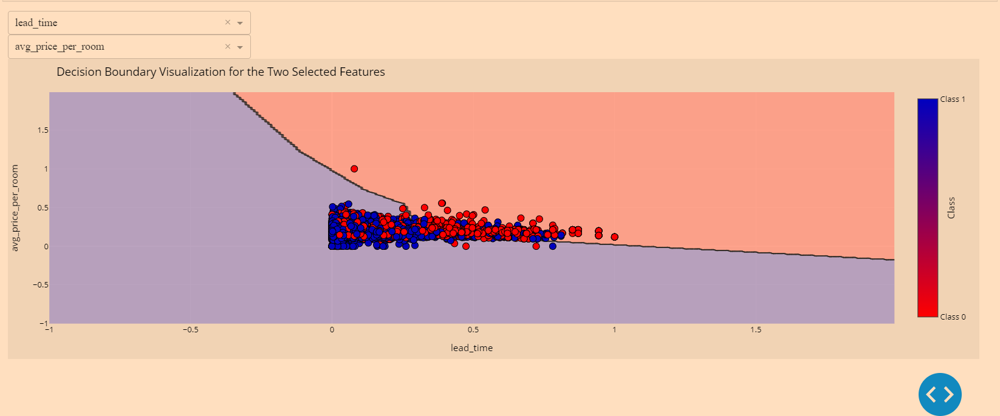
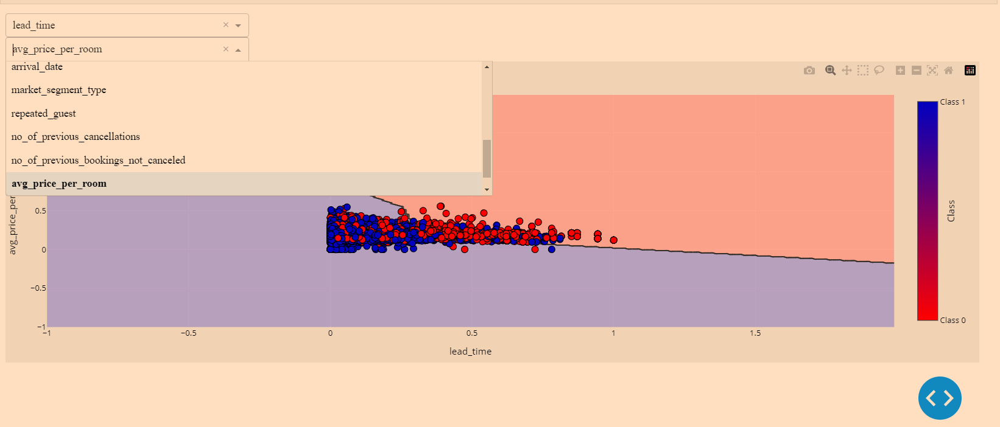

#### **6. 3D Decision Boundary Visualization:** 


- For 3D data, decision boundary plots show how the model classifies different regions of the feature space.

In [ ]:
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report  # Import classification_report
import numpy as np
from matplotlib.colors import ListedColormap 

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Dropdown(
        id='feature1-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[0],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature2-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[1],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature3-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[2],
        style={'width': '30%'}
    ),
    dcc.Graph(id='decision-boundary-plot')
])

# Define the callback to update the plot when dropdown values change
@app.callback(
    Output('decision-boundary-plot', 'figure'),
    [Input('feature1-dropdown', 'value'),
     Input('feature2-dropdown', 'value'),
     Input('feature3-dropdown', 'value')]
)
def update_decision_boundary_plot(feature1, feature2, feature3):
    # Define the range for the mesh grid
    x_min, x_max = X_test[feature1].min() - 1, X_test[feature1].max() + 1
    y_min, y_max = X_test[feature2].min() - 1, X_test[feature2].max() + 1
    z_min, z_max = X_test[feature3].min() - 1, X_test[feature3].max() + 1

    # Create a mesh grid
    xx, yy, zz = np.meshgrid(np.arange(x_min, x_max, 0.1),
                             np.arange(y_min, y_max, 0.1),
                             np.arange(z_min, z_max, 0.1))

    # Predict the class labels for each point on the mesh grid
    Z = final_model.predict(np.c_[xx.ravel(), yy.ravel(), zz.ravel()])

    # Create a color map for the decision boundary plot
    cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA', '#AAAAFF'])

    # Plot the decision boundary
    Z = Z.reshape(xx.shape)
    trace_decision_boundary = go.Isosurface(
        x=np.arange(x_min, x_max, 0.1),
        y=np.arange(y_min, y_max, 0.1),
        z=np.arange(z_min, z_max, 0.1),
        value=Z,
        colorscale=[[0, '#FFAAAA'], [1, '#AAAAFF']],
        showscale=False,
        opacity=0.6
    )

    # Plot the data points
    trace_data_points = go.Scatter3d(
        x=X_test[feature1],
        y=X_test[feature2],
        z=X_test[feature3],
        mode='markers',
        marker=dict(
            size=5,
            color=y_test,
            colorscale=[[0, 'red'], [1, 'blue']],
            colorbar=dict(title='Class', titleside='right', tickvals=[0, 1], ticktext=['Class 0', 'Class 1']),
            showscale=True,
            line=dict(width=0, color='black')
        ),
        hoverinfo='text',  # Show hover info for the data points
        text=y_test.apply(lambda label: f'Class {label}')
    )

    # Set plot labels and title
    layout = go.Layout(
        scene=dict(
            xaxis=dict(title=feature1),
            yaxis=dict(title=feature2),
            zaxis=dict(title=feature3),
        ),
        title='3D Decision Boundary Visualization for the Three Selected Features',
        hovermode='closest',
        margin=dict(l=0, r=0, b=0, t=50),  # Add margins for better spacing
        legend=dict(x=0, y=1, bgcolor='rgba(255, 255, 255, 0.7)', bordercolor='black'),  # Customize legend position and background
        paper_bgcolor='rgba(240, 240, 240, 0.9)',  # Set paper background color
        plot_bgcolor='rgba(240, 240, 240, 0.9)',  # Set plot background color
        font=dict(color='black'),
    )

    # Create the plot figure
    fig = go.Figure(data=[trace_decision_boundary, trace_data_points], layout=layout)
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


In [ ]:
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.neural_network import MLPClassifier
import numpy as np

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Dropdown(
        id='feature1-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[0],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature2-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[1],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature3-dropdown',
        options=[{'label': col, 'value': col} for col in X_test.columns],
        value=X_test.columns[2],
        style={'width': '30%'}
    ),
    dcc.Graph(
        id='hyperplane-plot',
        config={'displayModeBar': False},  # Remove plotly's mode bar
        style={'width': '100%', 'height': '75vh'}  # Set width and height of the 3D plot
    )
])

# Define the callback to update the plot when dropdown values change
@app.callback(
    Output('hyperplane-plot', 'figure'),
    [Input('feature1-dropdown', 'value'),
     Input('feature2-dropdown', 'value'),
     Input('feature3-dropdown', 'value')]
)
def update_hyperplane_plot(feature1, feature2, feature3):
    # Define the range for the mesh grid
    x_min, x_max = X_test[feature1].min() - 1, X_test[feature1].max() + 1
    y_min, y_max = X_test[feature2].min() - 1, X_test[feature2].max() + 1
    z_min, z_max = X_test[feature3].min() - 1, X_test[feature3].max() + 1

    # Create a mesh grid
    xx, yy, zz = np.meshgrid(np.arange(x_min, x_max, 0.1),
                             np.arange(y_min, y_max, 0.1),
                             np.arange(z_min, z_max, 0.1))

    # Predict the class labels for each point on the mesh grid
    meshgrid_data = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
    Z = final_model.predict(meshgrid_data)

    # Create the Plotly colorscale for the hyperplane plot
    colorscale = [[i / (len(np.unique(y_test)) - 1), f'rgb({np.random.randint(0, 256)}, {np.random.randint(0, 256)}, {np.random.randint(0, 256)})'] for i in range(len(np.unique(y_test)))]

    # Plot the hyperplanes corresponding to the model's decision boundaries
    traces_hyperplanes = []
    for class_val in range(len(np.unique(y_test))):
        mask = Z == class_val
        trace_hyperplane = go.Mesh3d(
            x=xx[mask].ravel(),
            y=yy[mask].ravel(),
            z=zz[mask].ravel(),
            opacity=0.6,
            alphahull=0,
            color=colorscale[class_val][1],
            showscale=False
        )
        traces_hyperplanes.append(trace_hyperplane)

    # Plot the data points
    trace_data_points = go.Scatter3d(
        x=X_test[feature1],
        y=X_test[feature2],
        z=X_test[feature3],
        mode='markers',
        marker=dict(
            size=5,
            color=y_test,
            colorscale=colorscale,
            colorbar=dict(title='Class', titleside='right', tickvals=np.unique(y_test), ticktext=np.unique(y_test)),
            showscale=True,
            line=dict(width=0, color='black')
        ),
        hoverinfo='text',  # Show hover info for each point
        hovertext=y_test.values,
    )

    # Create the plot layout
    layout = go.Layout(
        scene=dict(
            xaxis=dict(title=feature1),
            yaxis=dict(title=feature2),
            zaxis=dict(title=feature3),
        ),
        title='3D Hyperplane Visualization for the Three Selected Features',
        hovermode='closest',
        margin=dict(l=0, r=0, b=0, t=50),  # Add margins for better spacing
        legend=dict(x=0, y=1, bgcolor='rgba(255, 255, 255, 0.7)', bordercolor='black'),  # Customize legend position and background
        paper_bgcolor='rgba(240, 240, 240, 0.9)',  # Set paper background color
        plot_bgcolor='rgba(240, 240, 240, 0.9)',  # Set plot background color
        font=dict(color='black'),
    )

    # Create the plot figure
    fig = go.Figure(data=traces_hyperplanes + [trace_data_points], layout=layout)
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


In [ ]:
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.neural_network import MLPClassifier
import numpy as np

# Load the df_hotel_reservation_scaled dataframe here (replace this with your actual data)
# df_hotel_reservation_scaled = ...

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Dropdown(
        id='feature1-dropdown',
        options=[{'label': col, 'value': col} for col in df_hotel_reservation_scaled.columns],
        value=df_hotel_reservation_scaled.columns[0],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature2-dropdown',
        options=[{'label': col, 'value': col} for col in df_hotel_reservation_scaled.columns],
        value=df_hotel_reservation_scaled.columns[1],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature3-dropdown',
        options=[{'label': col, 'value': col} for col in df_hotel_reservation_scaled.columns],
        value=df_hotel_reservation_scaled.columns[2],
        style={'width': '30%'}
    ),
    dcc.Graph(
        id='hyperplane-plot',
        config={'displayModeBar': False},  # Remove plotly's mode bar
        style={'width': '100%', 'height': '75vh'}  # Set width and height of the 3D plot
    )
])

# Define the callback to update the plot when dropdown values change
@app.callback(
    Output('hyperplane-plot', 'figure'),
    [Input('feature1-dropdown', 'value'),
     Input('feature2-dropdown', 'value'),
     Input('feature3-dropdown', 'value')]
)
def update_hyperplane_plot(feature1, feature2, feature3):
    # Select the three chosen columns
    X_train = df_hotel_reservation_scaled[[feature1, feature2, feature3]]
    y_train = df_hotel_reservation_scaled['booking_status']  # Replace 'target_column' with the actual target column name

    # Create the MLPClassifier with the specified parameters
    model = MLPClassifier(
        activation='identity',
        alpha=0.0026644862773735002,
        hidden_layer_sizes=(2,),
        learning_rate_init=0.006900454603009123,
        solver='sgd',
        random_state=42
    )

    # Fit the model on the selected data
    model.fit(X_train, y_train)

    # Define the range for the mesh grid
    x_min, x_max = X_train[feature1].min() - 1, X_train[feature1].max() + 1
    y_min, y_max = X_train[feature2].min() - 1, X_train[feature2].max() + 1
    z_min, z_max = X_train[feature3].min() - 1, X_train[feature3].max() + 1

    # Create a mesh grid
    xx, yy, zz = np.meshgrid(np.arange(x_min, x_max, 0.1),
                             np.arange(y_min, y_max, 0.1),
                             np.arange(z_min, z_max, 0.1))

    # Predict the class labels for each point on the mesh grid
    meshgrid_data = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
    Z = model.predict(meshgrid_data)

    # Reshape the mesh grid arrays to match the shape of the boolean index array
    xx = xx.reshape(Z.shape)
    yy = yy.reshape(Z.shape)
    zz = zz.reshape(Z.shape)

    # Create the Plotly colorscale for the hyperplane plot
    colorscale = [[i / (len(np.unique(y_train)) - 1), f'rgb({np.random.randint(0, 256)}, {np.random.randint(0, 256)}, {np.random.randint(0, 256)})'] for i in range(len(np.unique(y_train)))]

    # Plot the hyperplanes corresponding to the model's decision boundaries
    traces_hyperplanes = []
    for class_val in range(len(np.unique(y_train))):
        mask = Z == class_val
        trace_hyperplane = go.Mesh3d(
            x=xx[mask],
            y=yy[mask],
            z=zz[mask],
            opacity=0.6,
            alphahull=0,
            color=colorscale[class_val][1],
            showscale=False
        )
        traces_hyperplanes.append(trace_hyperplane)

    # Plot the data points
    trace_data_points = go.Scatter3d(
        x=X_train[feature1],
        y=X_train[feature2],
        z=X_train[feature3],
        mode='markers',
        marker=dict(
            size=5,
            color=y_train,
            colorscale=colorscale,
            colorbar=dict(title='Class', titleside='right', tickvals=np.unique(y_train), ticktext=np.unique(y_train)),
            showscale=True,
            line=dict(width=0, color='black')
        ),
        hoverinfo='text',  # Show hover info for each point
        hovertext=y_train.values,
    )

    # Create the plot layout
    layout = go.Layout(
        scene=dict(
            xaxis=dict(title=feature1),
            yaxis=dict(title=feature2),
            zaxis=dict(title=feature3),
        ),
        title='3D Hyperplane Visualization for the Three Selected Features',
        hovermode='closest',
        margin=dict(l=0, r=0, b=0, t=50),  # Add margins for better spacing
        legend=dict(x=0, y=1, bgcolor='rgba(255, 255, 255, 0.7)', bordercolor='black'),  # Customize legend position and background
        paper_bgcolor='rgba(240, 240, 240, 0.9)',  # Set paper background color
        plot_bgcolor='rgba(240, 240, 240, 0.9)',  # Set plot background color
        font=dict(color='black'),
    )

    # Create the plot figure
    fig = go.Figure(data=traces_hyperplanes + [trace_data_points], layout=layout)
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port=8059)


In [ ]:
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.neural_network import MLPClassifier
import numpy as np

# Load the df_hotel_reservation_scaled dataframe here (replace this with your actual data)
# df_hotel_reservation_scaled = ...

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Dropdown(
        id='feature1-dropdown',
        options=[{'label': col, 'value': col} for col in df_hotel_reservation_scaled.columns],
        value=df_hotel_reservation_scaled.columns[0],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature2-dropdown',
        options=[{'label': col, 'value': col} for col in df_hotel_reservation_scaled.columns],
        value=df_hotel_reservation_scaled.columns[1],
        style={'width': '30%'}
    ),
    dcc.Dropdown(
        id='feature3-dropdown',
        options=[{'label': col, 'value': col} for col in df_hotel_reservation_scaled.columns],
        value=df_hotel_reservation_scaled.columns[2],
        style={'width': '30%'}
    ),
    dcc.Graph(
        id='hyperplane-plot',
        config={'displayModeBar': False},  # Remove plotly's mode bar
        style={'width': '100%', 'height': '75vh'}  # Set width and height of the 3D plot
    ),
    html.Div(id='misclassification-stats')
])

# Define the callback to update the plot and misclassification stats when dropdown values change
@app.callback(
    [Output('hyperplane-plot', 'figure'),
     Output('misclassification-stats', 'children')],
    [Input('feature1-dropdown', 'value'),
     Input('feature2-dropdown', 'value'),
     Input('feature3-dropdown', 'value')]
)
def update_hyperplane_plot(feature1, feature2, feature3):
    # Select the three chosen columns
    X_train = df_hotel_reservation_scaled[[feature1, feature2, feature3]]
    y_train = df_hotel_reservation_scaled['booking_status']  # Replace 'target_column' with the actual target column name

    # Create the MLPClassifier with the specified parameters
    final_model = MLPClassifier(
        activation='identity',
        alpha=0.0026644862773735002,
        hidden_layer_sizes=(2,),
        learning_rate_init=0.006900454603009123,
        solver='sgd',
        random_state=42
    )

    # Fit the model on the selected data
    final_model.fit(X_train, y_train)

    # Define the range for the mesh grid
    x_min, x_max = X_train[feature1].min() - 1, X_train[feature1].max() + 1
    y_min, y_max = X_train[feature2].min() - 1, X_train[feature2].max() + 1
    z_min, z_max = X_train[feature3].min() - 1, X_train[feature3].max() + 1

    # Create a mesh grid
    xx, yy, zz = np.meshgrid(np.arange(x_min, x_max, 0.1),
                             np.arange(y_min, y_max, 0.1),
                             np.arange(z_min, z_max, 0.1))

    # Predict the class labels for each point on the mesh grid
    meshgrid_data = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
    Z = final_model.predict(meshgrid_data)

    # Reshape the mesh grid arrays to match the shape of the boolean index array
    xx = xx.reshape(Z.shape)
    yy = yy.reshape(Z.shape)
    zz = zz.reshape(Z.shape)

    # Create the Plotly colorscale for the hyperplane plot
    colorscale = [[i / (len(np.unique(y_train)) - 1), f'rgb({np.random.randint(0, 256)}, {np.random.randint(0, 256)}, {np.random.randint(0, 256)})'] for i in range(len(np.unique(y_train)))]

    # Plot the hyperplanes corresponding to the model's decision boundaries
    traces_hyperplanes = []
    for class_val in range(len(np.unique(y_train))):
        mask = Z == class_val
        trace_hyperplane = go.Mesh3d(
            x=xx[mask],
            y=yy[mask],
            z=zz[mask],
            opacity=0.6,
            alphahull=0,
            color=colorscale[class_val][1],
            showscale=False
        )
        traces_hyperplanes.append(trace_hyperplane)

    # Plot the data points
    trace_data_points = go.Scatter3d(
        x=X_train[feature1],
        y=X_train[feature2],
        z=X_train[feature3],
        mode='markers',
        marker=dict(
            size=5,
            color=y_train,
            colorscale=colorscale,
            colorbar=dict(title='Class', titleside='right', tickvals=np.unique(y_train), ticktext=np.unique(y_train)),
            showscale=True,
            line=dict(width=0, color='black')
        ),
        hoverinfo='text',  # Show hover info for each point
        hovertext=y_train.values,
    )

    # Create the plot layout
    layout = go.Layout(
        scene=dict(
            xaxis=dict(title=feature1),
            yaxis=dict(title=feature2),
            zaxis=dict(title=feature3),
        ),
        title='3D Hyperplane Visualization for the Three Selected Features',
        hovermode='closest',
        margin=dict(l=0, r=0, b=0, t=50),  # Add margins for better spacing
        legend=dict(x=0, y=1, bgcolor='rgba(255, 255, 255, 0.7)', bordercolor='black'),  # Customize legend position and background
        paper_bgcolor='rgba(240, 240, 240, 0.9)',  # Set paper background color
        plot_bgcolor='rgba(240, 240, 240, 0.9)',  # Set plot background color
        font=dict(color='black'),
    )

    # Create the plot figure
    fig = go.Figure(data=traces_hyperplanes + [trace_data_points], layout=layout)

    # Compute misclassifications and generate misclassification stats
    y_pred = final_model.predict(X_train)
    misclassified_indices = np.where(y_pred != y_train)[0]
    num_misclassified = len(misclassified_indices)
    misclassified_stats = f"Number of misclassified instances: {num_misclassified}\n"
    if num_misclassified > 0:
        misclassified_indices = misclassified_indices[:min(10, num_misclassified)]
        misclassified_samples = df_hotel_reservation_scaled.iloc[misclassified_indices]
        misclassified_stats += "\nSamples of misclassified instances:\n"
        misclassified_stats += misclassified_samples.to_string(index=False)

    return fig, misclassified_stats

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port=8058)


#### **7. Misclassification Analysis (Feature Distribution):** 


- **Misclassification Analysis:** Visualizations that show examples of misclassified instances to gain insights into the model's weaknesses.
- **Feature Distribution:** Plot the distributions of features for misclassified samples separately for each class. This can help identify if there are specific regions in the feature space where the model tends to make mistakes.

Here are the steps to read the plots created by the code provided below:

1. **Title**: Each plot has a title indicating the feature for which the distribution is shown. The title will be in the format: "Feature Distribution for Misclassified Samples: [Feature Name]".

2. **X-axis**: The x-axis of the plot represents the values of the selected feature. The range of values is divided into bins for better visualization.

3. **Y-axis**: The y-axis represents the frequency or count of misclassified samples falling into each bin of the selected feature.

4. **Legend**: The legend shows the true labels of the samples. Each class is represented by a different color, and the legend will indicate which color corresponds to which class.

5. **Bars**: The bars in the histogram represent the distribution of misclassified samples. Each bar corresponds to a bin on the x-axis, and its height represents the number of misclassified samples that fall into that bin.

6. **Opacity**: The bars are semi-transparent (opacity=0.7) to help distinguish overlapping bars if multiple classes are present in the misclassified samples.

7. **Interactivity**: You can interact with the plots by zooming in/out, panning, or hovering over the bars to see the exact count of misclassified samples for each bin.

By reading these plots, you can gain insights into the feature distributions of misclassified samples for each class. You may notice certain patterns or regions in the feature space where the model tends to make mistakes. For example, you might observe overlapping feature distributions for misclassified samples of different classes, which could indicate regions with high confusion. Additionally, you can identify potential outliers or unusual feature values that contribute to misclassifications.

Keep in mind that these visualizations are specific to the misclassified samples, allowing you to focus on understanding the model's weaknesses and identifying areas for potential improvement.

In [ ]:
import plotly.express as px

# Get the predicted labels for the test set
y_pred = final_model.predict(X_test)

# Create a DataFrame with the test set features, true labels, and predicted labels
df_results = X_test.copy()
df_results['True Label'] = y_test
df_results['Predicted Label'] = y_pred

# Filter misclassified samples
misclassified_samples = df_results[df_results['True Label'] != df_results['Predicted Label']]

# Create separate plots for each feature
for feature in misclassified_samples.columns[:-2]:  # Exclude 'True Label' and 'Predicted Label' columns
    fig = px.histogram(misclassified_samples, x=feature, color='True Label', nbins=20,
                       category_orders={"True Label": sorted(df_results['True Label'].unique())},
                       labels={'True Label': 'True Label', feature: 'Feature Value'},
                       title=f"Feature Distribution for Misclassified Samples: {feature}",
                       opacity=0.7)
    
    # Customize the layout
    fig.update_layout(showlegend=True)
    fig.show()

#### **8. Learning Curves:** 


- Learning curves visualize the model's training and validation performance as a function of the training data size. It helps diagnose underfitting or overfitting.

Here are the steps to read the plot showing the loss curves:

1. **X-axis (Epochs):** The X-axis represents the number of training epochs. Each epoch corresponds to one complete pass of the training data through the neural network during the training process.

2. **Y-axis (Log Loss):** The Y-axis represents the logarithmic loss (log loss) value. Log loss is a measure of the performance of a classification model, and it quantifies the accuracy of the model's predicted probabilities against the actual target values. A lower log loss indicates better model performance.

3. **Training Loss (Blue Line):** The blue line on the plot represents the training loss at each epoch. It shows how the log loss changes as the model is trained on the training data. The training loss should generally decrease with each epoch, indicating that the model is learning from the data and improving its predictions.

4. **Testing Loss (Orange Line):** The orange line on the plot represents the testing loss at each epoch. It shows how the log loss changes on the testing (or validation) data during training. The testing loss gives an indication of how well the model generalizes to new, unseen data. Ideally, the testing loss should also decrease with each epoch, but it might fluctuate or increase if the model starts overfitting.

5. **Interpretation:** To interpret the plot, look for the convergence of the training and testing loss. If both lines steadily decrease and stabilize over the epochs, it suggests that the model is learning from the data and is not overfitting. If the training loss keeps decreasing while the testing loss increases, it indicates overfitting, meaning that the model is memorizing the training data and performs poorly on new data.

6. **Early Stopping:** If the testing loss starts to increase while the training loss decreases, it might be a sign of overfitting. In such cases, you can consider using early stopping, which involves stopping the training process before it completes all the epochs, based on the validation loss. Early stopping can help prevent overfitting and improve model generalization.

Remember that the goal is to achieve low log loss values for both training and testing datasets while ensuring that both curves follow a similar trend. A well-trained model should have low log loss on both datasets and demonstrate good generalization ability on unseen data.

In [103]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import log_loss
from sklearn.model_selection import train_test_split

# Create the final_model with the provided hyperparameters
final_model = MLPClassifier(
    activation='relu',
    alpha=0.0026644862773735002,
    hidden_layer_sizes=(2,),
    learning_rate_init=0.006900454603009123,
    solver='adam',
    random_state=42
)

# Train the model and record the loss during training
train_losses = []
test_losses = []

# Define the number of training epochs
epochs = 100

for epoch in range(epochs):
    final_model.partial_fit(X_train, y_train, classes=np.unique(y_train))
    
    # Calculate the training loss
    y_train_prob = final_model.predict_proba(X_train)
    train_loss = log_loss(y_train, y_train_prob)
    train_losses.append(train_loss)
    
    # Calculate the testing loss
    y_test_prob = final_model.predict_proba(X_test)
    test_loss = log_loss(y_test, y_test_prob)
    test_losses.append(test_loss)

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Graph(
        id='loss-curves',
        figure={
            'data': [
                go.Scatter(x=np.arange(1, epochs + 1), y=train_losses, mode='lines', name='Training Loss'),
                go.Scatter(x=np.arange(1, epochs + 1), y=test_losses, mode='lines', name='Testing Loss')
            ],
            'layout': go.Layout(
                title='Loss Curves for final_model',
                xaxis={'title': 'Epochs'},
                yaxis={'title': 'Log Loss'},
                legend={'x': 0, 'y': 1}
            )
        }
    )
])

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port = 8051)


In [104]:
# Train the model and record the loss during training
train_losses = []
test_losses = []

# Define the number of training epochs
epochs = 100

for epoch in range(epochs):
    final_model.partial_fit(X_train, y_train, classes=np.unique(y_train))
    
    # Calculate the training loss
    y_train_prob = final_model.predict_proba(X_train)
    train_loss = log_loss(y_train, y_train_prob)
    train_losses.append(train_loss)
    
    # Calculate the testing loss
    y_test_prob = final_model.predict_proba(X_test)
    test_loss = log_loss(y_test, y_test_prob)
    test_losses.append(test_loss)

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Graph(
        id='loss-curves',
        figure={
            'data': [
                go.Scatter(x=np.arange(1, epochs + 1), y=train_losses, mode='lines', name='Training Loss'),
                go.Scatter(x=np.arange(1, epochs + 1), y=test_losses, mode='lines', name='Testing Loss')
            ],
            'layout': go.Layout(
                title='Loss Curves for final_model',
                xaxis={'title': 'Epochs'},
                yaxis={'title': 'Log Loss'},
                legend={'x': 0, 'y': 1}
            )
        }
    )
])

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port=8052)


In [ ]:
import pandas as pd
import plotly.graph_objects as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from hyperopt import hp, fmin, tpe, STATUS_OK
from sklearn.metrics import log_loss



# Define the search space for hyperparameters
space = {
    'hidden_layer_sizes': hp.choice('hidden_layer_sizes', [(50,), (100,), (50, 50), (100, 50)]),
    'activation': hp.choice('activation', ['relu', 'tanh']),
    'solver': hp.choice('solver', ['adam', 'sgd']),
    'learning_rate_init': hp.loguniform('learning_rate_init', -5, -2),
    'alpha': hp.loguniform('alpha', -6, -3)
}

# Define the objective function for hyperparameter optimization
def objective(params):
    clf = MLPClassifier(
        hidden_layer_sizes=params['hidden_layer_sizes'],
        activation=params['activation'],
        solver=params['solver'],
        learning_rate_init=params['learning_rate_init'],
        alpha=params['alpha'],
        random_state=42
    )
    clf.fit(X_train, y_train)
    accuracy = clf.score(X_test, y_test)
    return {'loss': -accuracy, 'status': STATUS_OK}

# Perform Bayesian Optimization to find the best hyperparameters
best = fmin(fn=objective, space=space, algo=tpe.suggest, max_evals=50, verbose=0)

# Get the best hyperparameters
best_hidden_layer_sizes = [(50,), (100,), (50, 50), (100, 50)][best['hidden_layer_sizes']]
best_activation = ['relu', 'tanh'][best['activation']]
best_solver = ['adam', 'sgd'][best['solver']]
best_learning_rate_init = best['learning_rate_init']
best_alpha = best['alpha']

# Build the final model using the best hyperparameters
final_model = MLPClassifier(
    hidden_layer_sizes=best_hidden_layer_sizes,
    activation=best_activation,
    solver=best_solver,
    learning_rate_init=best_learning_rate_init,
    alpha=best_alpha,
    random_state=42
)

# Train the final model on the entire training data
final_model.fit(X_train, y_train)

# Evaluate the final model on the test data
test_accuracy = final_model.score(X_test, y_test)

# Print the results
print(f"Best Hyperparameters: {best}")
print(f"Test Accuracy: {test_accuracy}")

# Train the model and record the loss during training
train_losses = []
test_losses = []

# Define the number of training epochs
epochs = 100

for epoch in range(epochs):
    final_model.partial_fit(X_train, y_train, classes=np.unique(y_train))
    
    # Calculate the training loss
    y_train_prob = final_model.predict_proba(X_train)
    train_loss = log_loss(y_train, y_train_prob)
    train_losses.append(train_loss)
    
    # Calculate the testing loss
    y_test_prob = final_model.predict_proba(X_test)
    test_loss = log_loss(y_test, y_test_prob)
    test_losses.append(test_loss)

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Graph(
        id='loss-curves',
        figure={
            'data': [
                go.Scatter(x=np.arange(1, epochs + 1), y=train_losses, mode='lines', name='Training Loss'),
                go.Scatter(x=np.arange(1, epochs + 1), y=test_losses, mode='lines', name='Testing Loss')
            ],
            'layout': go.Layout(
                title='Loss Curves for final_model',
                xaxis={'title': 'Epochs'},
                yaxis={'title': 'Log Loss'},
                legend={'x': 0, 'y': 1}
            )
        }
    )
])

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port=8053)


#### **9. Local Prediction Plot:** 


- This plot displays the predicted probabilities for each class in the model for a given instance. It helps to understand the model's confidence in its predictions.

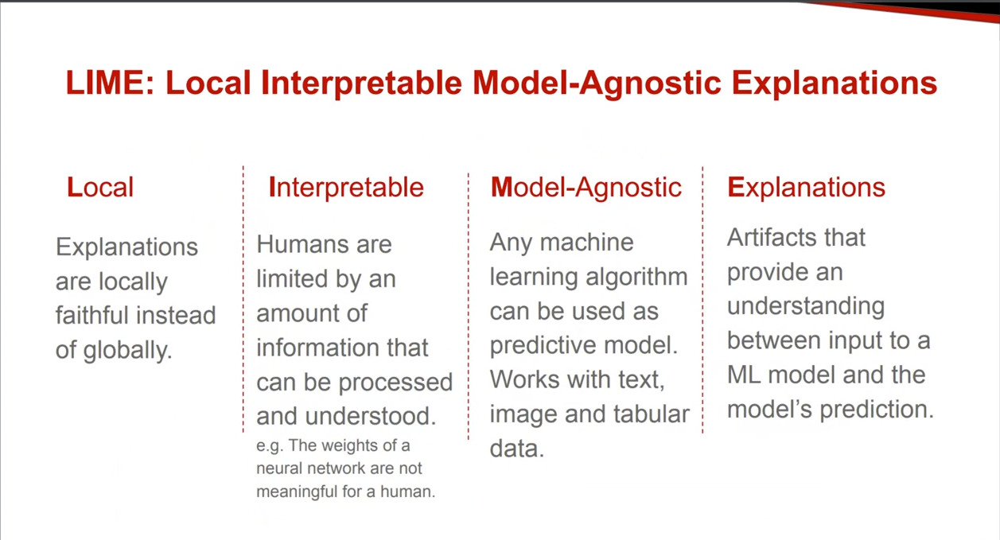

**Local Prediction Plot**

The "Local Prediction Plot" displays the model's predicted probabilities for the "Canceled" and "Not Canceled" classes for a specific data instance. The user can choose the data instance by selecting the index using the input field. The bars are color-coded with red for the "Canceled" class and blue for the "Not Canceled" class. Hovering over the bars shows the class name and its corresponding probability. The plot also includes an annotation that indicates the correct class for the chosen data instance.

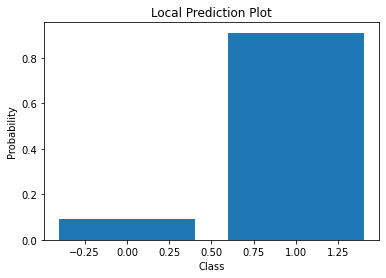

In [44]:
import numpy as np
import matplotlib.pyplot as plt
from lime import lime_tabular

# Convert Pandas DataFrame to numpy arrays
X_train_array = X_train.values
X_test_array = X_test.values

# Get the feature names from the DataFrame columns
feature_names = X_train.columns

# Generate local explanations using LIME
explainer = lime_tabular.LimeTabularExplainer(X_train_array, feature_names=feature_names, class_names=[0, 1], discretize_continuous=True)

data_point_of_interest = X_test_array[10]
explanation = explainer.explain_instance(data_point_of_interest, final_model.predict_proba, num_features=len(feature_names))

# Create the Local Prediction Plot
probs = explanation.predict_proba
classes = [0,1]
plt.bar(classes, probs)
plt.xlabel("Class")
plt.ylabel("Probability")
plt.title("Local Prediction Plot")
plt.show()


In [53]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objs as go
import numpy as np
import matplotlib.pyplot as plt
from lime import lime_tabular

# Convert Pandas DataFrame to numpy arrays
X_train_array = X_train.values
X_test_array = X_test.values

# Get the feature names from the DataFrame columns
feature_names = X_train.columns

# Generate local explanations using LIME
explainer = lime_tabular.LimeTabularExplainer(X_train_array, feature_names=feature_names, class_names=['canceled', 'not canceled'], discretize_continuous=True)

# Create the Dash app
app = dash.Dash(__name__)

# Define the layout of the app with dark background color
app.layout = html.Div(style={'backgroundColor': '#222222', 'color': 'white', 'padding': '20px'}, children=[
    # Input field to allow the user to choose the data instance by selecting the index
    dcc.Input(id='data-index', type='number', value=0, min=0, max=len(X_test)-1, step=1, style={'margin-bottom': '20px'}),
    
    # Graph to display the local prediction plot
    dcc.Graph(id='local-prediction-plot')
])

# Function to generate the LIME explanation and plot
def generate_local_prediction_plot(data_index):
    # Generate local explanations using LIME
    data_point_of_interest = X_test_array[data_index]
    explanation = explainer.explain_instance(data_point_of_interest, final_model.predict_proba, num_features=len(feature_names))

    # Get the predicted class and probabilities
    probs = explanation.predict_proba
    classes = ['canceled', 'not canceled']
    class_names = ['Canceled', 'Not Canceled']
    correct_choice = class_names[np.argmax(probs)]
    
    # Create the Local Prediction Plot using plotly
    fig = go.Figure()
    fig.add_trace(go.Bar(x=class_names, y=probs, marker_color=['red', 'blue'], hoverinfo='text',
                         text=[f"Class: {class_names[i]}<br>Probability: {probs[i]:.4f}" for i in range(len(probs))],
                         name='Local Prediction'))

    fig.update_layout(title='Local Prediction Plot', xaxis_title='Class', yaxis_title='Probability',
                      legend=dict(x=0, y=1.1), plot_bgcolor='#222222', paper_bgcolor='#222222', font_color='white',
                      annotations=[dict(text=f"Correct Choice: {correct_choice}", x=0.5, y=-0.15, showarrow=False)])
    
    return fig

# Callback to update the plot based on the selected data index
@app.callback(
    Output('local-prediction-plot', 'figure'),
    [Input('data-index', 'value')]
)
def update_local_prediction_plot(data_index):
    return generate_local_prediction_plot(data_index)

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True, port=8054)

#### **10. Model Interpretation Dashboard:**


This dashboard provides insights into the predictions made by the `final_model` on the test dataset. The goal is to understand the local predictions for a specific data instance, examine the model's overall prediction accuracy, and identify the counts of incorrect predictions for each class.

##### **Local Prediction Plot**
The "Local Prediction Plot" displays the model's predicted probabilities for the "Canceled" and "Not Canceled" classes for a specific data instance. The user can choose the data instance by selecting the index using the input field. The bars are color-coded with red for the "Canceled" class and blue for the "Not Canceled" class. Hovering over the bars shows the class name and its corresponding probability. The plot also includes an annotation that indicates the correct class for the chosen data instance.

##### **Model Prediction Counts**
The "Model Prediction Counts" plot provides an overview of the model's prediction accuracy on the entire test dataset. It shows the counts of correct and incorrect predictions made by the `final_model`. The bars are color-coded with green for correct predictions and red for incorrect predictions. The hover text displays the respective counts for each bar.

##### **Incorrect Predictions Counts**
The "Incorrect Predictions Counts" plot shows the number of incorrect predictions for each class in the test dataset. The bars are color-coded in red, and the hover text indicates the class name and the count of incorrect predictions.

Using this dashboard, users can gain insights into the local predictions of the model, examine its overall accuracy, and identify areas where the model may be making incorrect predictions. This information can be valuable in interpreting and improving the performance of the machine learning model.

In [54]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objs as go
import numpy as np
import matplotlib.pyplot as plt
from lime import lime_tabular

# Convert Pandas DataFrame to numpy arrays
X_train_array = X_train.values
X_test_array = X_test.values

# Get the feature names from the DataFrame columns
feature_names = X_train.columns

# Generate local explanations using LIME
explainer = lime_tabular.LimeTabularExplainer(X_train_array, feature_names=feature_names, class_names=['canceled', 'not canceled'], discretize_continuous=True)

# Create the Dash app
app = dash.Dash(__name__)

# Define the layout of the app with dark background color
app.layout = html.Div(style={'backgroundColor': '#222222', 'color': 'white', 'padding': '20px'}, children=[
    # Input field to allow the user to choose the data instance by selecting the index
    dcc.Input(id='data-index', type='number', value=0, min=0, max=len(X_test)-1, step=1, style={'margin-bottom': '20px'}),
    
    # Graph to display the local prediction plot
    dcc.Graph(id='local-prediction-plot'),
    
    # Graph to display the model's correct and incorrect predictions
    dcc.Graph(id='prediction-counts-plot')
])

# Function to generate the LIME explanation and plot
def generate_local_prediction_plot(data_index):
    # Generate local explanations using LIME
    data_point_of_interest = X_test_array[data_index]
    explanation = explainer.explain_instance(data_point_of_interest, final_model.predict_proba, num_features=len(feature_names))

    # Get the predicted class and probabilities
    probs = explanation.predict_proba
    classes = ['canceled', 'not canceled']
    class_names = ['Canceled', 'Not Canceled']
    correct_choice = class_names[np.argmax(probs)]
    
    # Create the Local Prediction Plot using plotly
    fig = go.Figure()
    fig.add_trace(go.Bar(x=class_names, y=probs, marker_color=['red', 'blue'], hoverinfo='text',
                         text=[f"Class: {class_names[i]}<br>Probability: {probs[i]:.4f}" for i in range(len(probs))],
                         name='Local Prediction'))

    fig.update_layout(title='Local Prediction Plot', xaxis_title='Class', yaxis_title='Probability',
                      legend=dict(x=0, y=1.1), plot_bgcolor='#222222', paper_bgcolor='#222222', font_color='white',
                      annotations=[dict(text=f"Correct Choice: {correct_choice}", x=0.5, y=-0.15, showarrow=False)])
    
    return fig

# Callback to update the plot based on the selected data index
@app.callback(
    Output('local-prediction-plot', 'figure'),
    [Input('data-index', 'value')]
)
def update_local_prediction_plot(data_index):
    return generate_local_prediction_plot(data_index)

# Function to generate the model's correct and incorrect predictions count
def generate_prediction_counts_plot():
    # Make predictions on the entire test set
    predictions = final_model.predict(X_test)
    correct_counts = np.sum(predictions == y_test)
    incorrect_counts = np.sum(predictions != y_test)
    
    # Create the Prediction Counts Plot using plotly
    fig = go.Figure()
    fig.add_trace(go.Bar(x=['Correct Predictions', 'Incorrect Predictions'], y=[correct_counts, incorrect_counts],
                         marker_color=['green', 'red'], hoverinfo='text',
                         text=[f"Counts: {correct_counts}", f"Counts: {incorrect_counts}"],
                         name='Prediction Counts'))
    
    fig.update_layout(title='Model Prediction Counts', xaxis_title='Prediction', yaxis_title='Counts',
                      plot_bgcolor='#222222', paper_bgcolor='#222222', font_color='white')
    
    return fig

# Callback to update the prediction counts plot
@app.callback(
    Output('prediction-counts-plot', 'figure'),
    [Input('data-index', 'value')]
)
def update_prediction_counts_plot(data_index):
    return generate_prediction_counts_plot()

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True, port=8055)


In [55]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objs as go
import numpy as np
import matplotlib.pyplot as plt
from lime import lime_tabular

# Convert Pandas DataFrame to numpy arrays
X_train_array = X_train.values
X_test_array = X_test.values

# Get the feature names from the DataFrame columns
feature_names = X_train.columns

# Generate local explanations using LIME
explainer = lime_tabular.LimeTabularExplainer(X_train_array, feature_names=feature_names, class_names=['canceled', 'not canceled'], discretize_continuous=True)

# Create the Dash app
app = dash.Dash(__name__)

# Define the layout of the app with dark background color
app.layout = html.Div(style={'backgroundColor': '#222222', 'color': 'white', 'padding': '20px'}, children=[
    # Input field to allow the user to choose the data instance by selecting the index
    dcc.Input(id='data-index', type='number', value=0, min=0, max=len(X_test)-1, step=1, style={'margin-bottom': '20px'}),
    
    # Graph to display the local prediction plot
    dcc.Graph(id='local-prediction-plot'),
    
    # Graph to display the model's correct and incorrect predictions
    dcc.Graph(id='prediction-counts-plot'),
    
    # Graph to display counts of incorrect predictions in each class
    dcc.Graph(id='incorrect-predictions-plot')
])

# Function to generate the LIME explanation and plot
def generate_local_prediction_plot(data_index):
    # Generate local explanations using LIME
    data_point_of_interest = X_test_array[data_index]
    explanation = explainer.explain_instance(data_point_of_interest, final_model.predict_proba, num_features=len(feature_names))

    # Get the predicted class and probabilities
    probs = explanation.predict_proba
    classes = ['canceled', 'not canceled']
    class_names = ['Canceled', 'Not Canceled']
    correct_choice = class_names[np.argmax(probs)]
    
    # Create the Local Prediction Plot using plotly
    fig = go.Figure()
    fig.add_trace(go.Bar(x=class_names, y=probs, marker_color=['red', 'blue'], hoverinfo='text',
                         text=[f"Class: {class_names[i]}<br>Probability: {probs[i]:.4f}" for i in range(len(probs))],
                         name='Local Prediction'))

    fig.update_layout(title='Local Prediction Plot', xaxis_title='Class', yaxis_title='Probability',
                      legend=dict(x=0, y=1.1), plot_bgcolor='#222222', paper_bgcolor='#222222', font_color='white',
                      annotations=[dict(text=f"Correct Choice: {correct_choice}", x=0.5, y=-0.15, showarrow=False)])
    
    return fig

# Callback to update the plot based on the selected data index
@app.callback(
    Output('local-prediction-plot', 'figure'),
    [Input('data-index', 'value')]
)
def update_local_prediction_plot(data_index):
    return generate_local_prediction_plot(data_index)

# Function to generate the model's correct and incorrect predictions count
def generate_prediction_counts_plot():
    # Make predictions on the entire test set
    predictions = final_model.predict(X_test)
    correct_counts = np.sum(predictions == y_test)
    incorrect_counts = np.sum(predictions != y_test)
    
    # Create the Prediction Counts Plot using plotly
    fig = go.Figure()
    fig.add_trace(go.Bar(x=['Correct Predictions', 'Incorrect Predictions'], y=[correct_counts, incorrect_counts],
                         marker_color=['green', 'red'], hoverinfo='text',
                         text=[f"Counts: {correct_counts}", f"Counts: {incorrect_counts}"],
                         name='Prediction Counts'))
    
    fig.update_layout(title='Model Prediction Counts', xaxis_title='Prediction', yaxis_title='Counts',
                      plot_bgcolor='#222222', paper_bgcolor='#222222', font_color='white')
    
    return fig

# Callback to update the prediction counts plot
@app.callback(
    Output('prediction-counts-plot', 'figure'),
    [Input('data-index', 'value')]
)
def update_prediction_counts_plot(data_index):
    return generate_prediction_counts_plot()

# Function to generate counts of incorrect predictions in each class
def generate_incorrect_predictions_plot():
    # Make predictions on the entire test set
    predictions = final_model.predict(X_test)
    
    # Count the number of incorrect predictions in each class
    class_names = ['Canceled', 'Not Canceled']
    incorrect_counts = [np.sum((predictions != y_test) & (y_test == i)) for i in range(len(class_names))]
    
    # Create the Incorrect Predictions Plot using plotly
    fig = go.Figure()
    fig.add_trace(go.Bar(x=class_names, y=incorrect_counts, marker_color='red', hoverinfo='text',
                         text=[f"Class: {class_names[i]}<br>Counts: {incorrect_counts[i]}" for i in range(len(incorrect_counts))],
                         name='Incorrect Predictions'))

    fig.update_layout(title='Incorrect Predictions Counts', xaxis_title='Class', yaxis_title='Counts',
                      plot_bgcolor='#222222', paper_bgcolor='#222222', font_color='white')
    
    return fig

# Callback to update the incorrect predictions plot
@app.callback(
    Output('incorrect-predictions-plot', 'figure'),
    [Input('data-index', 'value')]
)
def update_incorrect_predictions_plot(data_index):
    return generate_incorrect_predictions_plot()

# Run the Dash app
if __name__ == '__main__':
    app.run_server(debug=True, port=8056)

#### **11. Local Surrogate Model:**


- LIME builds a local surrogate model that approximates the behavior of the original model around a specific data point. Visualizing this surrogate model can provide insights into how the model makes decisions for that instance.

Here are steps to help users understand and interpret the Local Surrogate Model plot:

1. **Local Surrogate Model Plot**: This plot provides insights into how the model behaves around a specific data point.

2. **Color Coding**: The plot uses different colors to represent the coefficients of each feature. The colors are as follows:
   - Red: Negative coefficients
   - Blue: Positive coefficients

3. **Data Instance Selection**: Use the dropdown menu provided in the web application to select a data instance from the test dataset.

4. **Interpreting Coefficients**: The height of each bar in the plot represents the magnitude of the coefficient for each feature. Features with taller bars have a stronger influence on the model's decision for the selected data instance.

5. **Negative and Positive Impact**: Features with red bars (negative coefficients) have a negative impact on the model's prediction for the chosen instance. Conversely, features with blue bars (positive coefficients) have a positive impact on the prediction.

6. **Magnitude of Coefficients**: The higher the bar's height, the more significant the feature's impact on the model's decision.

7. **Understanding Prediction**: Based on the color and height of the bars, you can infer which features are contributing positively or negatively to the model's prediction for the selected data instance.

8. **Local Behavior**: Remember that this is a local explanation specific to the chosen data instance. The model's global behavior may differ from the local insights provided by this plot.

9. **Repeating the Analysis**: You can try selecting different data instances from the dropdown to explore how the model behaves for different inputs.

10. **Model Interpretability**: The Local Surrogate Model plot is an interpretable way to understand the model's decision-making process, especially for individual data instances.

These steps should guide users in understanding and interpreting the Local Surrogate Model plot and help them gain insights into how the model is making predictions for specific data points. It's essential to consider the local nature of the explanation and not generalize the insights to the entire dataset without further analysis.

In [ ]:
import numpy as np
import plotly.graph_objs as go
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
from lime import lime_tabular

# Convert Pandas DataFrame to numpy arrays
X_train_array = X_train.values
X_test_array = X_test.values

# Get the feature names from the DataFrame columns
feature_names = X_train.columns

# Generate local explanations using LIME
explainer = lime_tabular.LimeTabularExplainer(X_train_array, feature_names=feature_names, class_names=[0, 1], discretize_continuous=True)

# Create Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    dcc.Dropdown(
        id='data-point-selector',
        options=[{'label': f'Data Point {i}', 'value': i} for i in range(len(X_test_array))],
        value=0,
        style={'width': '50%'}
    ),
    dcc.Graph(id='local-surrogate-model-plot'),
])

# Callback to update the plot when the user selects a different data point
@app.callback(
    Output('local-surrogate-model-plot', 'figure'),
    [Input('data-point-selector', 'value')]
)
def update_local_surrogate_model_plot(selected_data_point):
    # Get the data point of interest from the test dataset
    data_point_of_interest = X_test_array[selected_data_point]

    # Explain the selected data instance using LIME
    explanation = explainer.explain_instance(data_point_of_interest, final_model.predict_proba, num_features=len(feature_names))

    # Get the coefficients of the local surrogate model
    surrogate_coefs = explanation.as_map()[1]
    surrogate_features = [feature_names[idx] for idx, _ in surrogate_coefs]
    surrogate_coefs = [coef for _, coef in surrogate_coefs]

    # Create the Local Surrogate Model Plot using Plotly
    fig = go.Figure()
    fig.add_trace(go.Bar(
        x=surrogate_coefs,
        y=surrogate_features,
        orientation='h',
        marker=dict(color=['red' if coef < 0 else 'blue' for coef in surrogate_coefs]),
    ))
    fig.update_layout(
        title='Local Surrogate Model',
        xaxis_title='Coefficient',
        yaxis_title='Feature',
        margin=dict(l=80, r=20, t=40, b=20),
    )
    return fig

if __name__ == '__main__':
    app.run_server(debug=True, port=8057)


#### **12. Local Data Distribution:**


- LIME generates synthetic data points around the instance of interest. Plotting these data points along with their predicted probabilities can help understand how the model behaves in the local neighborhood of the data point.

In [74]:
import numpy as np
import plotly.graph_objects as go
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
from lime import lime_tabular

# Convert Pandas DataFrame to numpy arrays
X_train_array = X_train.values
X_test_array = X_test.values

# Get the feature names from the DataFrame columns and convert them to strings
feature_names = [str(name) for name in X_train.columns]

# Generate local explanations using LIME
explainer = lime_tabular.LimeTabularExplainer(X_train_array, feature_names=feature_names, class_names=[0, 1], discretize_continuous=True)

# Function to generate synthetic data and predictions
def generate_local_data(data_idx):
    data_point_of_interest = X_test_array[data_idx]
    explanation = explainer.explain_instance(data_point_of_interest, final_model.predict_proba, num_features=len(feature_names))
    
    # Generate synthetic data points
    synthetic_data = np.random.uniform(low=-1, high=1, size=(100, len(feature_names)))
    for i, (feature, value) in enumerate(explanation.as_list()):
        feature_name = feature.split()[0]
        if feature_name in feature_names:  # Check if the feature is in the dataset
            feature_index = feature_names.index(feature_name)
            synthetic_data[:, feature_index] = value

    # Predict probabilities for synthetic data
    predicted_probs = final_model.predict_proba(synthetic_data)[:, 1]
    
    return synthetic_data, predicted_probs

# Create Dash app
app = dash.Dash(__name__)

# App layout
app.layout = html.Div([
    # Dropdown to select data instance
    dcc.Dropdown(
        id='data-instance-dropdown',
        options=[{'label': f'Data Instance {i}', 'value': i} for i in range(len(X_test_array))],
        value=0,
        style={'width': '50%'}
    ),
    # Local Data Distribution plot
    dcc.Graph(id='local-data-distribution-plot'),
])

# Callback to update the Local Data Distribution plot
@app.callback(
    Output('local-data-distribution-plot', 'figure'),
    Input('data-instance-dropdown', 'value')
)
def update_local_data_distribution_plot(data_idx):
    synthetic_data, predicted_probs = generate_local_data(data_idx)
    
    # Create figure
    fig = go.Figure()
    for i, feature_name in enumerate(feature_names):
        fig.add_trace(go.Scatter(x=synthetic_data[:, i], y=predicted_probs, mode='markers', name=feature_name))
    
    fig.update_layout(
        title=f'Local Data Distribution for Data Instance {data_idx}',
        xaxis_title='Feature Value',
        yaxis_title='Predicted Probability',
        template='plotly_dark'
    )
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port=8058)


## 
<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       IX. Model Deployment:
    </h2>

Model deployment refers to the process of taking a trained machine learning model and making it available for use in a real-world environment to make predictions on new data. The steps involved in model deployment typically include:

1. **Model Training:** Train the machine learning model on historical data to learn patterns and relationships between input features and target outputs.

2. **Model Evaluation:** Evaluate the trained model's performance using validation and test datasets to ensure it generalizes well to unseen data.

3. **Model Selection:** Select the best-performing model based on evaluation metrics and business requirements.

4. **Data Preprocessing:** Prepare new data for the deployed model by applying the same preprocessing steps used during training, such as feature scaling, one-hot encoding, or handling missing values.

5. **Model Serialization:** Serialize the trained model into a format that can be easily stored and loaded, such as a binary file or a serialized object.

6. **Model Serving Infrastructure:** Set up the infrastructure to serve the model, which can involve deploying it to a cloud service, containerizing it, or hosting it on a web server.

7. **API Development:** Create an API (Application Programming Interface) that allows external systems to interact with the deployed model. This API handles incoming requests, preprocesses the data, and passes it to the model for prediction.

8. **Load Model:** Load the serialized model into memory when the server starts up, so it is readily available to handle incoming requests.

9. **Request Handling:** Configure the API to handle incoming requests and process the data for inference. This includes validating input, converting data into the appropriate format, and passing it to the model.

10. **Model Prediction:** Use the loaded model to make predictions on the new data provided through the API.

11. **Result Delivery:** Return the model's predictions to the requesting client, which could be a web application, mobile app, or another system.

12. **Monitoring and Logging:** Implement monitoring and logging mechanisms to track the performance and usage of the deployed model. This helps identify potential issues and track model performance over time.

13. **Security Considerations:** Implement security measures to protect the model and data, such as authentication, authorization, and encryption.

14. **Scalability:** Ensure that the deployment setup can handle increased traffic and is scalable to meet demand.

15. **Continuous Monitoring and Updates:** Continuously monitor the model's performance in the production environment and update it as needed to maintain accuracy and relevance.

Model deployment is a critical step in the machine learning lifecycle and requires careful planning, testing, and optimization to ensure that the model performs well and provides value in real-world applications.

**Note 1 🌟: So far, we have completed the initial five steps of the model deployment process.**


**Note 2 😄: The subsequent steps from six to fifteen are relatively straightforward and can be easily executed.**

## 

<h2 id="import" style="color: #00c6ff ; background:#000000  ; padding: 20px; border-radius: 20px; text-align: center; border: 5px solid #990000;">
       X. Communication and Reporting:
    </h2>

- Clearly communicate the findings, insights, and model performance to stakeholders.
- Provide detailed reports on the model's performance and any observed patterns related to cancellations.

### Conclusion:

In this project, we set out to predict hotel reservation cancellations using advanced machine learning techniques. The primary objective was to develop a model that could help hotel managers make informed decisions to optimize revenue management and enhance overall customer satisfaction.

The project involved several key steps, starting with data collection and preprocessing. We carefully curated the dataset, handled missing values, and performed necessary transformations to ensure the data was ready for analysis. Exploratory Data Analysis (EDA) provided valuable insights into the dataset's characteristics, distribution, and patterns, helping us gain a deeper understanding of the variables and their relationships.

Feature preprocessing and engineering played a crucial role in selecting relevant features to improve model performance. We used techniques such as label encoding, and feature scaling to ensure a well-prepared dataset.

Model training and evaluation were critical stages where we experimented with various classification algorithms. We trained multiple models, including Random Forest, Gradient Boosting, AdaBoost, SVM, Balanced Random Forest, EasyEnsemble, BalancedBaggingClassifier, and KNN, evaluating each model's performance using metrics like accuracy, precision, recall, and F1-score.

To optimize the Random Forest model, we leveraged Optuna to search for the best hyperparameters efficiently. Furthermore, we explored Neural Architecture Search (NAS) and Bayesian Optimization to automatically discover optimal model architectures and fine-tune hyperparameters for the binary classification task.

Interpreting the models' decisions is essential in real-world applications. To address model interpretability, we applied explainable AI (XAI) techniques to understand how our models arrived at their predictions and communicated the results effectively.

Throughout the project, we demonstrated a comprehensive understanding of data analysis, machine learning, and interpretability techniques. These skills are essential in building reliable, accurate, and interpretable models for solving real-world problems.

In conclusion, our predictive models provide valuable insights into hotel reservation cancellations, enabling hotel managers to make data-driven decisions. By optimizing room bookings, resource allocation, and pricing strategies, hotels can enhance revenue management and customer satisfaction. The combination of advanced machine learning techniques and interpretability empowers businesses to understand and trust the models, making them valuable assets in the hospitality industry.

---

<!-- Contact Me -->

## 📞 Contact Me

Feel free to reach out to me through the following platforms:

[![GitHub](https://img.shields.io/badge/GitHub-%23181717.svg?logo=github&logoColor=white)](https://github.com/YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![LinkedIn](https://img.shields.io/badge/LinkedIn-%230077B5.svg?logo=linkedin&logoColor=white)](https://www.linkedin.com/in/YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![Kaggle](https://img.shields.io/badge/Kaggle-%2320BEFF.svg?logo=kaggle&logoColor=white)](https://www.kaggle.com/YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![Medium](https://img.shields.io/badge/Medium-%2312100E.svg?logo=medium&logoColor=white)](https://medium.com/@YourUsername) &nbsp;&nbsp;&nbsp;&nbsp;
[![Website](https://img.shields.io/badge/Website-%23117AC9.svg?logo=google-chrome&logoColor=white)](https://www.yourwebsite.com)

Connect with me on these platforms to stay updated with my latest projects and articles. I look forward to connecting with you!

<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>